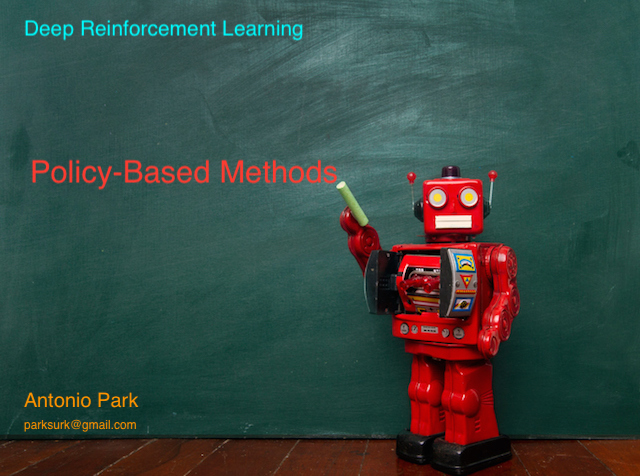

In [1]:
from IPython.display import Image
Image(filename='./images/3-0-0-0_opening.jpg')

# Learning Plan

### Lesson 3-1: Introduction to Policy-Based Methods
In this lesson, you will learn about methods such as hill climbing, simulated annealing, and adaptive noise scaling. You'll also learn about cross-entropy methods and evolution strategies.

### Lesson 3-2: : Policy Gradient Methods
In this lesson, you'll study REINFORCE, along with improvements we can make to lower the variance of policy gradient algorithms.

### Lesson 3-3: : Proximal Policy Optimization
In this lesson, you'll learn about Proximal Policy Optimization (PPO), a cutting-edge policy gradient method.

### Lesson 3-4: : Actor-Critic Methods
In this lesson, you'll learn how to combine value-based and policy-based methods, bringing together the best of both worlds, to solve challenging reinforcement learning problems.

### Lesson 3-5: : Deep RL for Finance (Optional)
In this optional lesson, you'll learn how to apply deep reinforcement learning techniques for optimal execution of portfolio transactions.

## Optional Resorces

* Read the most famous [blog post] {http://karpathy.github.io/2016/05/31/rl/} on policy gradient methods.
* Implement a policy gradient method to win at Pong in this [Medium post] {https://medium.com/@dhruvp/how-to-write-a-neural-network-to-play-pong-from-scratch-956b57d4f6e0}.
* Learn more about [evolution strategies] {https://blog.openai.com/evolution-strategies/} from OpenAI.

# Lesson 3-1: Introduction to Policy-Based Methods

## 3-1-1 : Policy-Based Methods

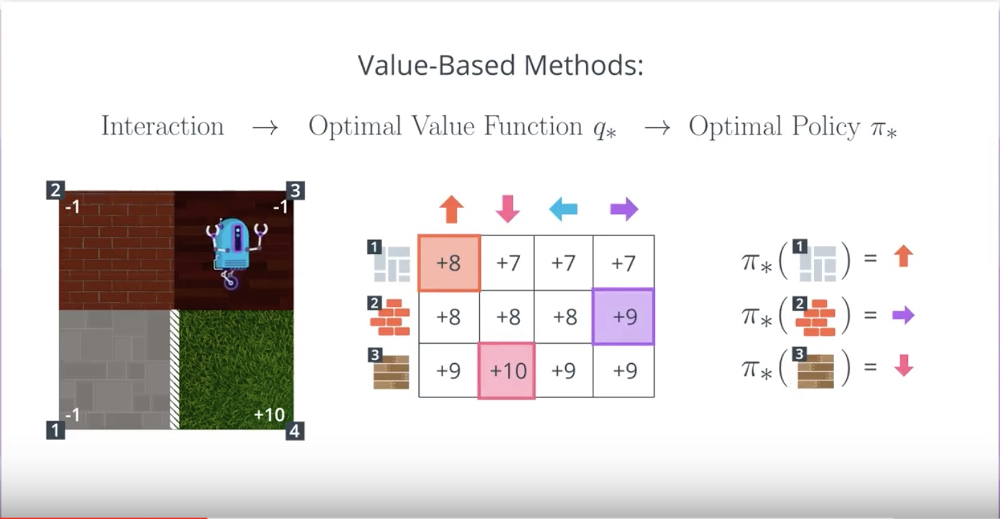

In [2]:
from IPython.display import Image
Image(filename='./images/3-1-1-1_value_based_methods_with_discrete_state.jpeg')

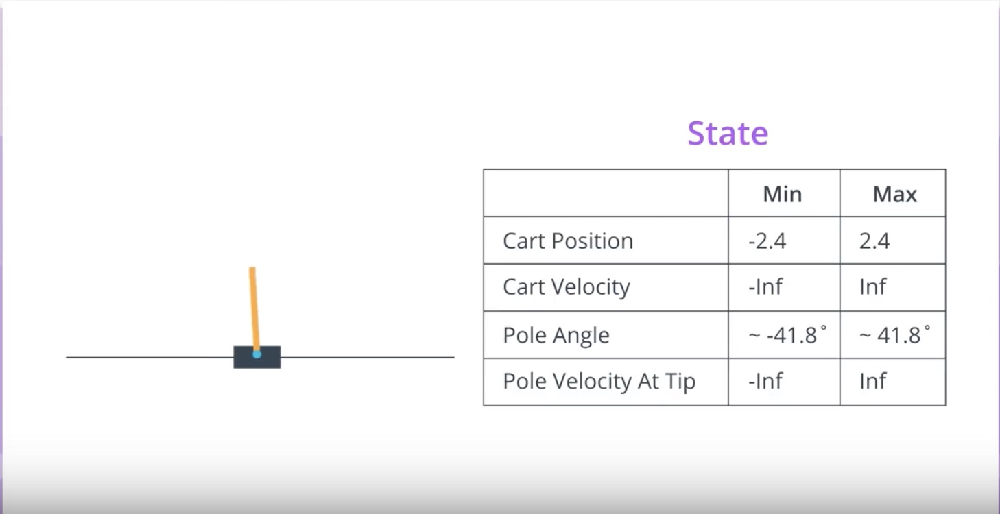

In [3]:
from IPython.display import Image
Image(filename='./images/3-1-1-2_value_based_methods_with_continuous_state.jpeg')

### It's impossible to represnet the optimal action value fruction in a table.
### Because we need to a row from the table and that would make the table too big to be useful in practice.

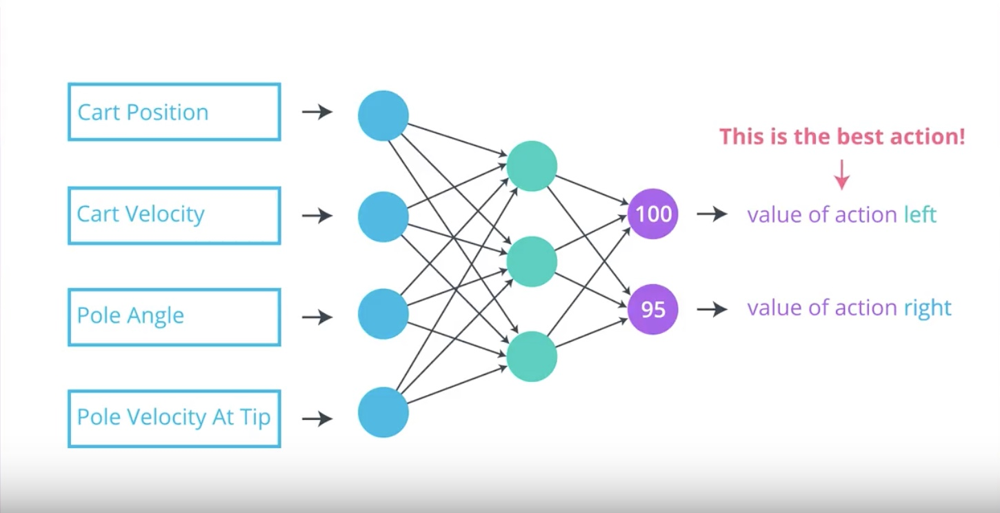

In [4]:
from IPython.display import Image
Image(filename='./images/3-1-1-3_value_based_methods_with_continuous_state_using_Deep_Q_Learning.jpeg')

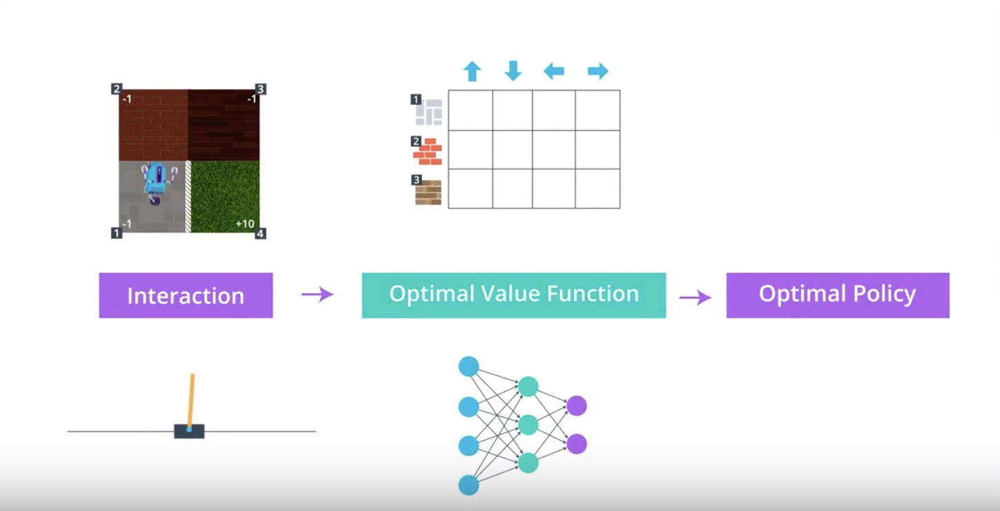

In [5]:
from IPython.display import Image
Image(filename='./images/3-1-1-4_value_based_methods_estimate_optimal_value_function_first_before_optimal_policy.jpeg')

### Important message is that...
### in both cases, whether we used a table for small state spaces or a neural network for much larger state spaces,
## We had to first estimate the 'Optimal Action Value Fuction' 
## before we could make the 'Optimal Policy'

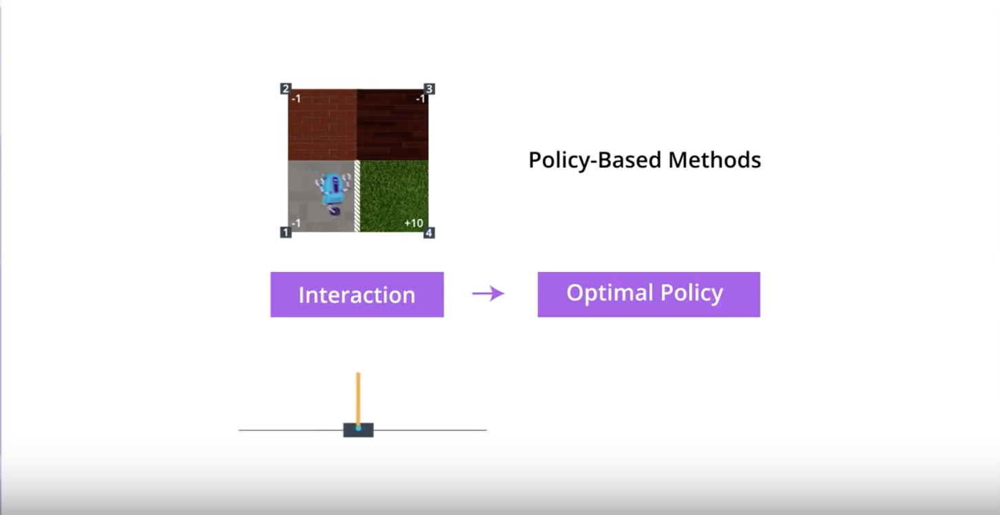

In [6]:
from IPython.display import Image
Image(filename='./images/3-1-1-5_policy_based_methods.jpeg')

### Key concept about 'Policy-based Methods' is...
## We can directly find the 'Optimal Policy' without worrying about a value fuction at all.

## 3-1-2 : Policy Function Approximation

### How might we use a neural network to approximate a policy?

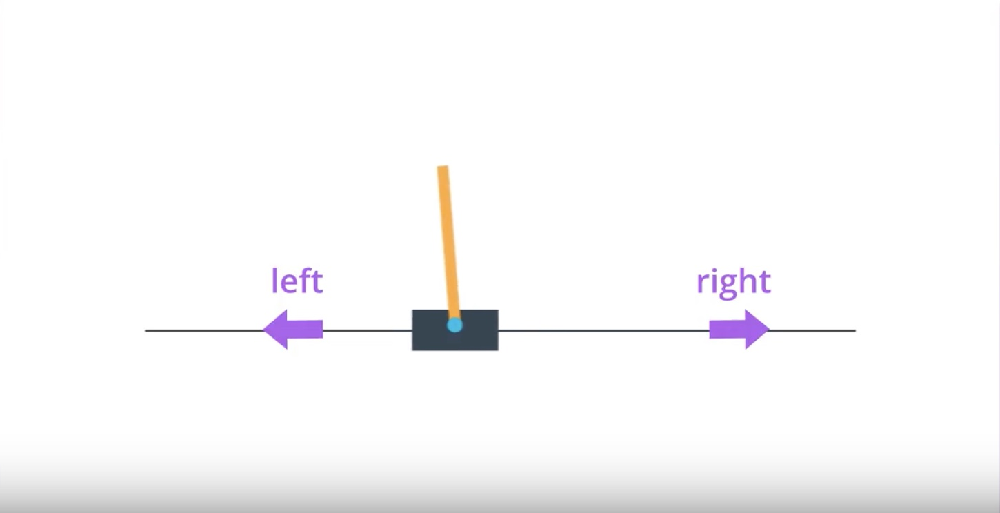

In [7]:
from IPython.display import Image
Image(filename='./images/3-1-2-1_policy_function_approximation_cartpole_has_two_actions.jpeg')

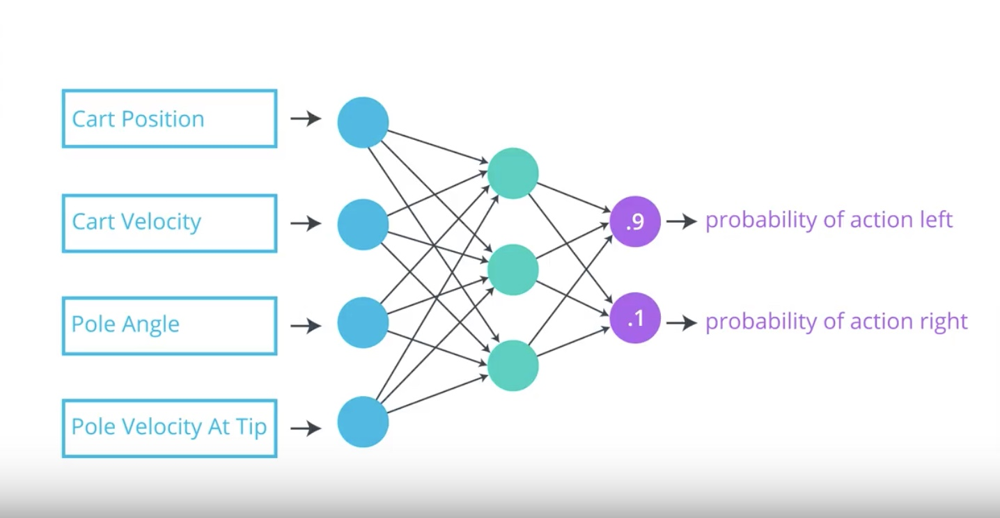

In [8]:
from IPython.display import Image
Image(filename='./images/3-1-2-2_policy_function_approximation_neural_newtwork_return_posibilities.jpeg')

### Our objective is to determine appropriate values for the network weights so that for each state that we pass into the network.
## Neural Network returns action probabilities where the optimal action is most likely to be selected.
### This will help the agent with its goal to maximize expected return.

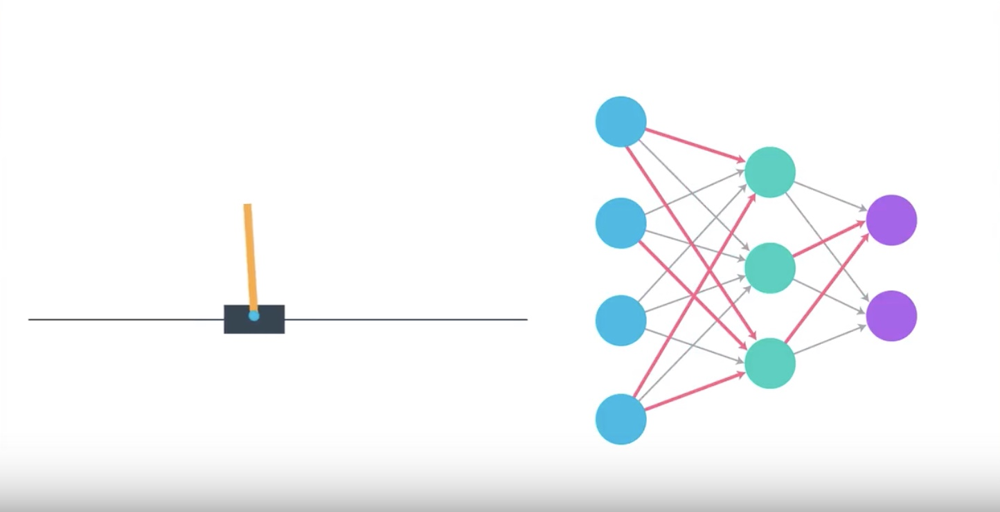

In [9]:
from IPython.display import Image
Image(filename='./images/3-1-2-3_policy_function_approximation_agent_learns_how_to_maximize_reword_interactively.jpeg')

### 1. Weights are initially set to random values.
### 2. The agent interacts with the environment
### 3. The agnet learns more about what strategies are best for maximizing reward.
## This process amends those wheights and the agent starts to choose the appropriate action for each state and gradually masters the Cartpole task.

## 3-1-3 : More on the Policy

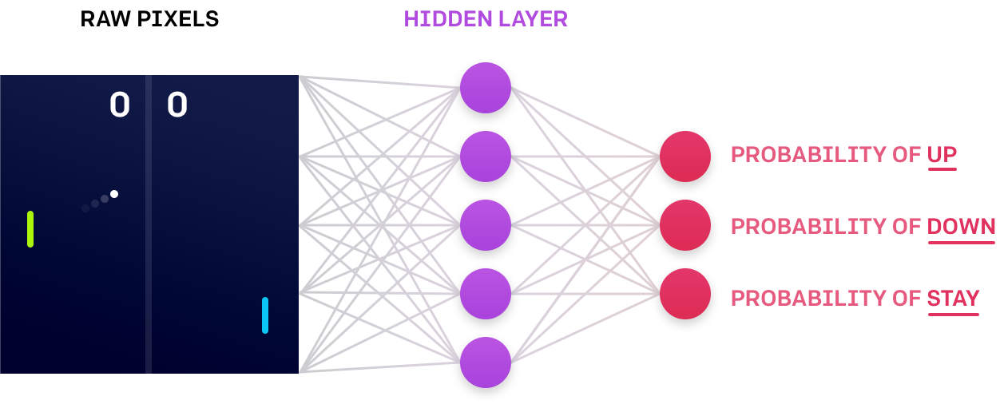

In [10]:
from IPython.display import Image
Image(filename='./images/3-1-3-1_neural_network_encodes_action_probabilities.png')

[ref] {https://blog.openai.com/evolution-strategies/}

### Neural Network approximates [Stochastic Policy]
- Above image, a simple neural network architecture to approximate a stochastic policy.
    1. The agent passes the current environment state as input to the network.
    2. The neural network returns 'action probabilities'.
    3. The agent samples from those probabilities to select an action.

### Neural Network approximates [Deterministic Policy]
- Instead of sampling from the action probabilites, the agent need only choose the greedy action.

## Quiz
### Question : you learned that the neural network that approximates the policy takes the environment state as input. The output layer returns the probability that the agent should select each possible action. Which of the following is a valid activation function for the output layer?

1. linear (i.e., no activation function)
2. softmax
3. ReLu

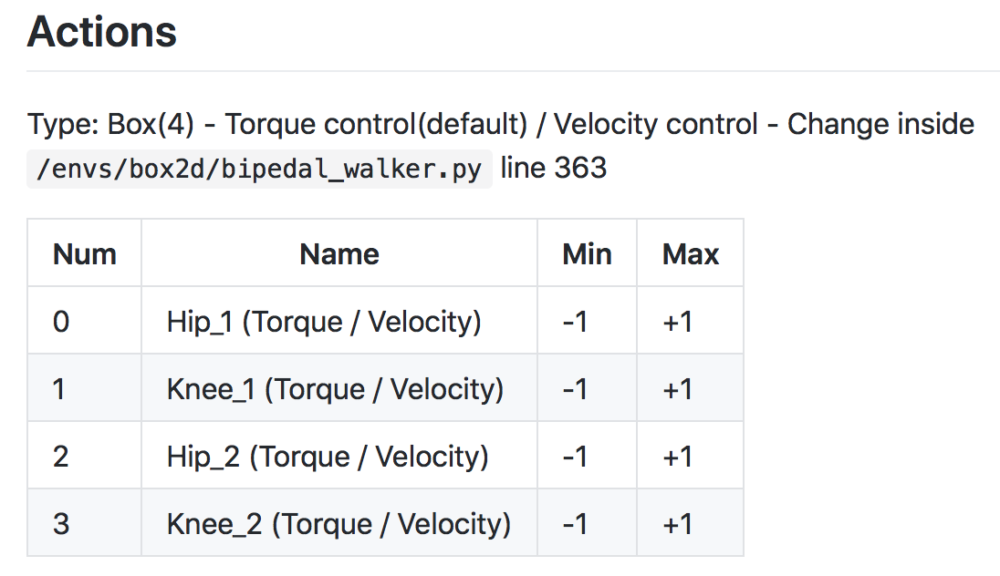

In [11]:
from IPython.display import Image
Image(filename='./images/3-1-3-2_continuous_action_space_in_bipedal_walker.png')

### Question is...
### CartPole environment has a discrete action space. So, how do we use a neural network to approximate a policy, if the environment has a continuous action space?

## * Discrete Action spaces : the neural network has one node for each possible action.
## * Continuous Action spaces : the neural network has one node for each action entry (or index).

### In the [BipedalWalker] {https://github.com/openai/gym/wiki/BipedalWalker-v2}  case
## Any action is a vector of four numbers, so the output layer of the policy network will have four nodes.

#### Since every entry in the action must be a number between -1 and 1, we will add a [tanh activation function] {https://pytorch.org/docs/stable/nn.html#torch.nn.Tanh} to the output layer

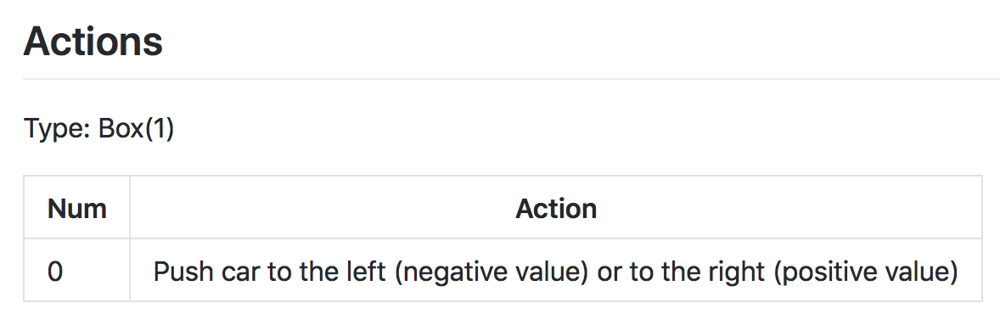

In [12]:
from IPython.display import Image
Image(filename='./images/3-1-3-3_continuous_action_space_in_mountain_car_continuous.png')

### In the [MountainCarContinuous] {https://github.com/openai/gym/wiki/MountainCarContinuous-v0}  case
## The action space is shown in the figure above. Note that for this environment, the action must be a value between -1 and 1

## Quiz
### Consider the MountainCarContinuous-v0 environment. Which of the following describes a valid output layer for the policy? (Select the option that yields valid actions that can be passed directly to the environment without any additional preprocessing.)

1. Layer size:1, Activation fuction: softmax
2. Layer size:1, Activation fuction: tanh
3. Layer size:2, Activation fuction: softmax
4. Layer size:2, Activation fuction: ReLu

## 3-1-4 : Hill Climbing Algorithm

[hill climbing] {https://en.wikipedia.org/wiki/Hill_climbing} is not just for reinforcement learning! It is a general optimization method that is used to find the maximum of a function.

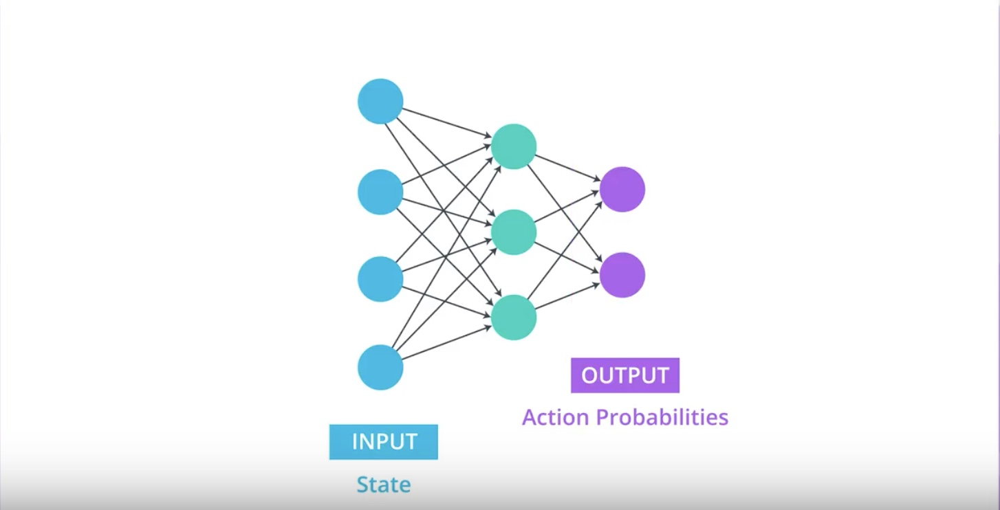

In [13]:
from IPython.display import Image
Image(filename='./images/3-1-4-1_hill_climbiing_neural_network_input_and_output.jpeg')

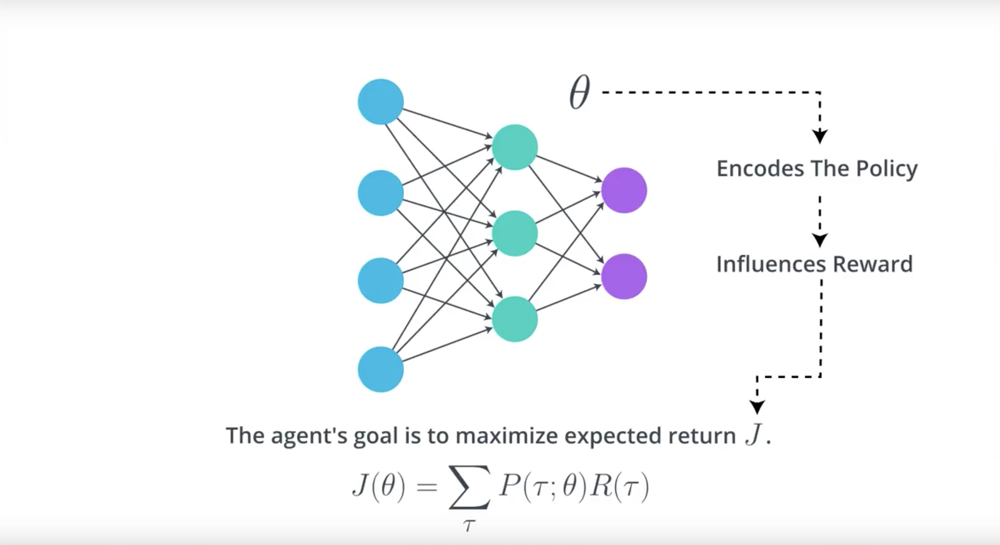

In [14]:
from IPython.display import Image
Image(filename='./images/3-1-4-2_hill_climbiing_neural_relation_between_j_theta.jpeg')

#### We'll refore to the set of weights in the neural network as Theta.
#### There's some mathematical relationship between Theta and the expected return J.
### Main idea is that it's possible to write the expected return J as a fuction of Theta.
## Our goal is to find the values for Theta.

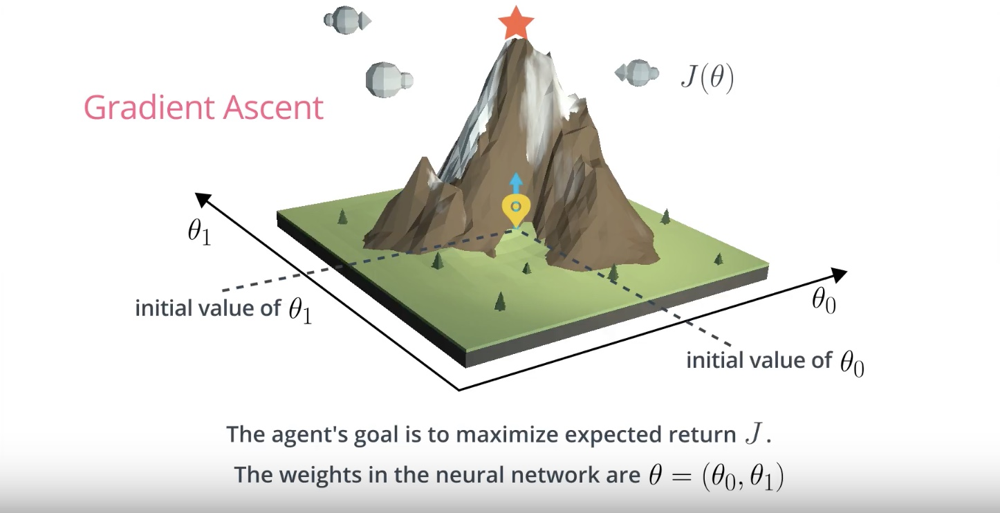

In [15]:
from IPython.display import Image
Image(filename='./images/3-1-4-3_hill_climbiing_neural_gradient_ascent.jpeg')

## Gradient Ascent

Gradient ascent is similar to gradient descent.

    * Gradient descent steps in the direction opposite the gradient, since it wants to minimize a function.
    * Gradient ascent is otherwise identical, except we step in the direction of the gradient, to reach the maximum.

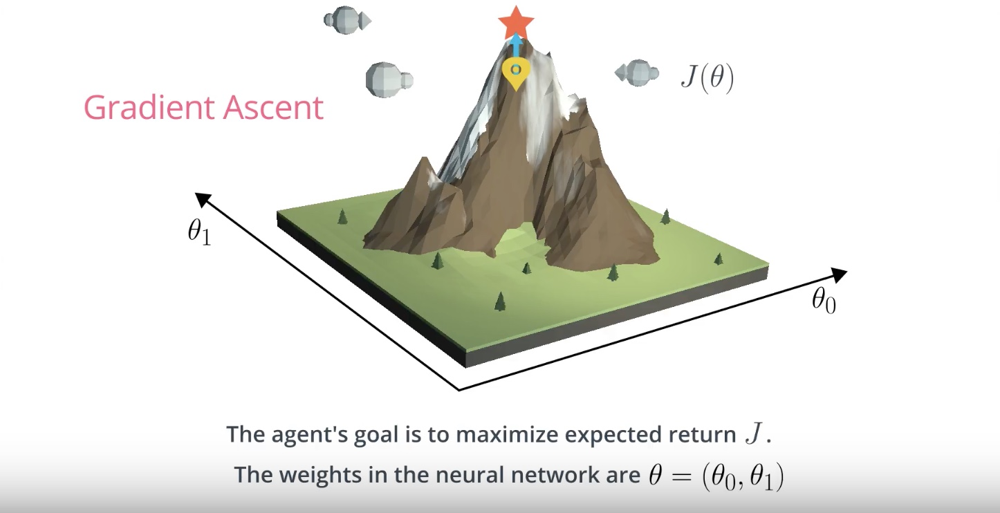

In [16]:
from IPython.display import Image
Image(filename='./images/3-1-4-4_hill_climbiing_reach_maximum_value_of_function.jpeg')

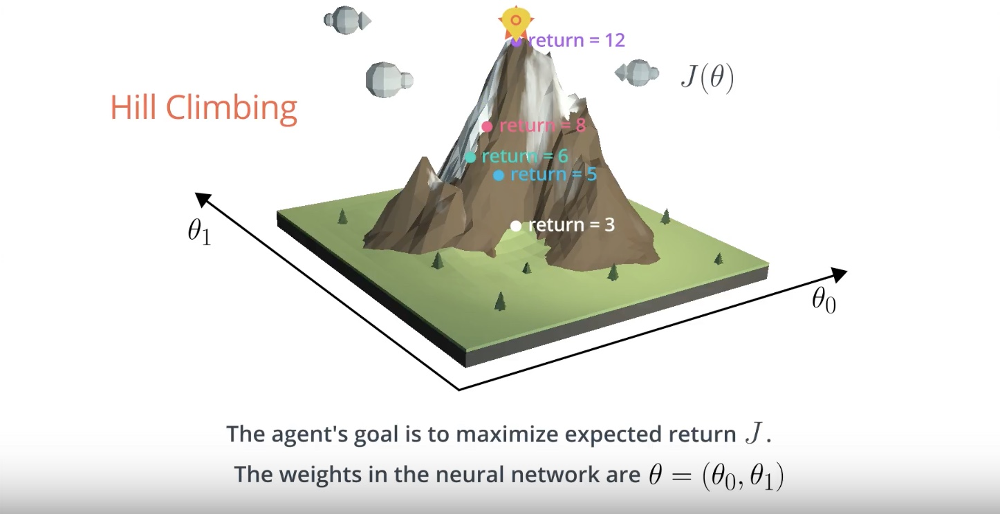

In [17]:
from IPython.display import Image
Image(filename='./images/3-1-4-5_hill_climbiing_reach_optimal_value.jpeg')

## Local Minima

### * hill climbing is a relatively simple algorithm that the agent can use to gradually improve the weights θ in its policy network while interacting with the environment.
### * hill climbing is not guaranteed to always yield the weights of the optimal policy. This is because we can easily get stuck in a local maximum.

## 3-1-5 : Hill Climbing Pseudocode

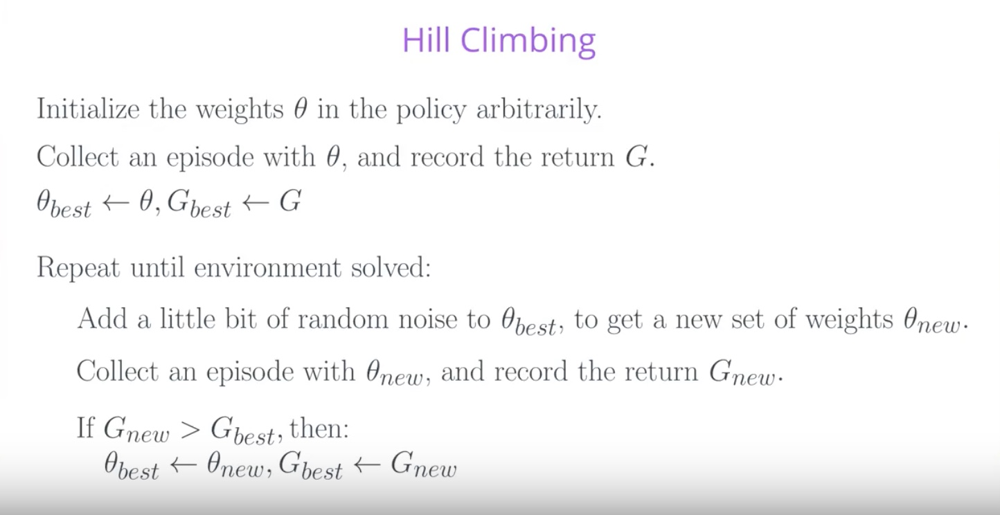

In [18]:
from IPython.display import Image
Image(filename='./images/3-1-5-1_hill_climbiing_pseudocode.jpeg')

## G vs. J (What's the difference?)

#### The agent collects in a single episode (G from the pseudocode above) and the expected return J.
#### In reinforcement learning, the goal of the agent is to find the value of the policy network weights θ that maximizes [expected] return, which we have denoted by J.
### In the hill climbing algorithm, the values of θ are evaluated according to how much return G they collected in a [single episode]
## Due to randomness in the environment (and the policy, if it is stochastic), it is highly likely that if we collect a second episode with the same values for θ, we'll likely get a different value for the return G.
# Because of this, the (sampled) return G is not a perfect estimate for the expected return J, but it often turns out to be [good enough] in practic





## 3-1-6 : Beyond Hill Climbing

* We refer to the general class of approaches that find  argmax J(θ) through randomly perturbing the most recent best estimate as [stochastic policy search]. 
* Likewise, we can refer to J as an [objective function], which just refers to the fact that we'd like to maximize it.


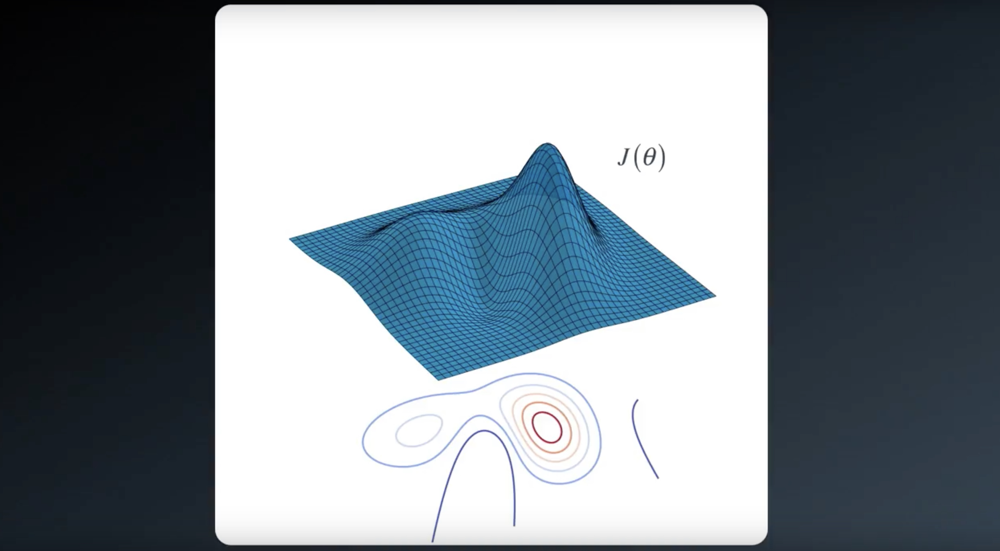

In [19]:
from IPython.display import Image
Image(filename='./images/3-1-6-1_hill_climbiing_we_dont_know_j.jpeg')

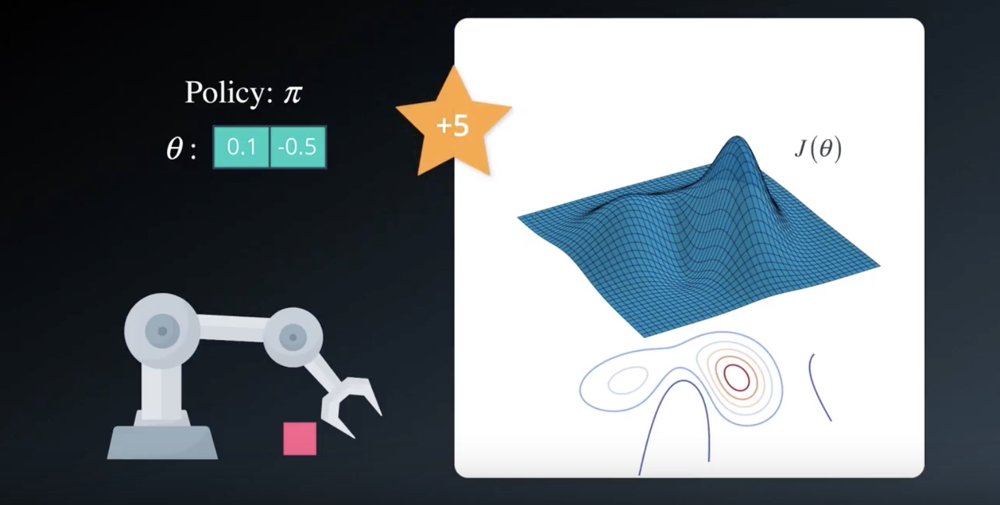

In [20]:
from IPython.display import Image
Image(filename='./images/3-1-6-2_hill_climbiing_with_sochastic_policy_search_returns_objective_value.jpeg')

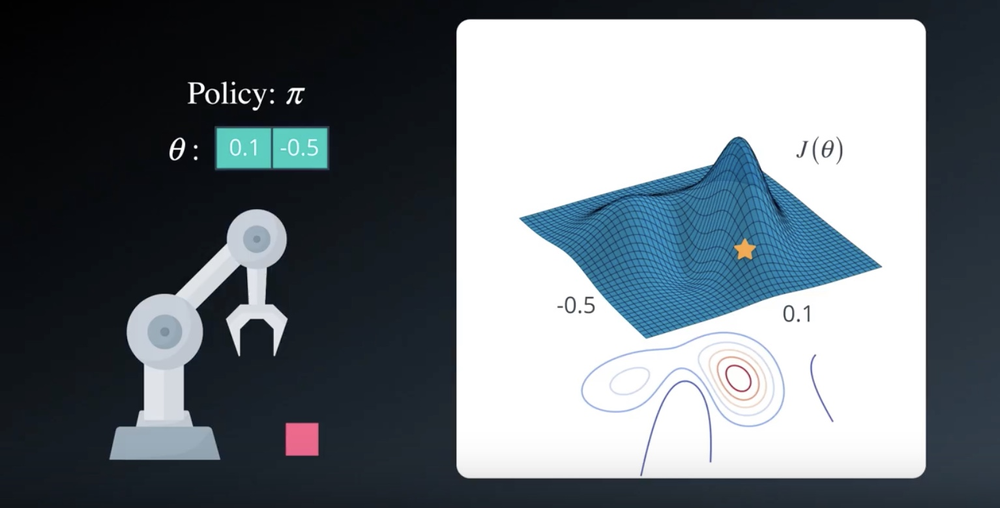

In [21]:
from IPython.display import Image
Image(filename='./images/3-1-6-3_hill_climbiing_policy_is_somewhere_on_the_objective_function_surface.jpeg')

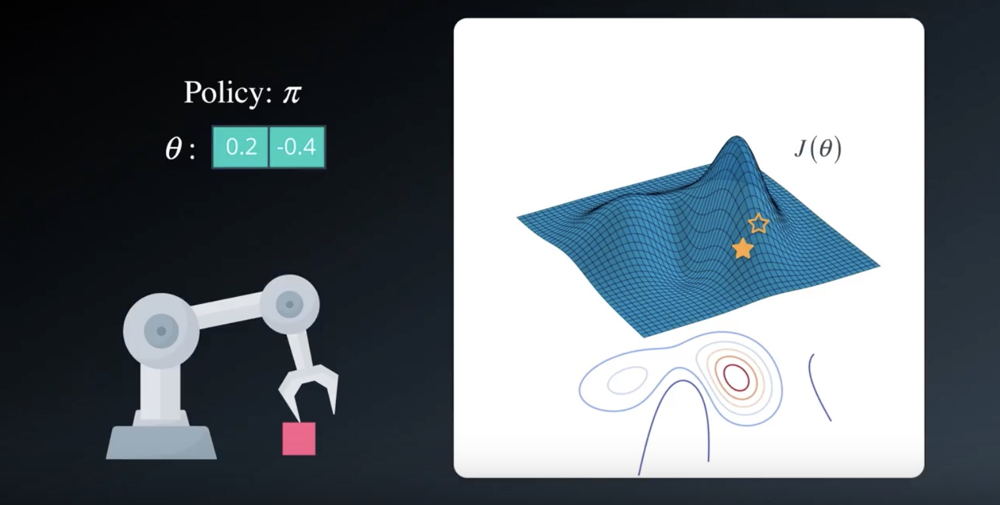

In [22]:
from IPython.display import Image
Image(filename='./images/3-1-6-4_hill_climbiing_change_parameters_by_adding_gaussian_noise.jpeg')

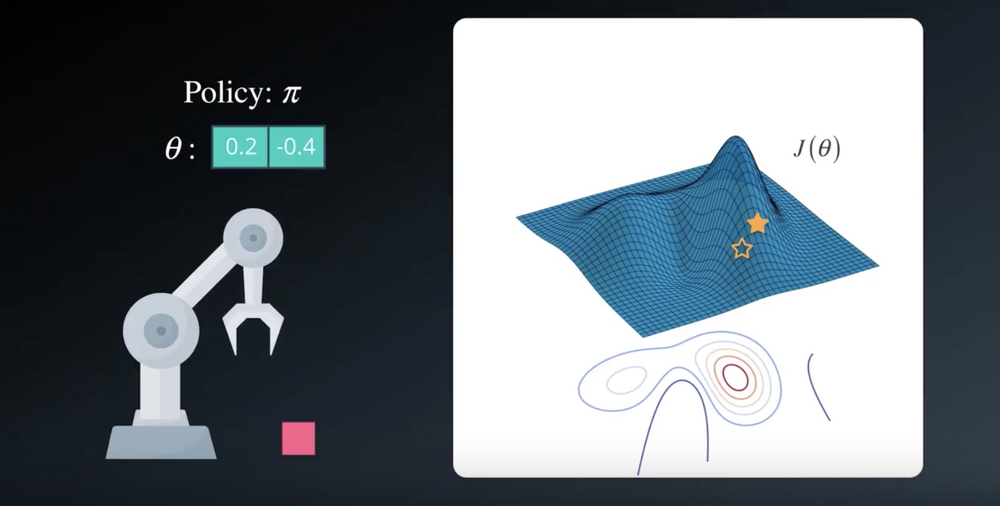

In [23]:
from IPython.display import Image
Image(filename='./images/3-1-6-5_hill_climbiing_set_this_policy_to_new_best_policy.jpeg')

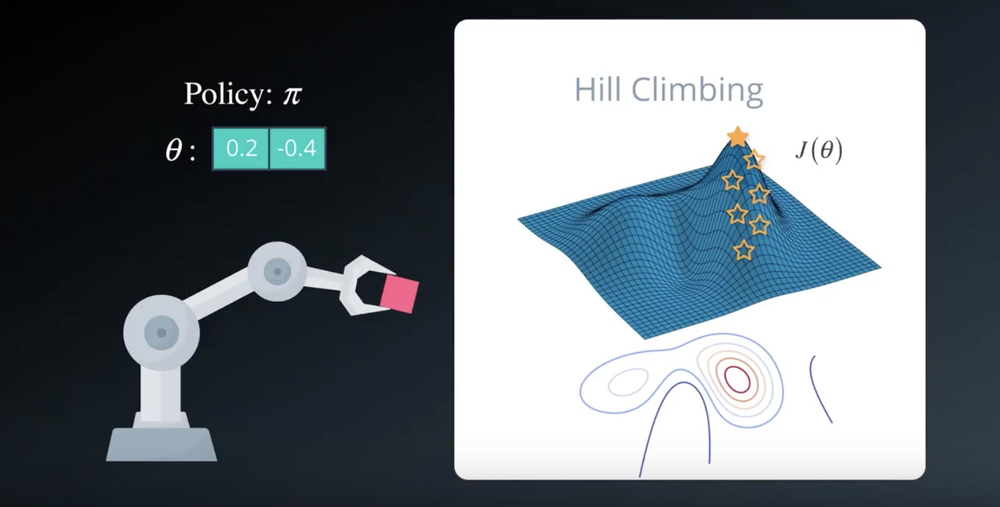

In [24]:
from IPython.display import Image
Image(filename='./images/3-1-6-6_hill_climbiing_iterate_until_top_of_the_hill.jpeg')

## The best part of 'Hill Climbing' is that "You can use any policy function".
## It doesn't need to be differentiable or even continuous.

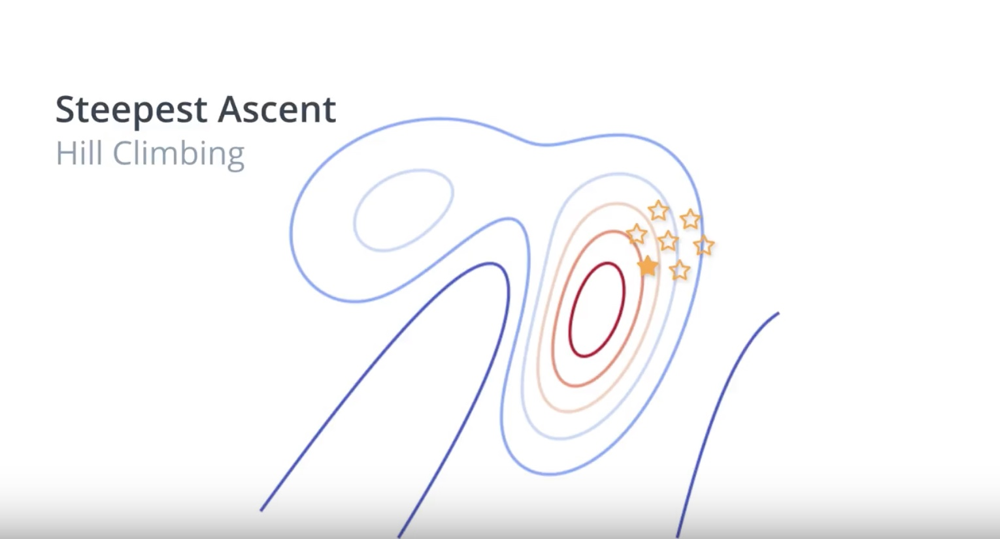

In [25]:
from IPython.display import Image
Image(filename='./images/3-1-6-7_beyond_hill_climbiing_steepest_ascent.jpeg')

## Stepest Ascent

* It generates several neighboring policies at each iteration.
* It helps reduce the risk of selecting a next policy that may lead to a suboptimal solution. 
* You could still get stuck in local optima.

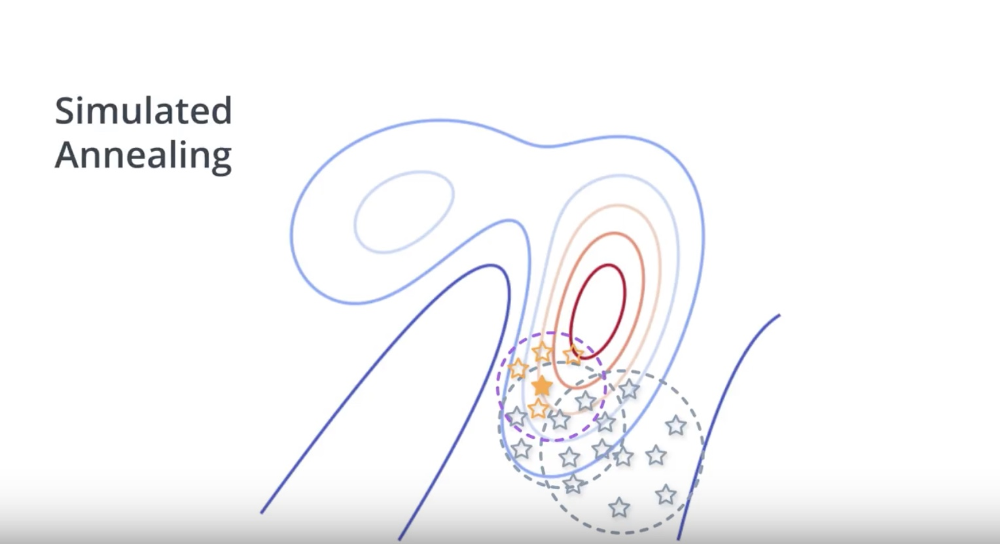

In [26]:
from IPython.display import Image
Image(filename='./images/3-1-6-8_beyond_hill_climbiing_simulated_annealing.jpeg')

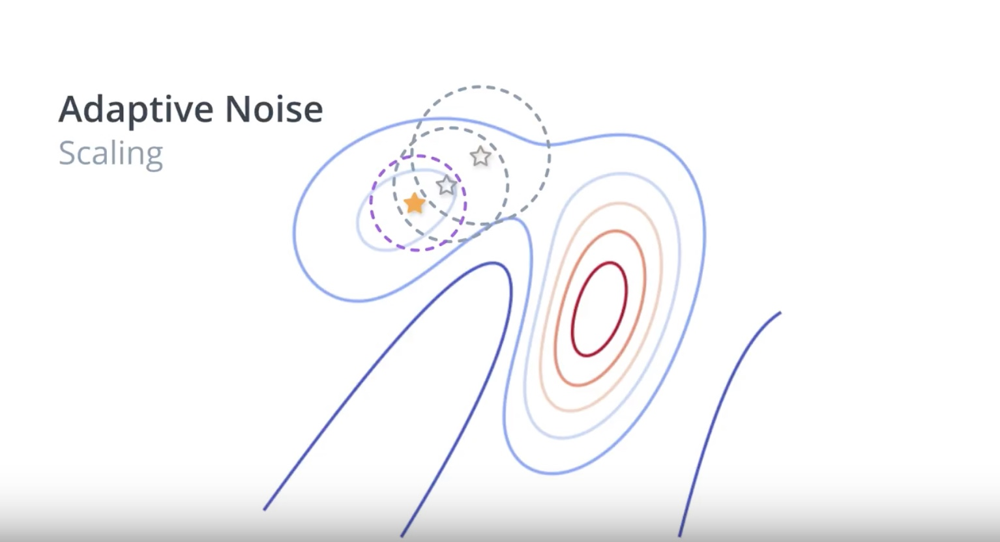

In [27]:
from IPython.display import Image
Image(filename='./images/3-1-6-9_beyond_hill_climbiing_adaptive_noise_same_as_sa.jpeg')

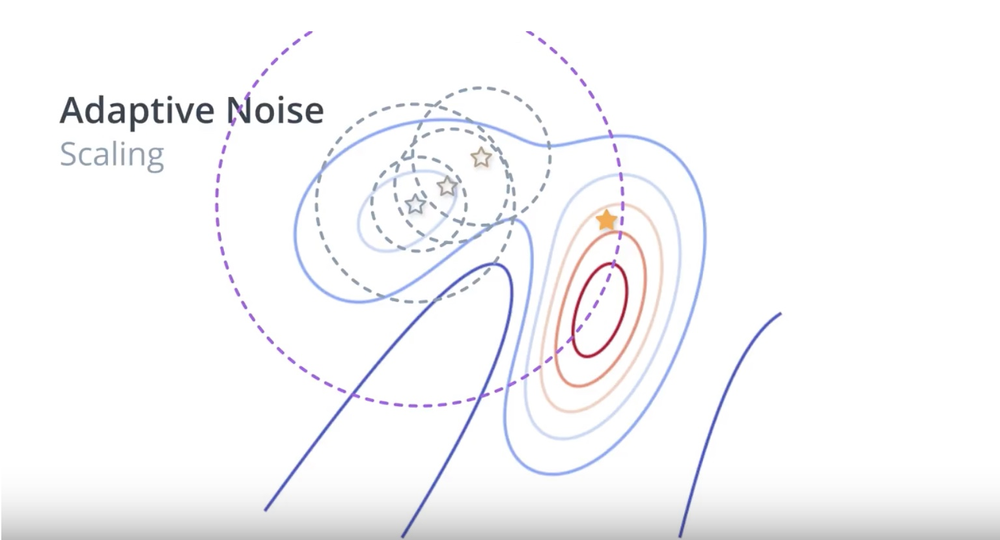

In [28]:
from IPython.display import Image
Image(filename='./images/3-1-6-10_beyond_hill_climbiing_adaptive_noise_extend_serach_radius_when_is_not_best.jpeg')

## 3-1-7 : More Black-Box Optimization

#### * Black-box refers to the fact that in order to find the value of θ that maximizes the function J=J(θ), we need only be able to estimate the value of J at any potential value of θ.
#### * Both hill climbing and steepest ascent hill climbing don't know that we're solving a reinforcement learning problem, and they do not care that the function we're trying to maximize corresponds to the expected return.
### * These algorithms only know that for each value of θ, there's a corresponding number. 
### * We know that this number corresponds to the return obtained by using the policy corresponding to θ to collect an episode, but the algorithms are not aware of this.
## To the algorithms, the way we evaluate θ is considered a black box, and they don't worry about the details.
## The algorithms only care about finding the value of θ that will maximize the number that comes out of the black box.

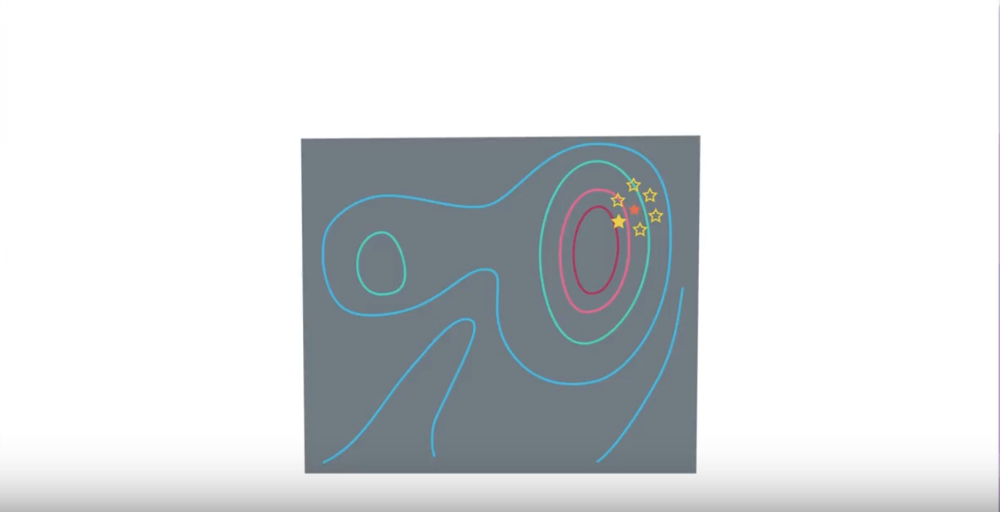

In [29]:
from IPython.display import Image
Image(filename='./images/3-1-7-1_steepest_ascent_dont_use_usuful_imformation_from_not_selected.jpeg')

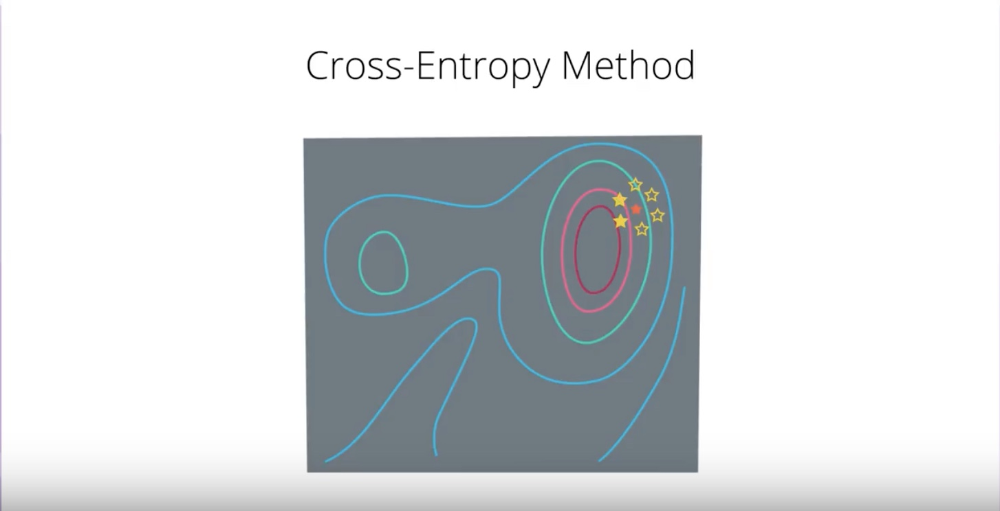

In [30]:
from IPython.display import Image
Image(filename='./images/3-1-7-2_cross_entropy_method_select_top_n_and_use_average_of_them.jpeg')

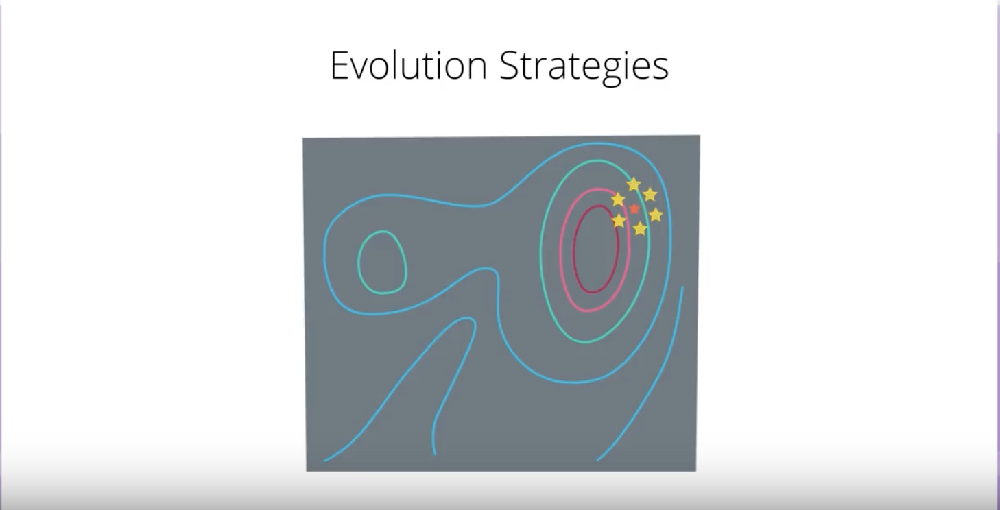

In [31]:
from IPython.display import Image
Image(filename='./images/3-1-7-3_evolution_strategies_the_best_policy_is_weighted_sum_of_all_selected.jpeg')

## 3-1-8 : Why Policy-Based Methods?

why do we need policy-based methods at all, when value-based methods work so well?

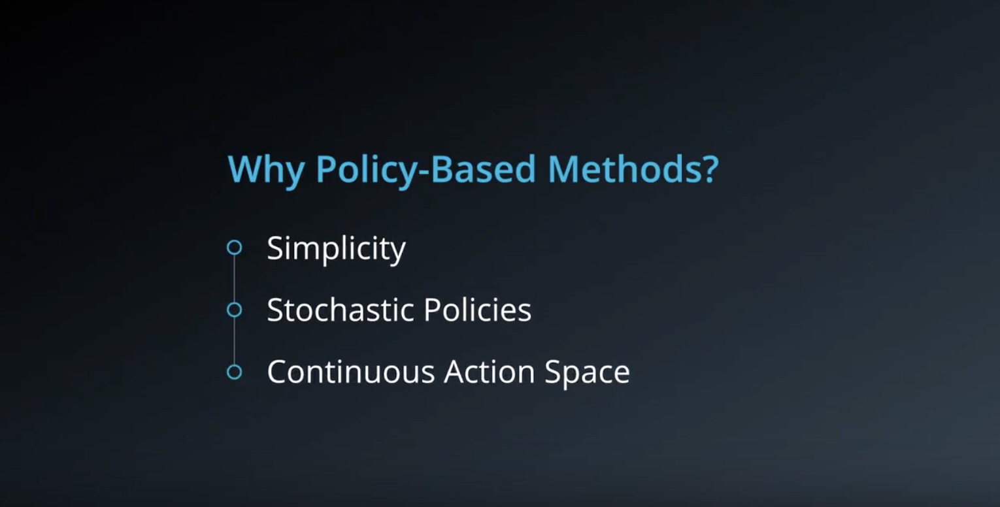

In [32]:
from IPython.display import Image
Image(filename='./images/3-1-8-1_policy_based_method_why.jpeg')

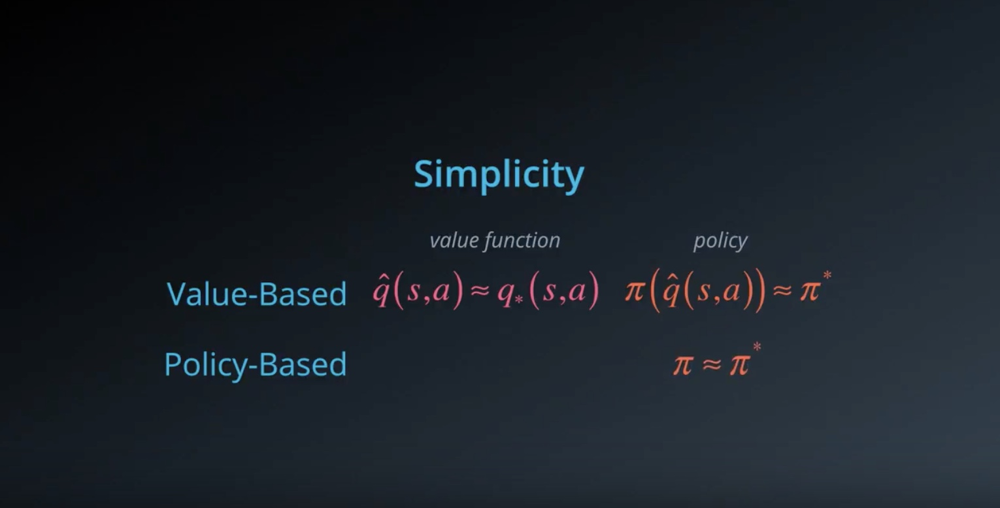

In [33]:
from IPython.display import Image
Image(filename='./images/3-1-8-2_policy_based_method_simplicity.jpeg')

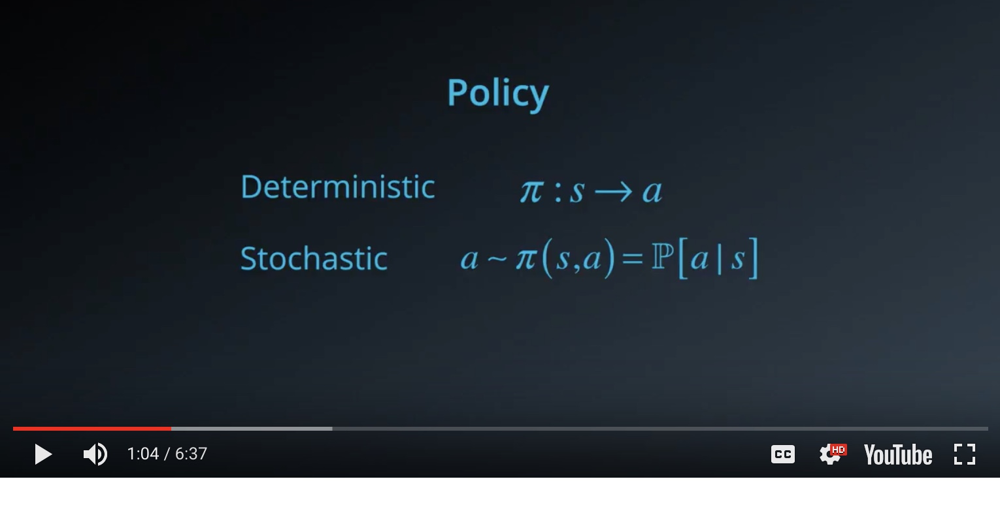

In [34]:
from IPython.display import Image
Image(filename='./images/3-1-8-3_policy_based_method_policy_look_like.jpeg')

- Deterministic Policy : Simply need to be a mapping or fuction from states to actions.
- Stochastic Policy : We woul choose an action based on this probability distribution.

## Advantages of "Directly Estimating the optimal policy = Policy-based method's main idea"
### 1 it avoids having to store a bunch of additional data.(large portions of the state space may have the same value.)
### 2 it is easy to make algorithm more generalized.
### 3 we can focus more on the complicated regions of state space.

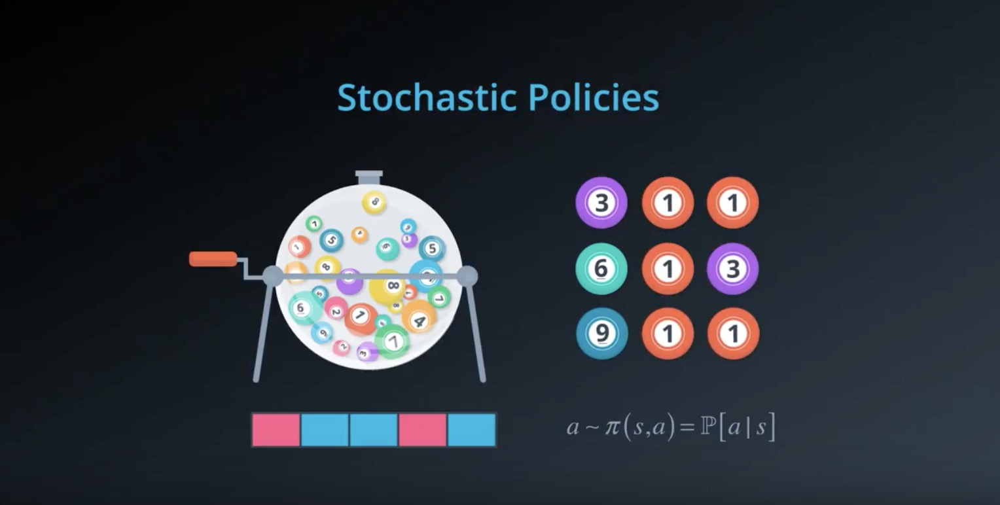

In [35]:
from IPython.display import Image
Image(filename='./images/3-1-8-4_policy_based_method_stochastic_plicies.jpeg')

## One of the main advantages of policy-based methods over value-based methods is that "Policy-based methods can learn true stochastic policies"

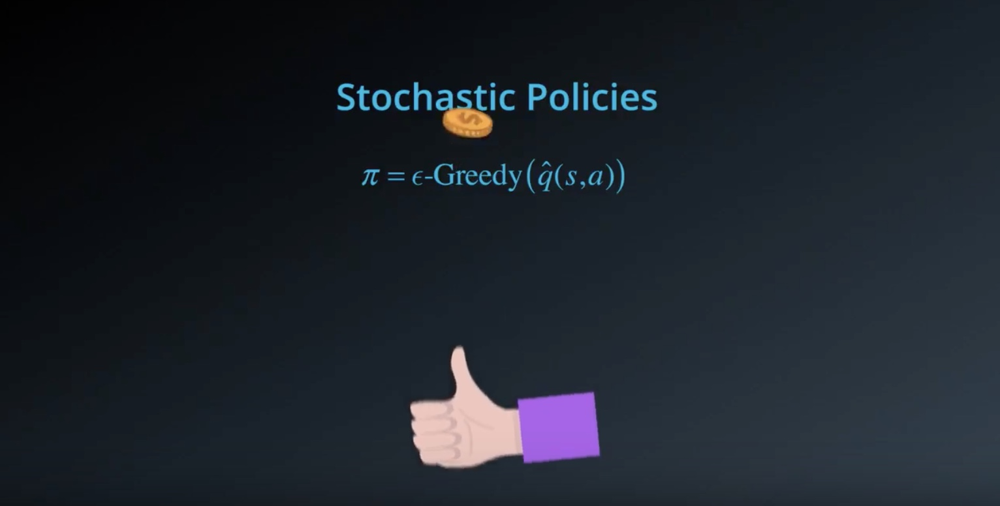

In [36]:
from IPython.display import Image
Image(filename='./images/3-1-8-5_value_based_method_e-greedy_is_a_hack.jpeg')

## In contrast, when we apply epsilon-greedy actions selection to a value fuction, that does add some randomness, but it is a hack.

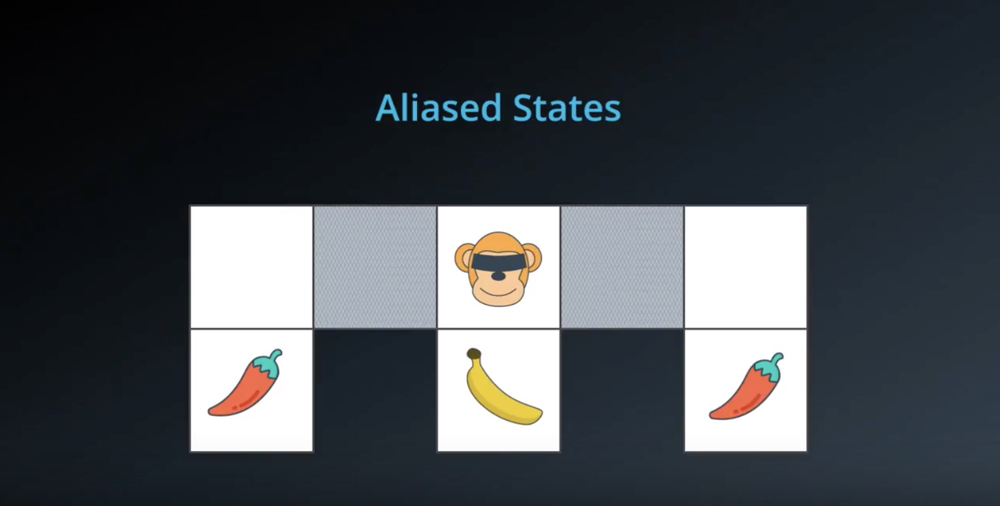

In [37]:
from IPython.display import Image
Image(filename='./images/3-1-8-6_policy_based_method_aliased_states.jpeg')

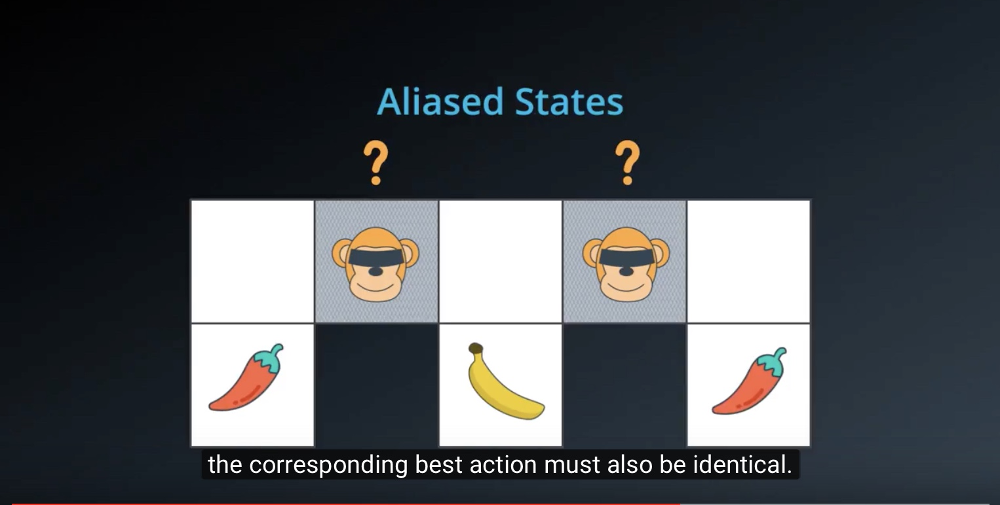

In [38]:
from IPython.display import Image
Image(filename='./images/3-1-8-7_policy_based_method_aliased_states_if_using_value_function.jpeg')

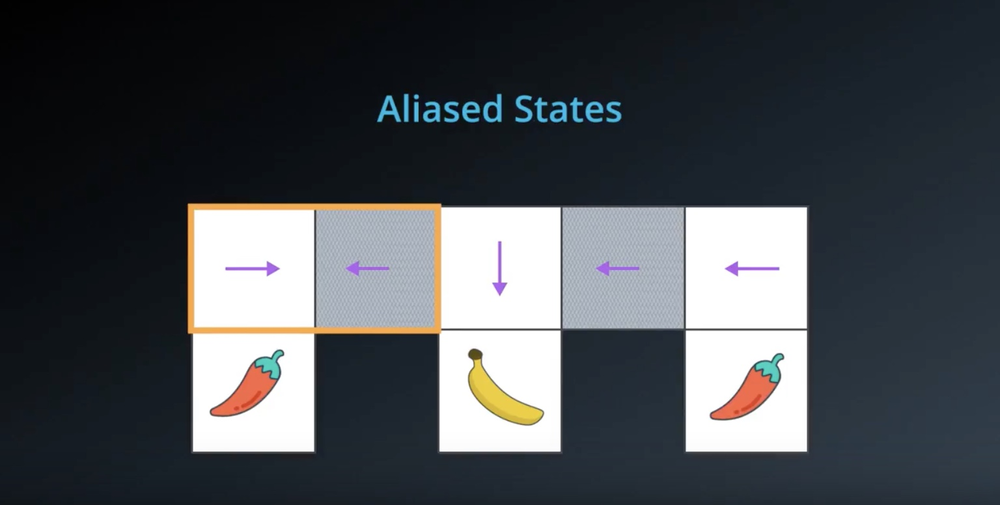

In [39]:
from IPython.display import Image
Image(filename='./images/3-1-8-8_policy_based_method_aliased_states_if_using_value_function_then_keep_oscillating_never_get_out.jpeg')

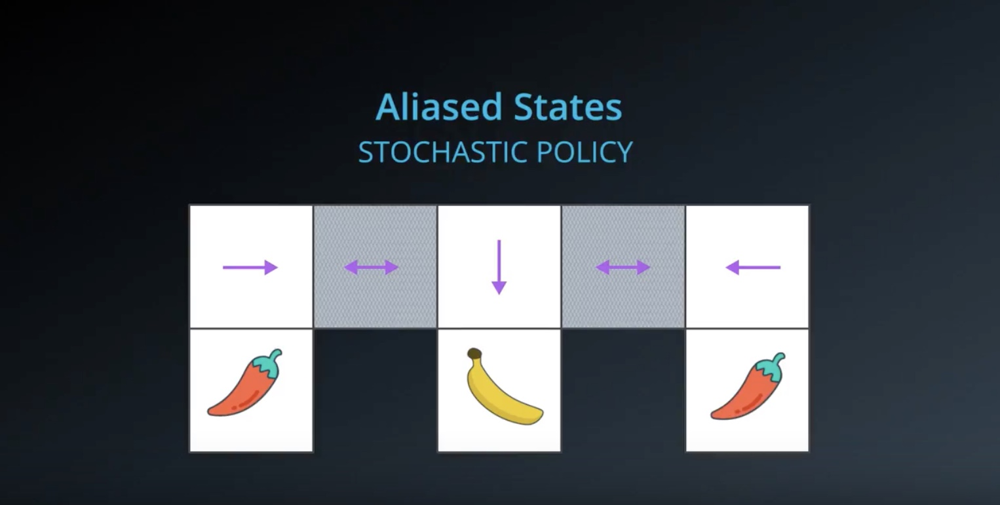

In [40]:
from IPython.display import Image
Image(filename='./images/3-1-8-9_policy_based_method_aliased_states_if_using_policy_based_method_then_learn_desired_stochastic_policy.jpeg')


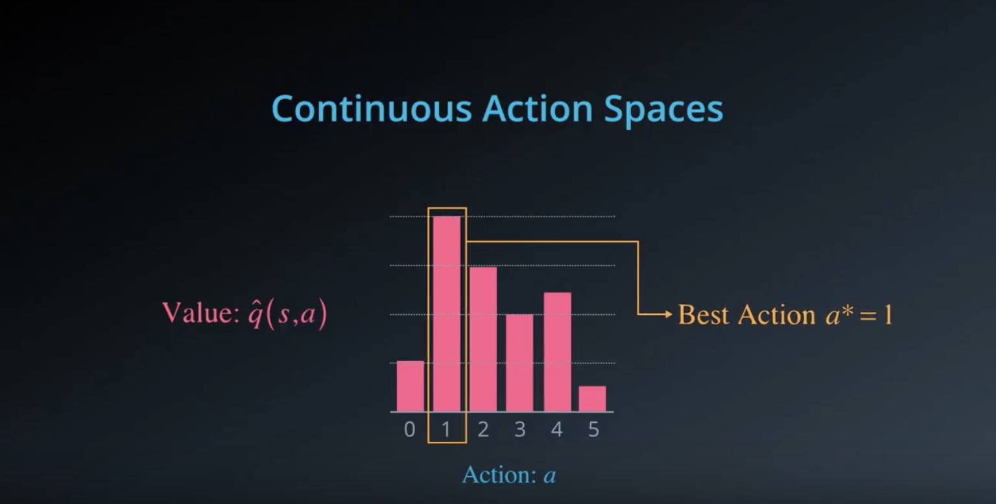

In [41]:
from IPython.display import Image
Image(filename='./images/3-1-8-10_policy_based_method_discret_action_space.jpeg')

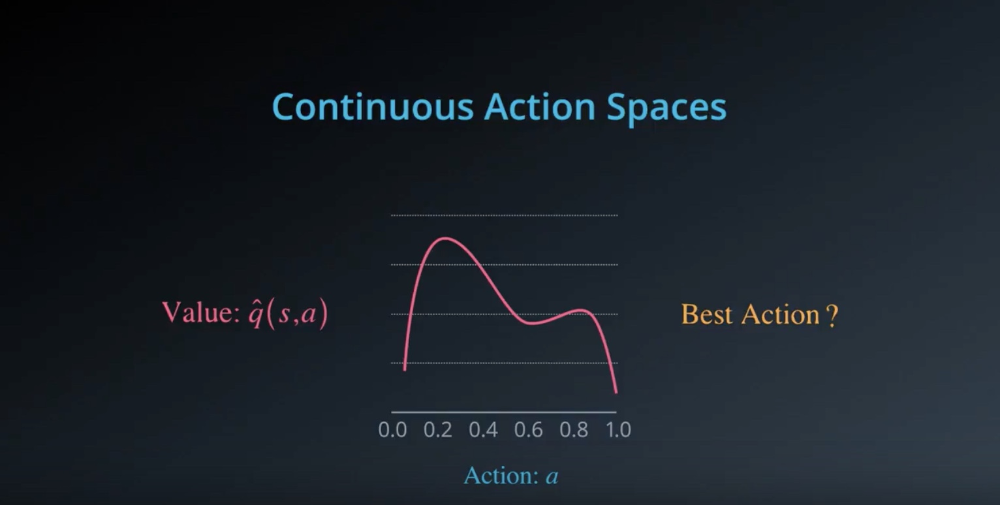

In [42]:
from IPython.display import Image
Image(filename='./images/3-1-8-11_policy_based_method_continuous_action_space.jpeg')

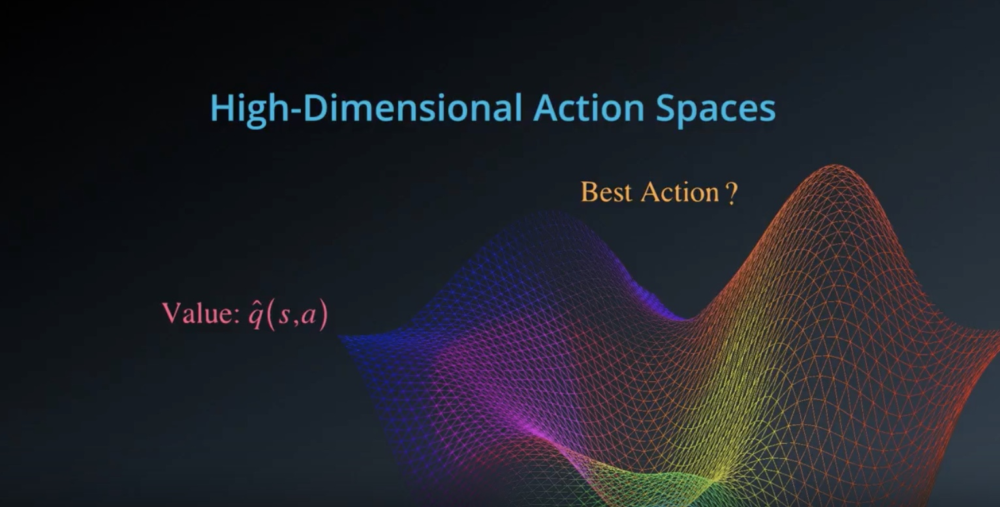

In [43]:
from IPython.display import Image
Image(filename='./images/3-1-8-12_policy_based_method_high-dimensional_continuous_action_space.jpeg')

# Lesson 3-2: Policy Gradient Methods

## 3-2-1 : What are Policy Gradient Methods?

Policy gradient methods are a subclass of policy-based methods.

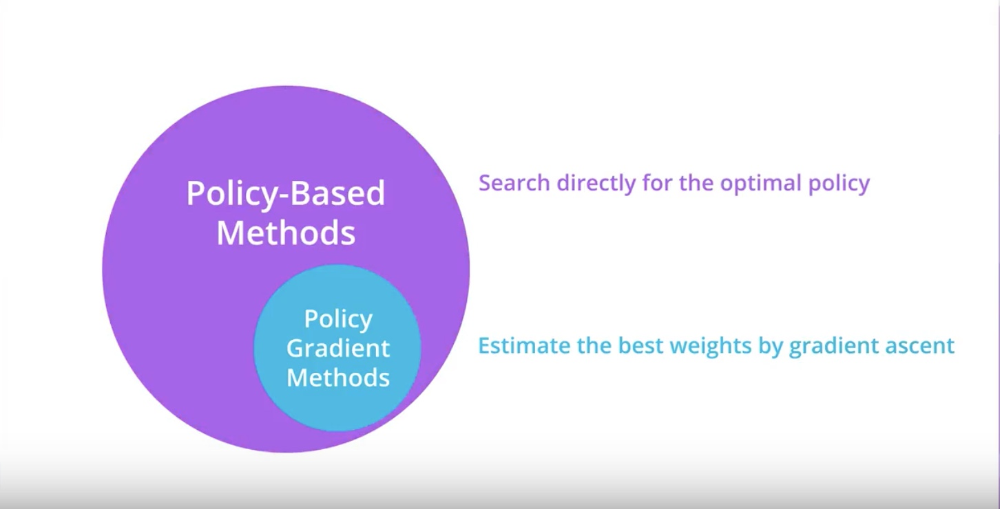

In [44]:
from IPython.display import Image
Image(filename='./images/3-2-1-1_policy_gradient_methods_is_subset_of_policy_based_methods.jpeg')

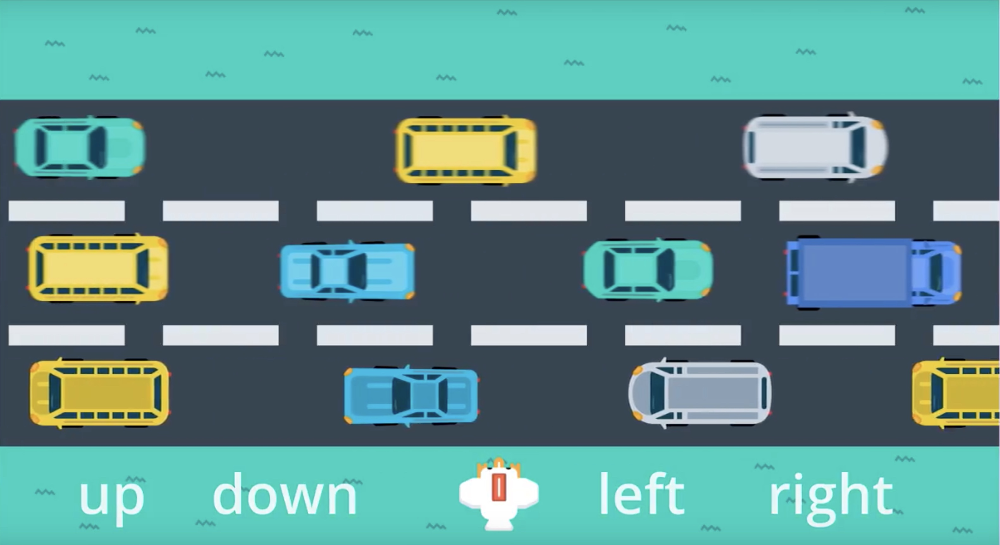

In [45]:
from IPython.display import Image
Image(filename='./images/3-2-1-2_policy_gradient_methods_chicken_cross_the_road.jpeg')

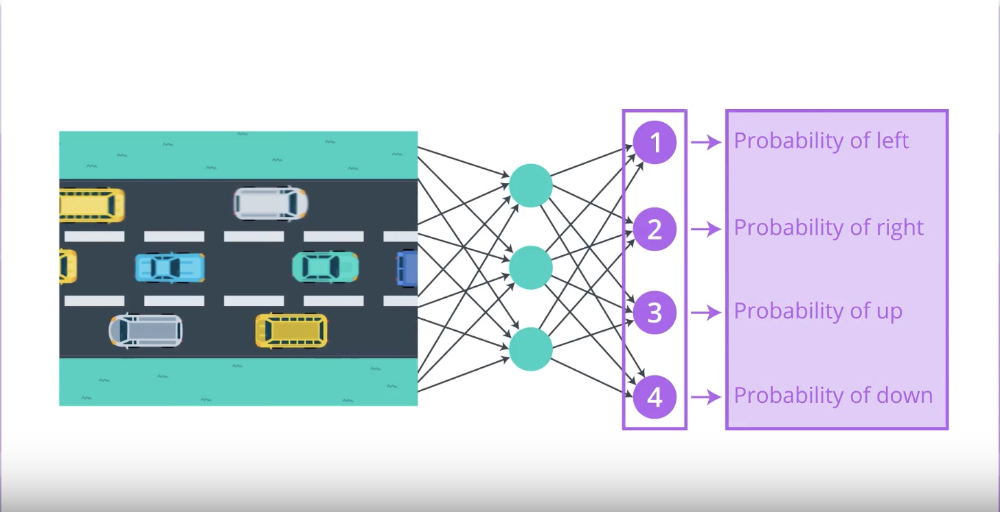

In [46]:
from IPython.display import Image
Image(filename='./images/3-2-1-3_policy_gradient_methods_case_of_four_possible_actions.jpeg')

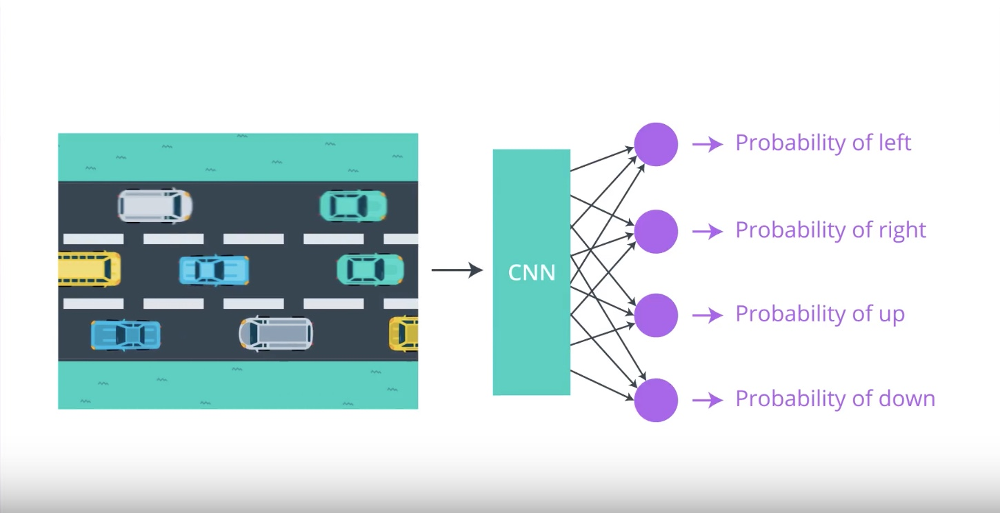

In [47]:
from IPython.display import Image
Image(filename='./images/3-2-1-4_policy_gradient_methods_possibly_cnn_is_best.jpeg')

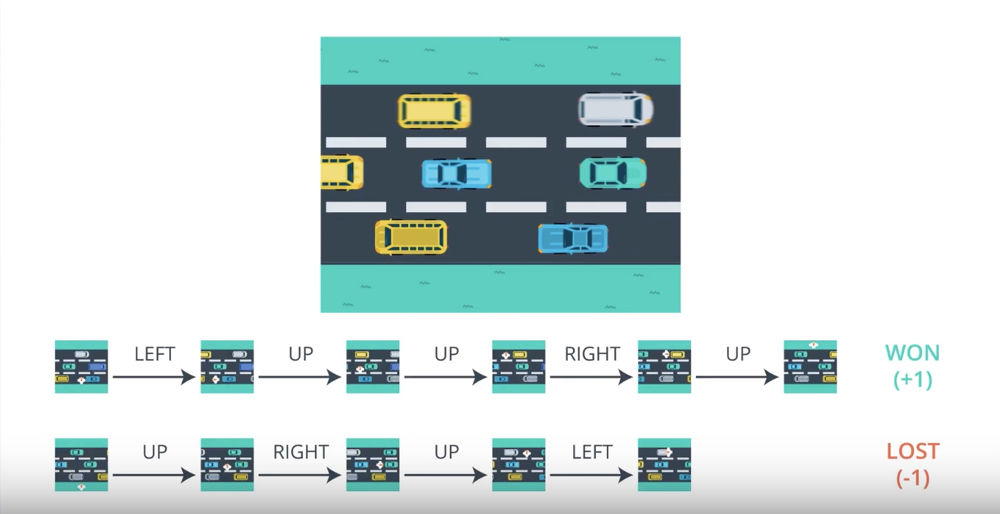

In [48]:
from IPython.display import Image
Image(filename='./images/3-2-1-5_policy_gradient_methods_reward_only_delivered_at_the_end_of_game.jpeg')

## 3-2-2 : The Big Picture of PG

Before digging into the details of policy gradient methods, we'll discuss how they work at a high level.

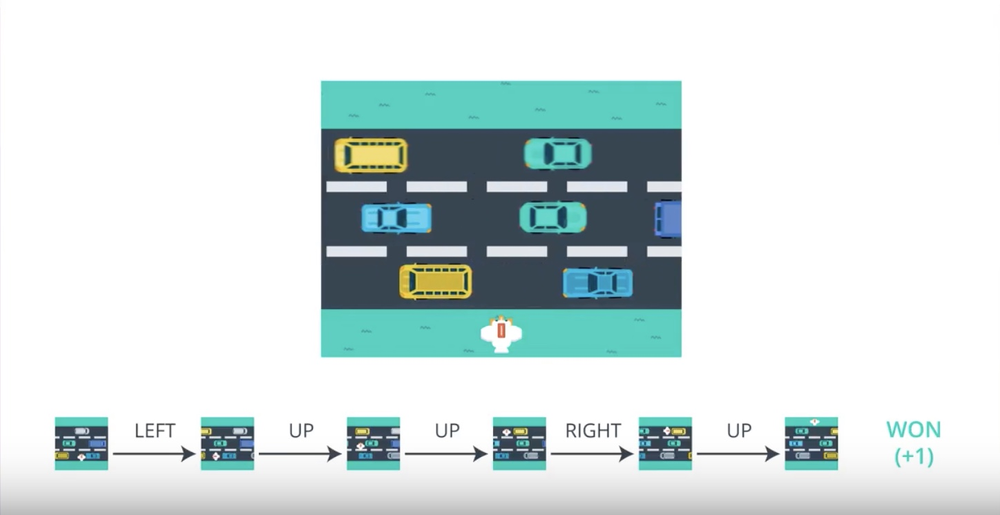

In [49]:
from IPython.display import Image
Image(filename='./images/3-2-2-1_pg_big_picture_case_of_win.jpeg')

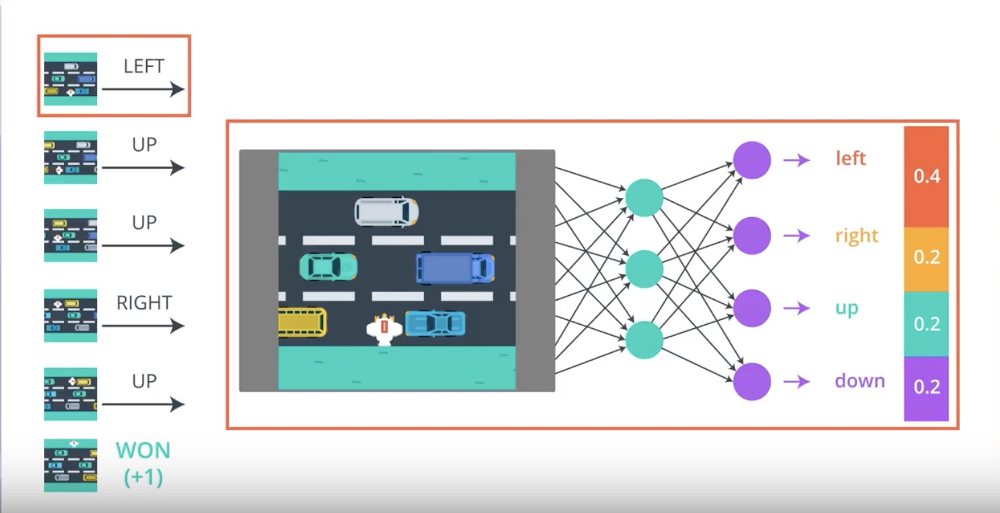

In [50]:
from IPython.display import Image
Image(filename='./images/3-2-2-2_pg_big_picture_case_of_win_getting_action_posibilities_from_1st_timestamp.jpeg')

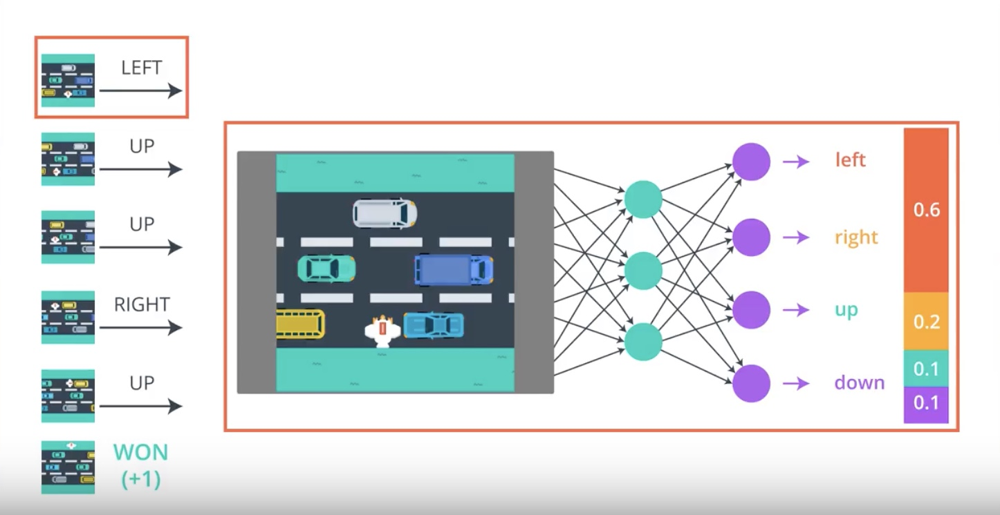

In [51]:
from IPython.display import Image
Image(filename='./images/3-2-2-3_pg_big_picture_case_of_win_change_parameters_a_litte_bit_to_direction_winning_game.jpeg')

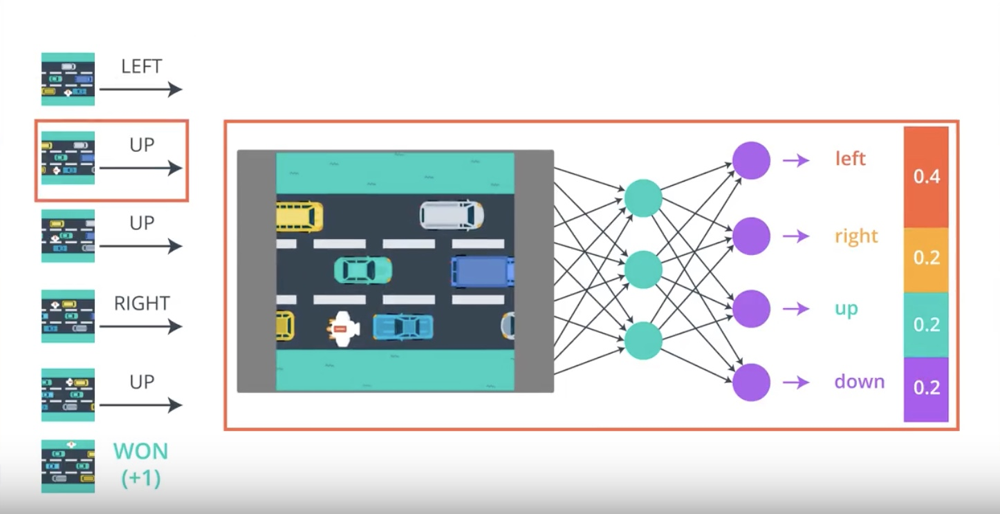

In [52]:
from IPython.display import Image
Image(filename='./images/3-2-2-4_pg_big_picture_case_of_win_getting_action_posibilities_from_2nd_timestamp.jpeg')

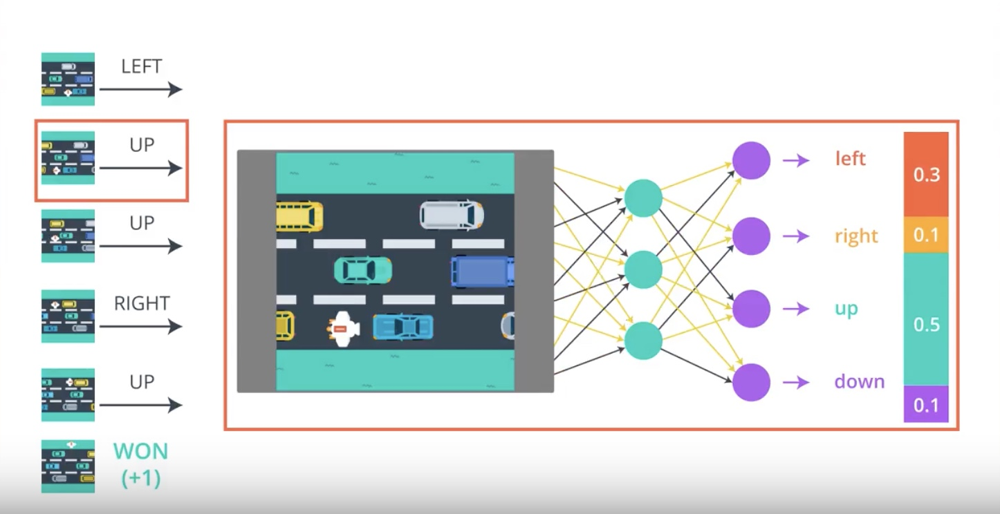

In [53]:
from IPython.display import Image
Image(filename='./images/3-2-2-5_pg_big_picture_case_of_win_change_parameters_a_litte_bit_to_up_direction_winning_game.jpeg')

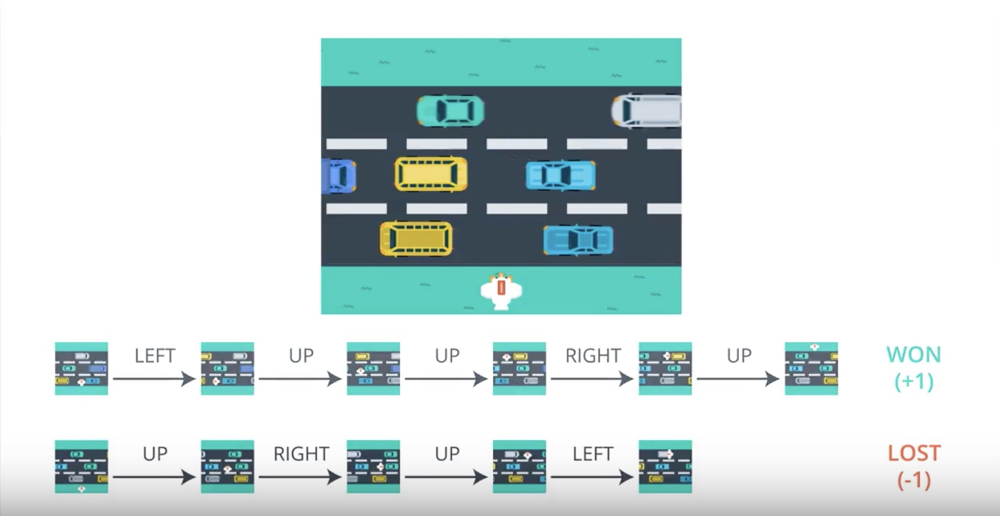

In [54]:
from IPython.display import Image
Image(filename='./images/3-2-2-6_pg_big_picture_case_of_lost.jpeg')

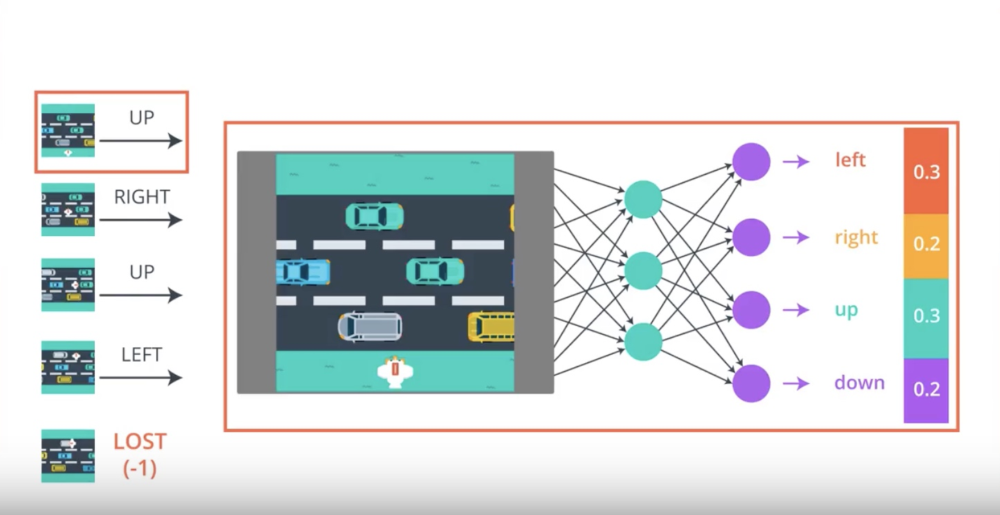

In [55]:
from IPython.display import Image
Image(filename='./images/3-2-2-7_pg_big_picture_case_of_lost_getting_action_posibilities_from_1st_timestamp.jpeg')

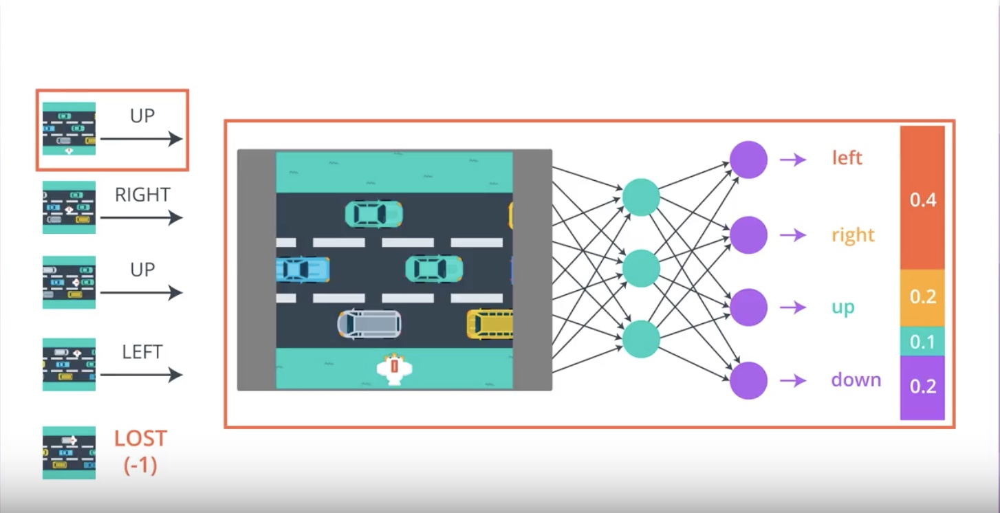

In [56]:
from IPython.display import Image
Image(filename='./images/3-2-2-8_pg_big_picture_case_of_lost_change_parameters_a_litte_bit_to_direction_winning_game.jpeg')

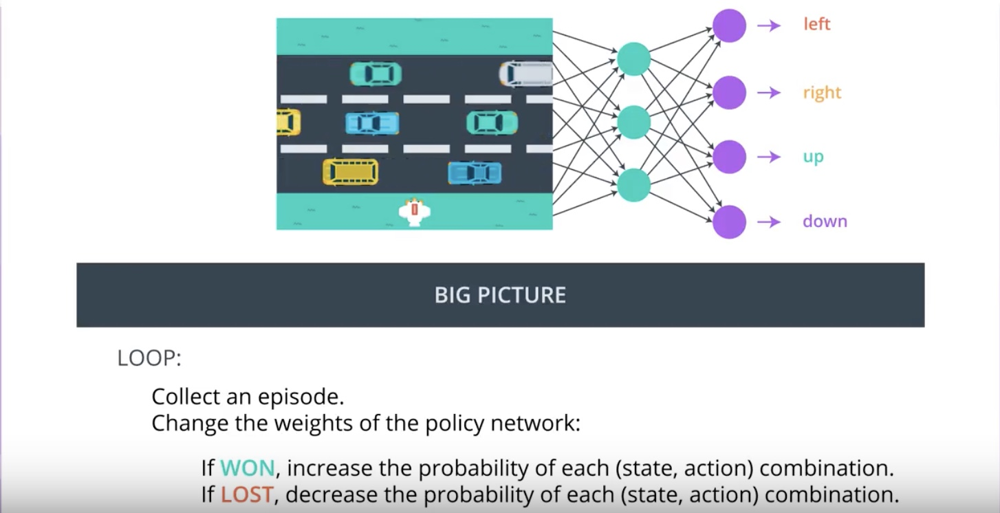

In [57]:
from IPython.display import Image
Image(filename='./images/3-2-2-9_pg_big_picture_pseudocode.jpeg')

## 3-2-3 : Connections to Supervised Learning

Policy gradient methods are very similar to supervised learning.

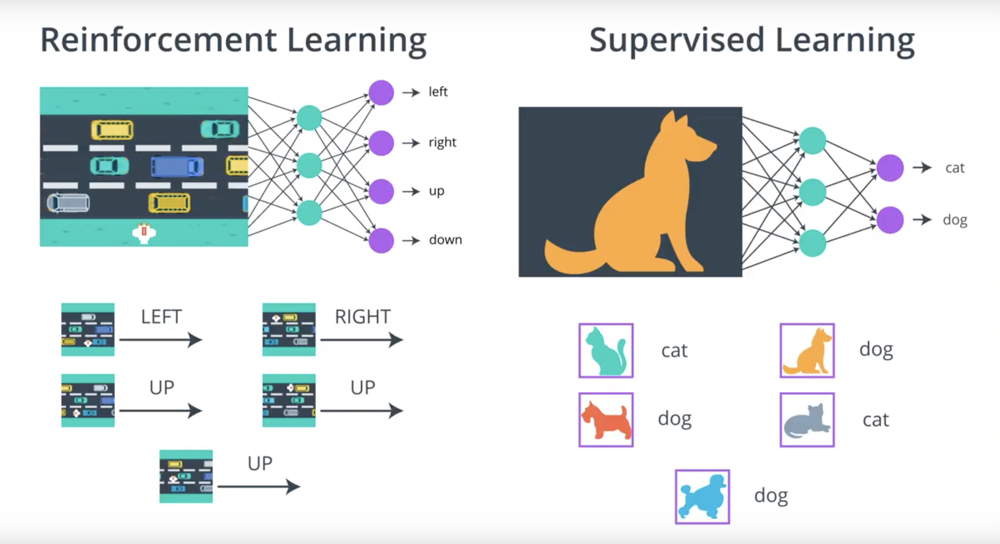

In [58]:
from IPython.display import Image
Image(filename='./images/3-2-3-1_pg_is_similar_to_supervised_learning.jpeg')

## Difference between RL(PG) and SL
1. In SL, we typically work with the dataset that doesn't change over time.
2. In RL, the dataset varies by episode and changes pretty frequently.
3. In both(SL,RL), the dataset has mutiple conflicting opinions about what the best output should be for an input.

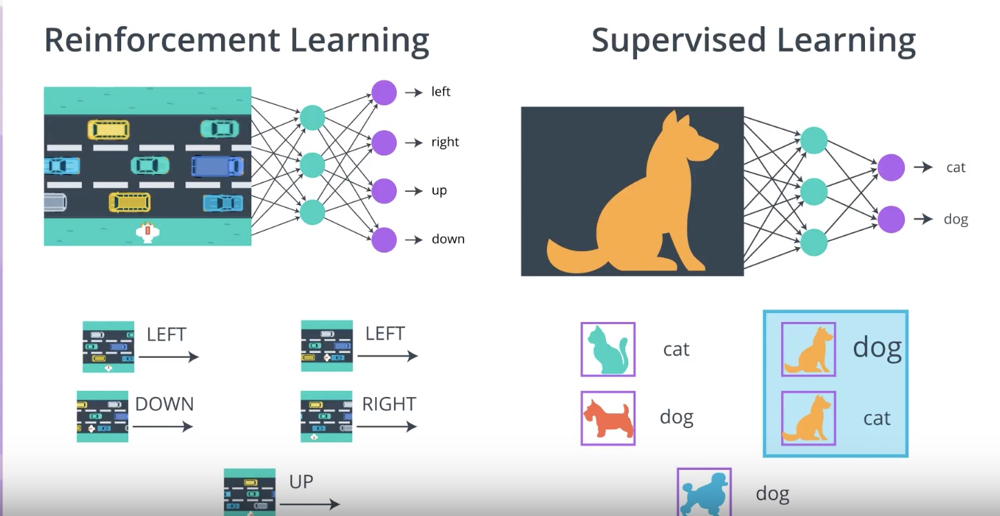

In [59]:
from IPython.display import Image
Image(filename='./images/3-2-3-2_pg_is_similar_to_sl_mutiple_conflicting_opinions.jpeg')

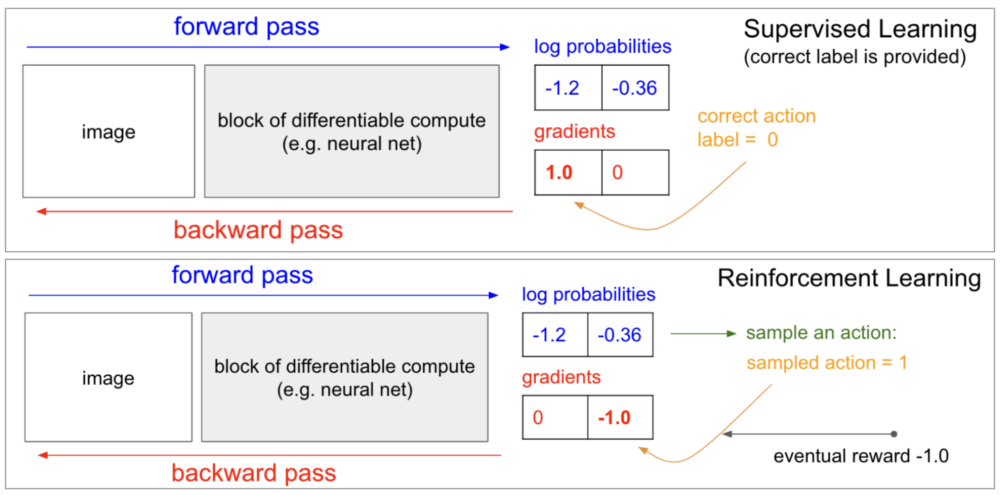

In [60]:
from IPython.display import Image
Image(filename='./images/3-2-3-3_more_learn_connection_between_sl_with_rl.png')

### To further explore the connections between policy gradient methods and supervised learning, you're encouraged to check out [Andrej Karpathy's famous blog post] {http://karpathy.github.io/2016/05/31/rl/}.

## 3-2-4 : How PG work?

Define how policy gradient methods will work.

## Why Trajectories?

### Question is..."You may be wondering: why are we using trajectories instead of episodes?"
### Answer is..."maximizing expected return over trajectories (instead of episodes) lets us search for optimal policies for both episodic and continuing tasks!"

- For many episodic tasks, it often makes sense to just use the full episode. In particular, for the case of the video game examples, reward is only delivered at the end of the episode.
- In order to estimate the expected return, the trajectory should correspond to the full episode; otherwise, we don't have enough reward information to meaningfully estimate the expected return.

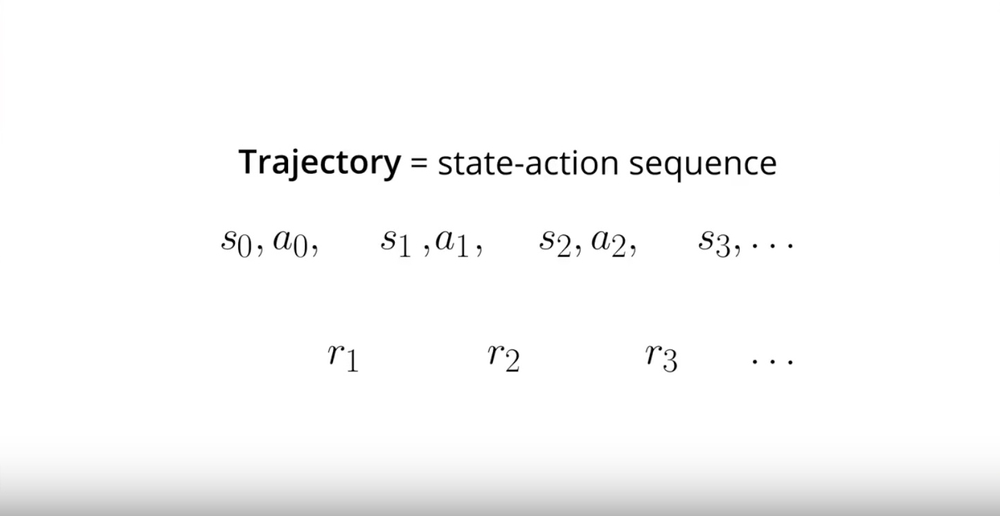

In [61]:
from IPython.display import Image
Image(filename='./images/3-2-4-1_how_pg_work_trajectory_is_state_action_sequence.jpeg')

## Notation
### * we denote "the Trajectory" as Tau.
### * we denote "the sum reward from that Trajectory" as R of Tau.

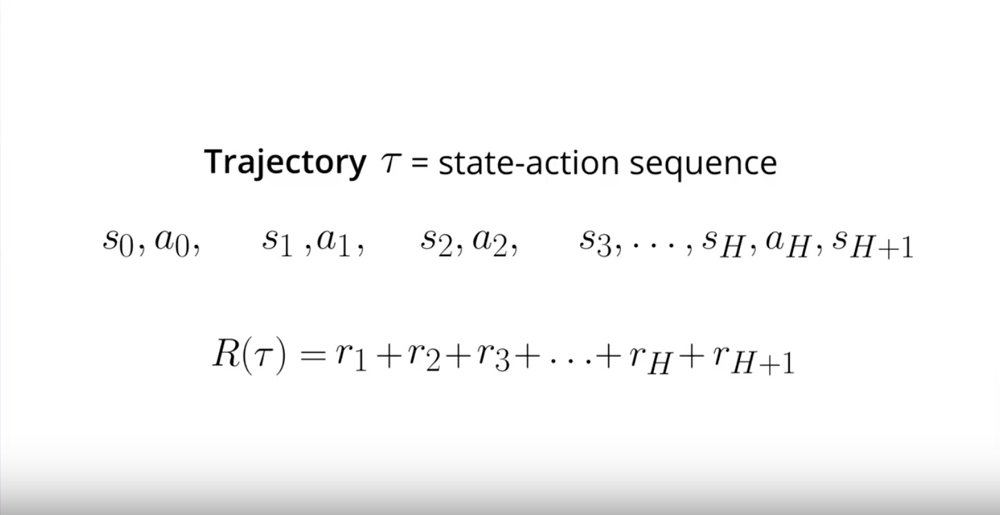

In [62]:
from IPython.display import Image
Image(filename='./images/3-2-4-2_how_pg_work_trajectory_does_not_keep_track_rewards.jpeg')

## Our goal is finding the weight Theta of the neural network that maximize expected return.
## One way of accomplishing our goal is by setting the weights of neural network so that on average.

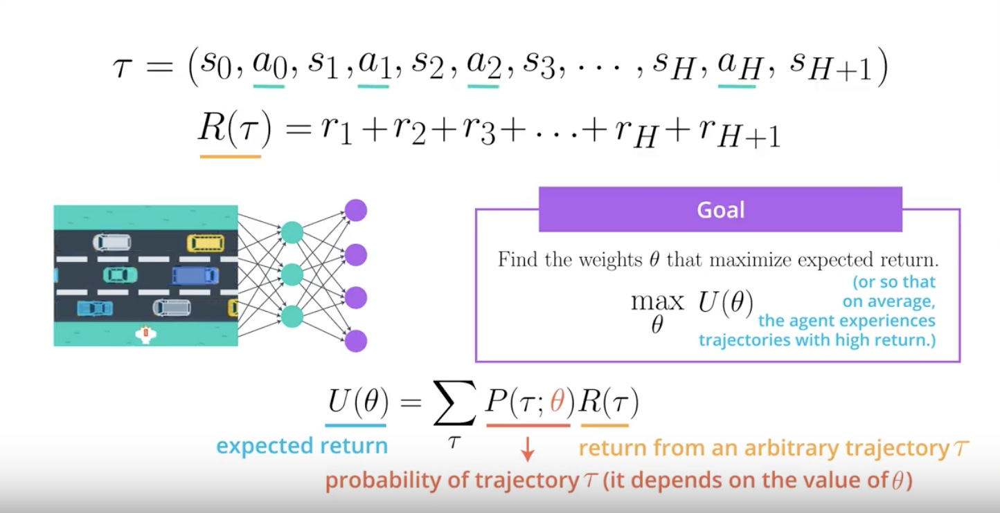

In [63]:
from IPython.display import Image
Image(filename='./images/3-2-4-3_how_pg_work_deep_dive.jpeg')

## Notation
### * We denote "the expected return" by U.
### * U is a fuction of Theta.
### * We want to maximize Theta.
### * The notation "Semicolon" means that Theta has influence on the probability of a Trajectory.

## PG working explanation
### 1. "R of Tau" is just the return corresponding to an arbitrary Trajectory.
### 2. Take this value of "R of Tau" and use it to calculate the expected return "U".
### 3. We need only take into account the probability of each possible "Trajectory".
### 4. That probability depends on the weights "Theta" in the neural network.
### 5. "Theta" defines the policy.
### 6. Policy is used to select the actions in the Trajectory.
### 7. Actions is determining the states in the Trajectory.


## 3-2-5 : REINFORCE

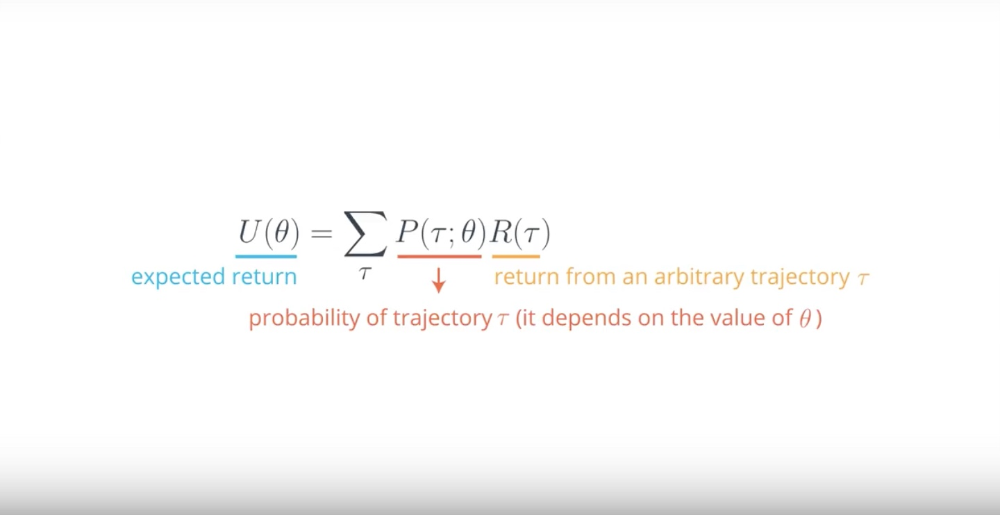

In [64]:
from IPython.display import Image
Image(filename='./images/3-2-5-1_reinforce_check_our_goal_first.jpeg')

## Our goal is finding the weight Theta of the neural network that maximize expected return.

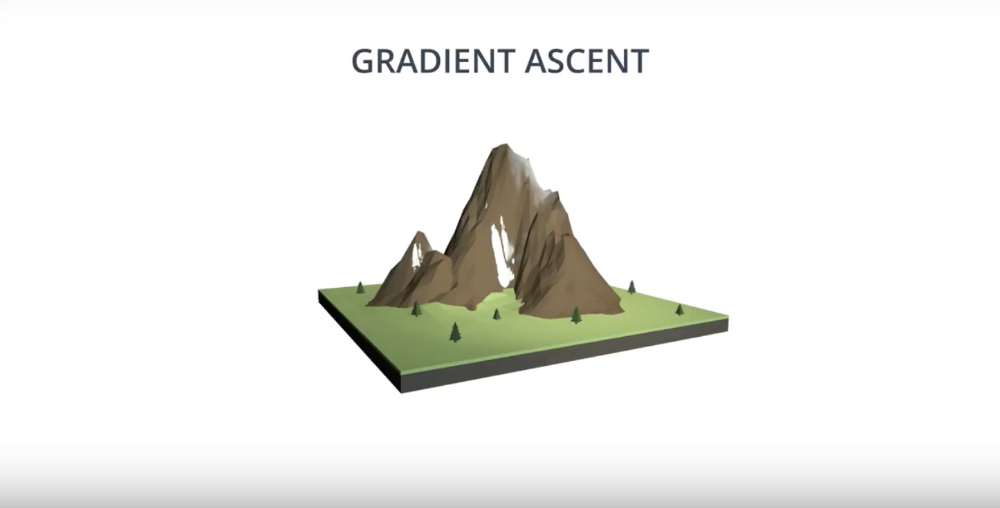

In [65]:
from IPython.display import Image
Image(filename='./images/3-2-5-2_reinforce_one_way_to_achieve_this_goal_is_gradient_ascent.jpeg')

## One way to do that is by Gradient Ascent, where we just iteratively take small steps in the direction of the gradient.

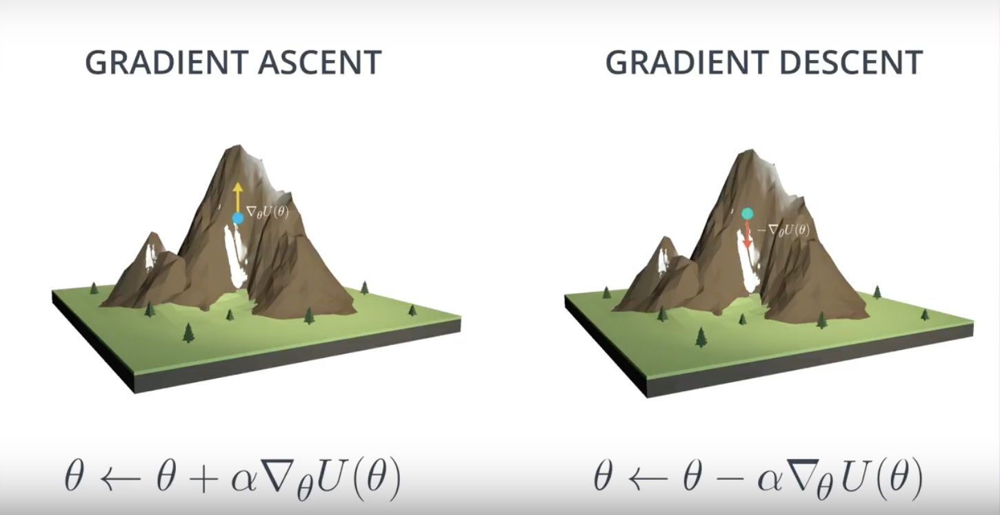

In [66]:
from IPython.display import Image
Image(filename='./images/3-2-5-3_reinforce_ga_vs_gd.jpeg')

## Remember that alpha is the step size and let it decay over time to avoid overshooting the target.

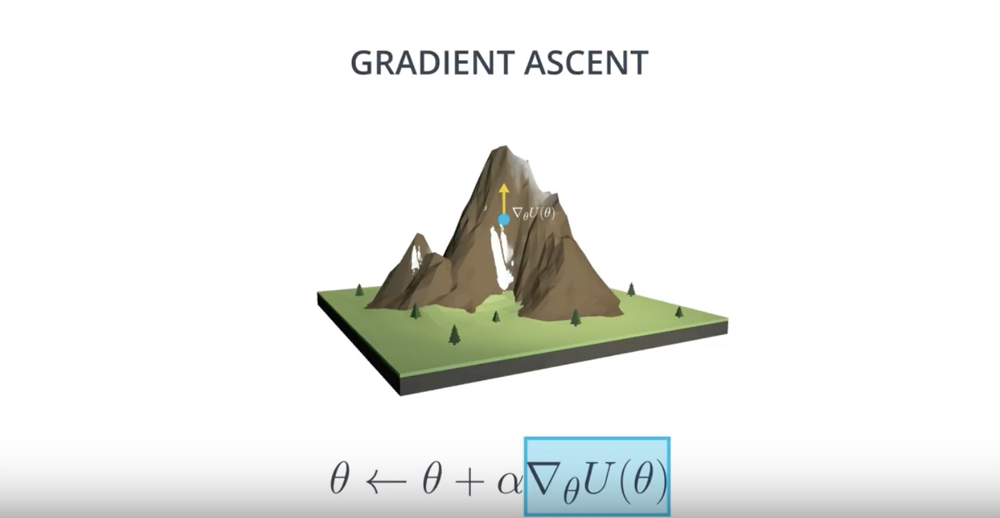

In [67]:
from IPython.display import Image
Image(filename='./images/3-2-5-4_reinforce_calculating_gradient_is_very_expensive.jpeg')

## We won't be able to calculate the exact value of the gradient since that is computationally too expensive.
## We'll have to consider every possible trajectory.

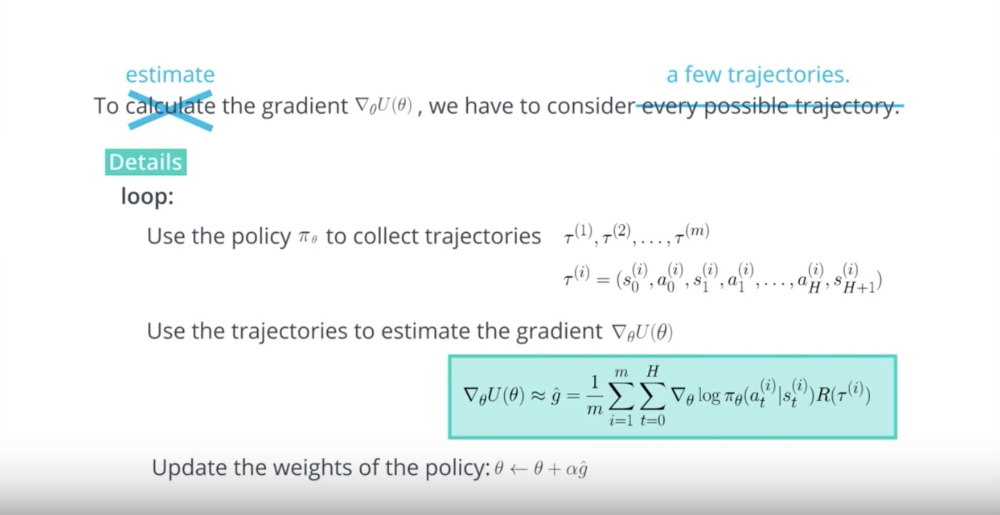

In [68]:
from IPython.display import Image
Image(filename='./images/3-2-5-5_reinforce_estimate_gradient_and_consider_a_few_trajectories.jpeg')

## Notation
### * We only consider a few trajectories. so we denote those by "Tau 1", "Tau 2", ..., "Tau M".
### * Remember that any trajectory is just a sequence of states and actions.
### * We denote estimated value from the "M trajectories" by "g hat".

## Once we have an estimate for the gradient, we can use it to update the weights of the policy.
## Then, we repeatdly loop over these steps to converge to the weights of the optimal policy.


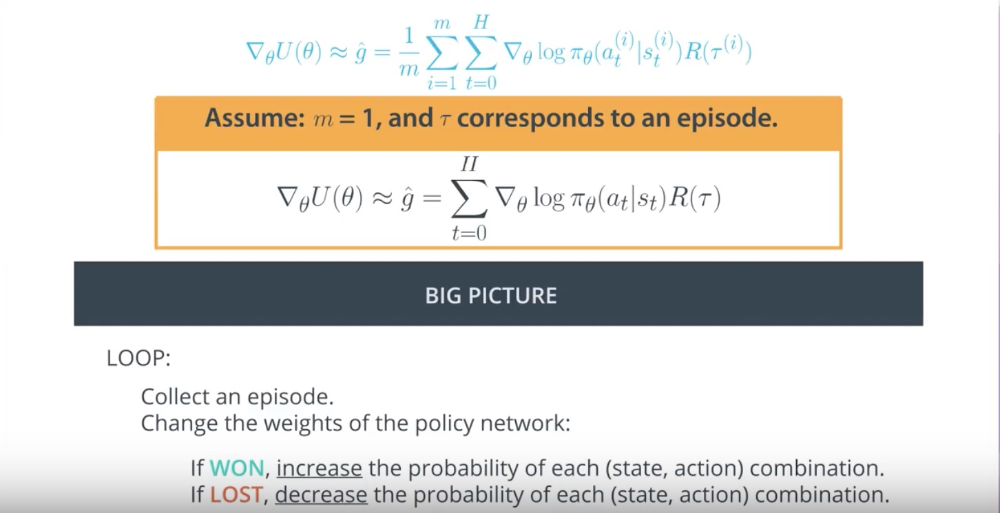

In [69]:
from IPython.display import Image
Image(filename='./images/3-2-5-6_reinforce_what_if_m_equals_one_trajectory.jpeg')

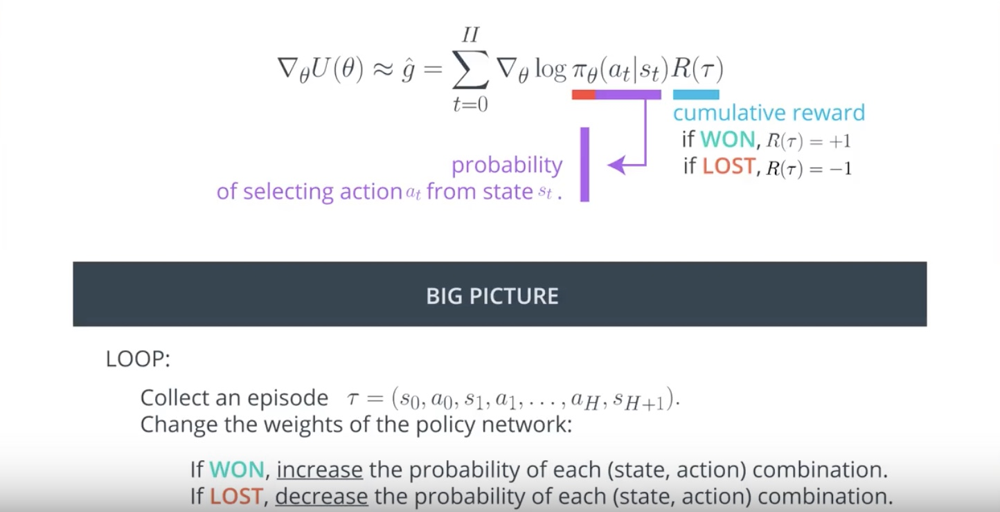

In [70]:
from IPython.display import Image
Image(filename='./images/3-2-5-7_reinforce_detailed_meaning_when_one_trajectory.jpeg')

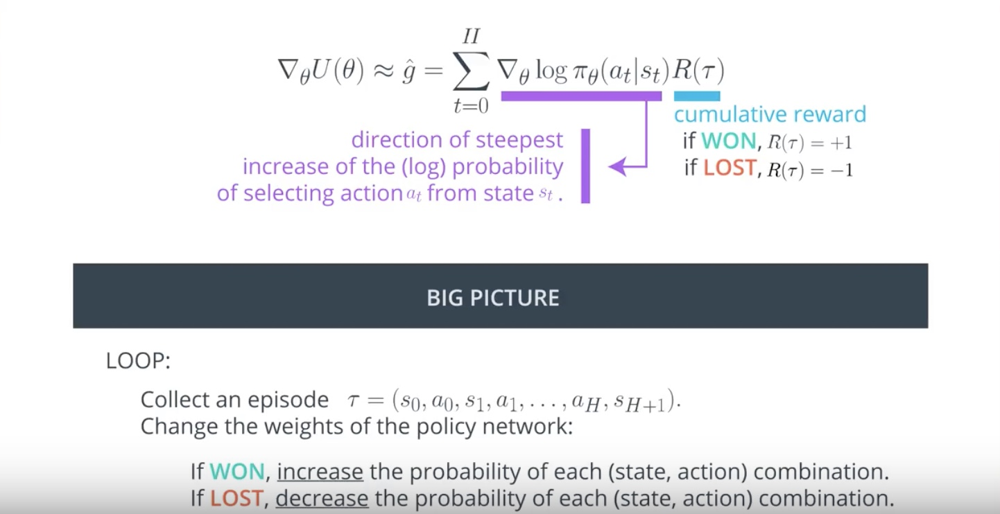

In [71]:
from IPython.display import Image
Image(filename='./images/3-2-5-8_reinforce_detailed_meaning_direction_of_steepest_increase_ot_the_probability.jpeg')

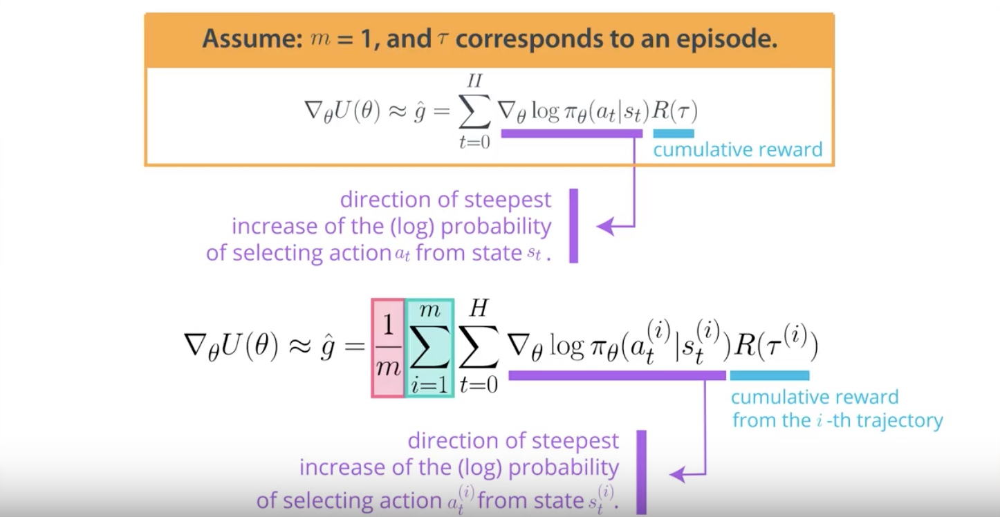

In [72]:
from IPython.display import Image
Image(filename='./images/3-2-5-9_reinforce_detailed_meaning_when_multiple_trajectories.jpeg')

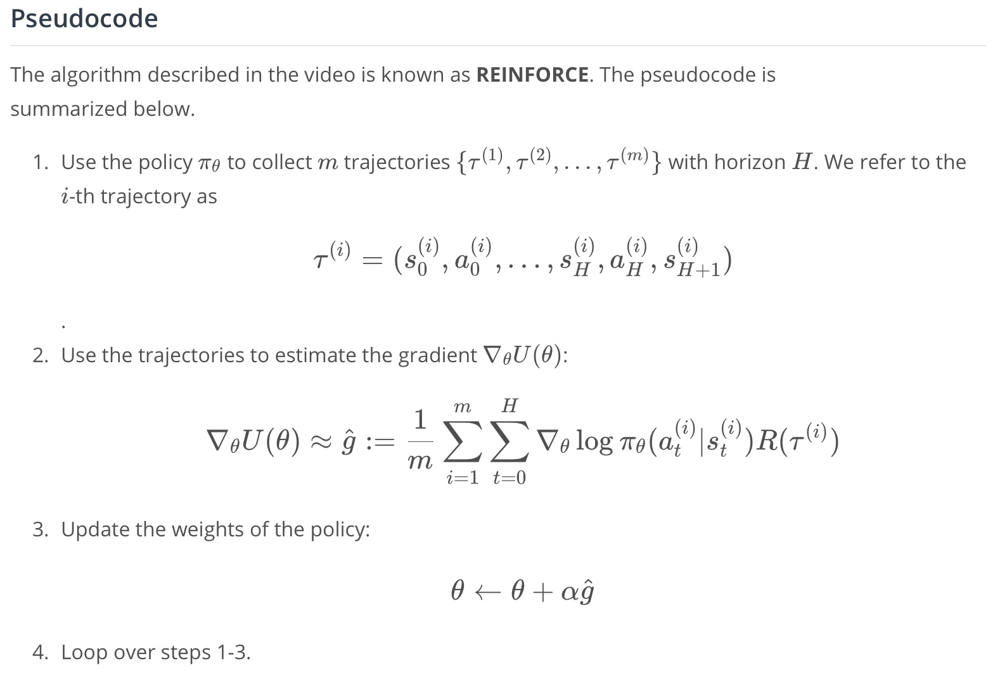

In [73]:
from IPython.display import Image
Image(filename='./images/3-2-5-10_reinforce_pseudocode.jpeg')

## 3-2-6 : REINFORCE Derivation of Gradient

how to derive the equation that we use to approximate the gradient

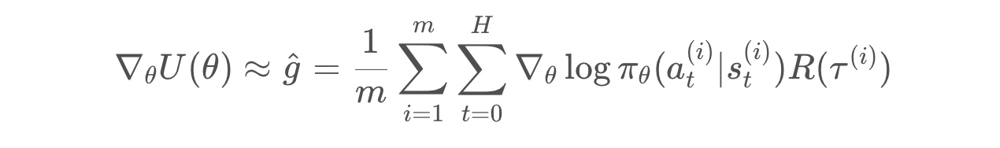

In [74]:
from IPython.display import Image
Image(filename='./images/3-2-6-1_reinforce_derivation_of_equation_that_aproximate_the_gradient.jpeg')

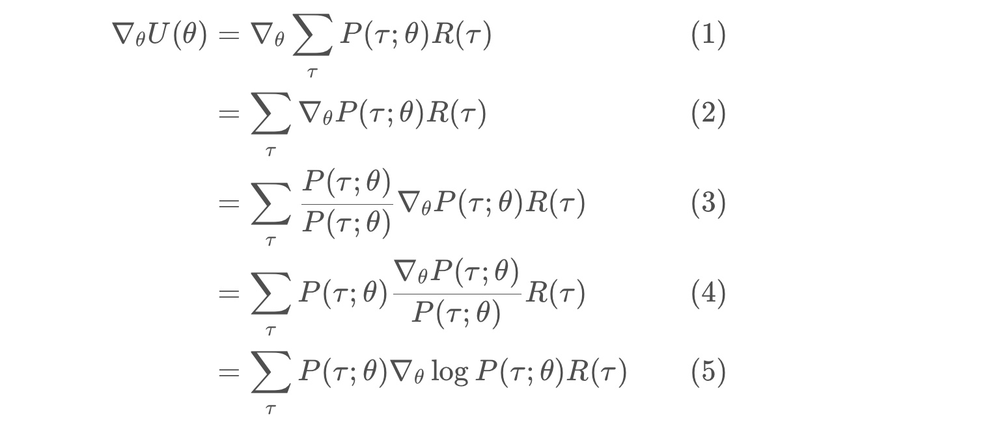

In [75]:
from IPython.display import Image
Image(filename='./images/3-2-6-2_reinforce_derivation_of_equation_likelihood_ratio_policy_gradient.jpeg')

## likelihood ratio policy gradient

### * line (5) follows from the chain rule, and the fact that the gradient of the log of a function is always equal to the gradient of the function, divided by the function. 
### * logP(τ;θ)= ∇θP(τ;θ) / P(τ;θ) is referred to as the likelihood ratio trick or REINFORCE trick

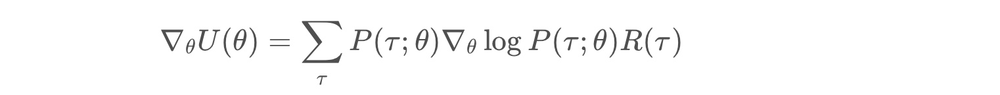

In [76]:
from IPython.display import Image
Image(filename='./images/3-2-6-3_reinforce_equation_likelihood_ratio_policy_gradient.jpeg')

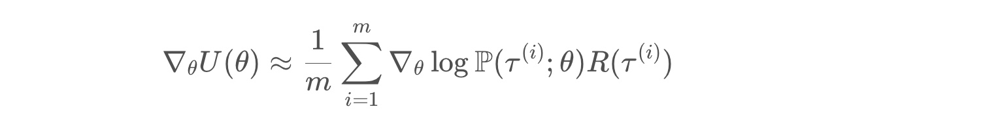

In [77]:
from IPython.display import Image
Image(filename='./images/3-2-6-4_reinforce_derivation_of_equation_sample_based_estimate.jpeg')

## likelihood ratio policy gradient with a sample-based average
### * each τ(i) is a sampled trajectory.

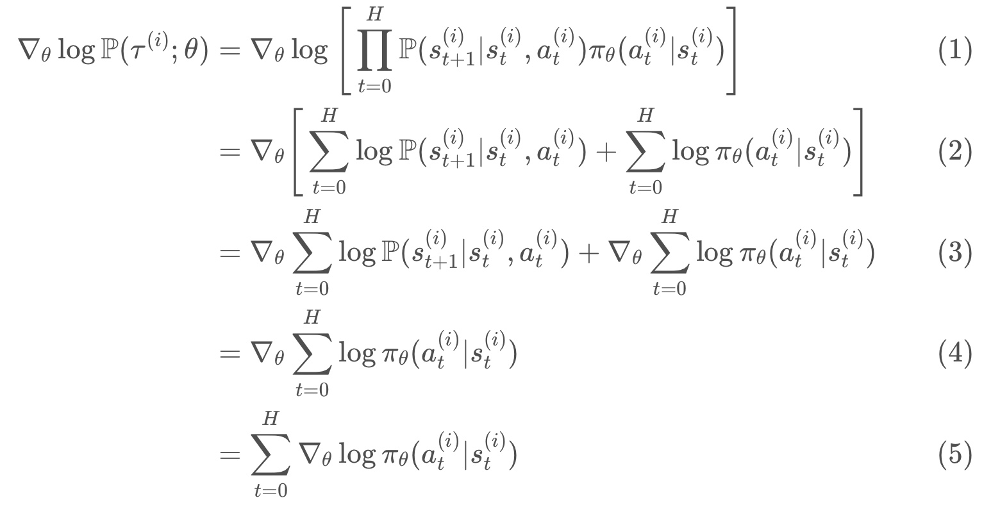

In [78]:
from IPython.display import Image
Image(filename='./images/3-2-6-5_reinforce_derivation_of_equation_simplify.jpeg')

## Simplify ∇θlogP(τ(i);θ)

### * line (1) shows how to calculate the probability of an arbitrary trajectory τ(i).
### * line (4) because "∇θ..." has no dependence on θ. "∇θ..." equation is 0.

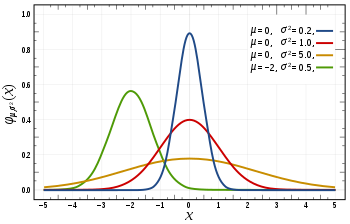

In [79]:
from IPython.display import Image
Image(filename='./images/3-2-6-6_reinforce_probility_density_function_correspoding_to_normal_distribution.png')

## What's Next?

#### - So far.. REINFORCE is used to solve a problem in discrete action space.
#### - REINFORCE can also be used to solve environments with continuous action spaces!
#### - For an environment with a continuous action space, the corresponding policy network could have an output layer that parametrizes a continuous probability distribution.
#### - For instance, assume the output layer returns the mean "μ" and variance "σ2" of a normal distribution.
#### - Then in order to select an action, the agent needs only to pass the most recent state "State" as input to the network, and then use the output mean "μ" and variance "σ2" to sample from the distribution "Action" ~ ∼N(μ,σ2).

## We will see the "Small modification to the REINFORCE algorithm"

# Lesson 3-3: Proximal Policy Optimization

One of these key improvements is called Proximal Policy Optimization (PPO) -- also closely related to Trust Region Policy Optimization (TRPO). It has allowed faster and more stable learning. From developing agile robots, to creating expert level gaming AI, PPO has proven useful in a wide domain of applications, and has become part of the standard toolkits in complicated learning environments.

* REINFORCE problems and issues
* Solutions for REINFORCE problems will lead us to PPO.

### The idea of PPO was published by the team at OpenAI, and you can read their paper through this [link] {https://arxiv.org/abs/1707.06347}.

## 3-3-1 : Beyond REINFORCE

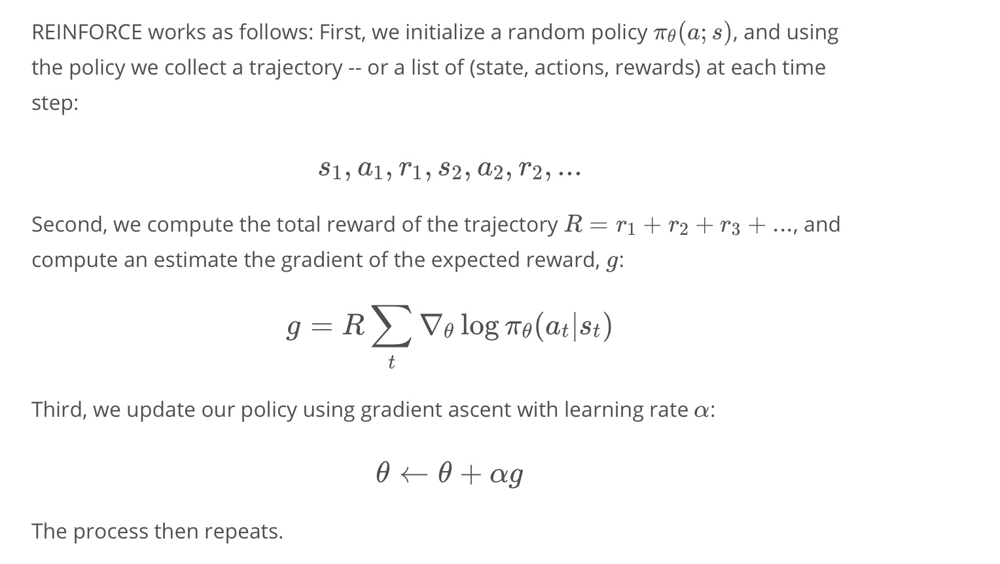

In [80]:
from IPython.display import Image
Image(filename='./images/3-3-1-1_beyond_reinforce_review_reinforce.jpeg')

##  Main problems of REINFORCE

### 1. The update process is very inefficient! We run the policy once, update once, and then throw away the trajectory.
### 2. The gradient estimate g is very noisy. By chance the collected trajectory may not be representative of the policy.
### 3. There is no clear credit assignment. A trajectory may contain many good/bad actions and whether these actions are reinforced depends only on the final total output.

## 3-3-2 : Noise Reduction

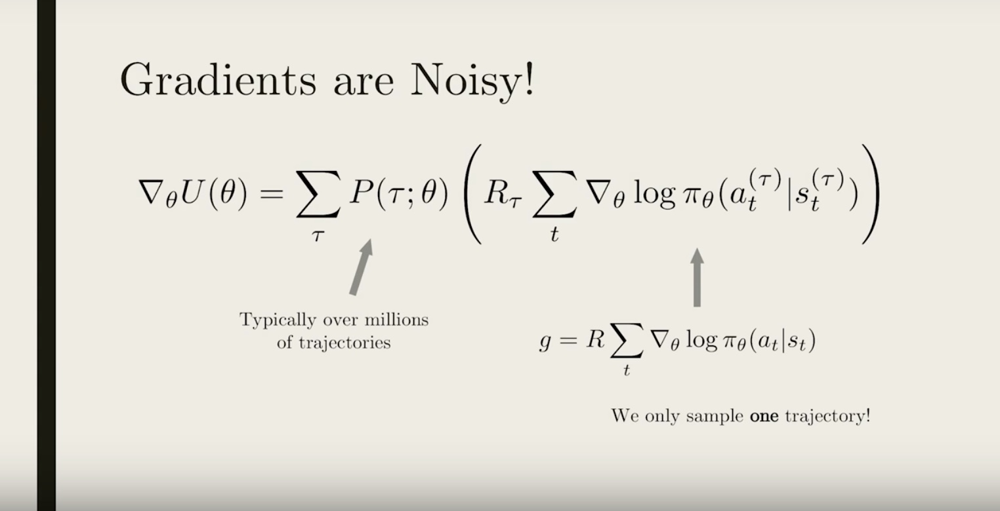

In [81]:
from IPython.display import Image
Image(filename='./images/3-3-2-1_noise_reduction_sampled_trajectories_do_not_contain_that_much_information_about_our_policy_because_of_random_noise.jpeg')

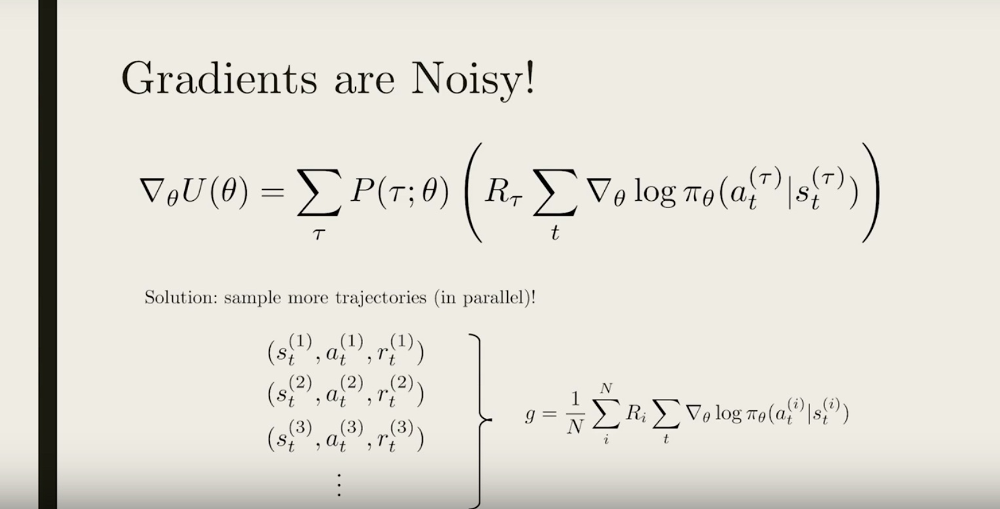

In [82]:
from IPython.display import Image
Image(filename='./images/3-3-2-2_noise_reduction_easiet_option_to_reduce_noise_is_simply_sample_more_trajectories.jpeg')

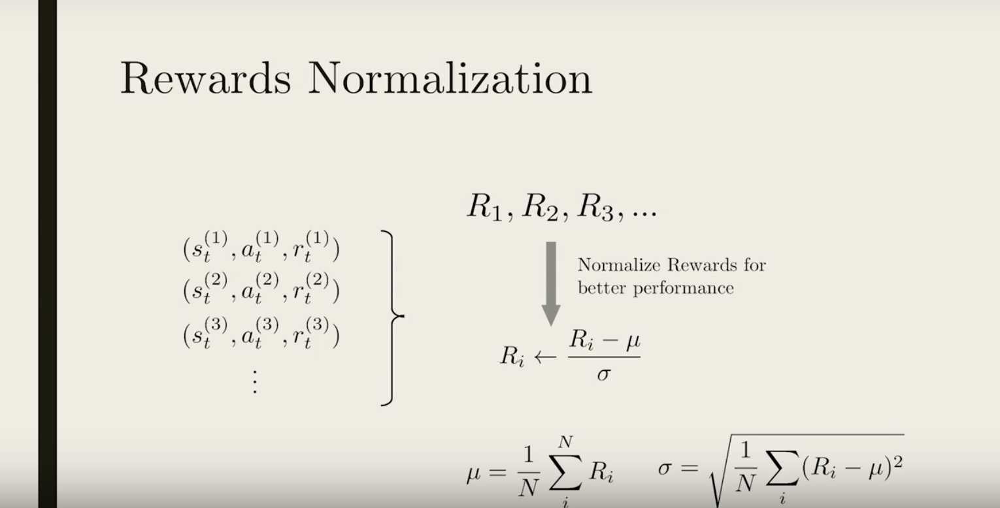

In [83]:
from IPython.display import Image
Image(filename='./images/3-3-2-3_noise_reduction_another_option_is_reward_normalization.jpeg')

## Reward Normalization

### - Running multiple trajectories: we can collect all the total rewards and get a sense of how they are distributed.
### - In many cases, the distribution of rewards shifts as learning happens. Reward = 1 might be really good in the beginning, but really bad after 1000 training episode.
### - This batch-normalization technique is also used in many other problems in AI (e.g. image classification), where normalizing the input can improve learning.
### - Intuitively, normalizing the rewards roughly corresponds to picking half the actions to encourage/discourage, while also making sure the steps for gradient ascents are not too large/small.

## 3-3-3 : Credit Assignment

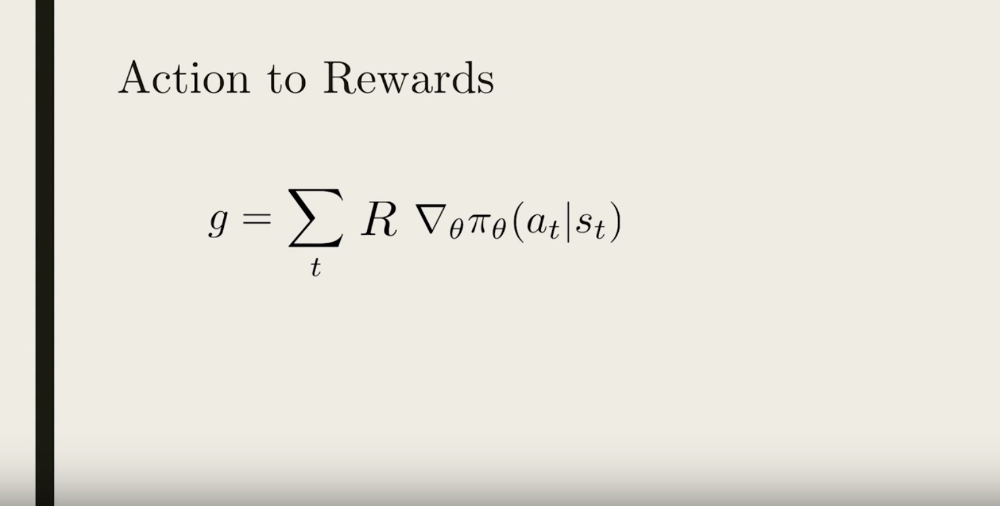

In [84]:
from IPython.display import Image
Image(filename='./images/3-3-3-1_credit_assignment_take_closer_look_at_the_total_reward_r.jpeg')

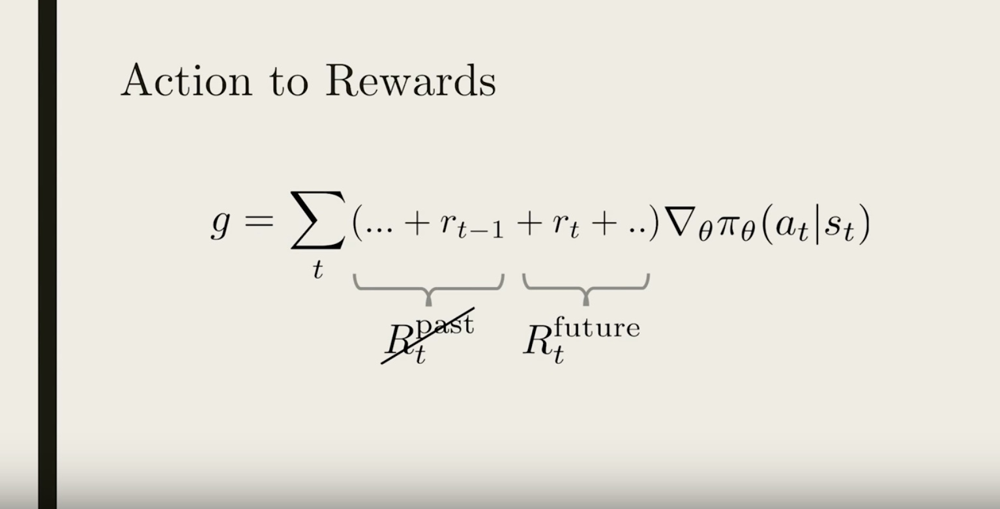

In [85]:
from IPython.display import Image
Image(filename='./images/3-3-3-2_credit_assignment_past_rewards_do_not_affect_to_current_action_we_assign_credit_to_current_action.jpeg')

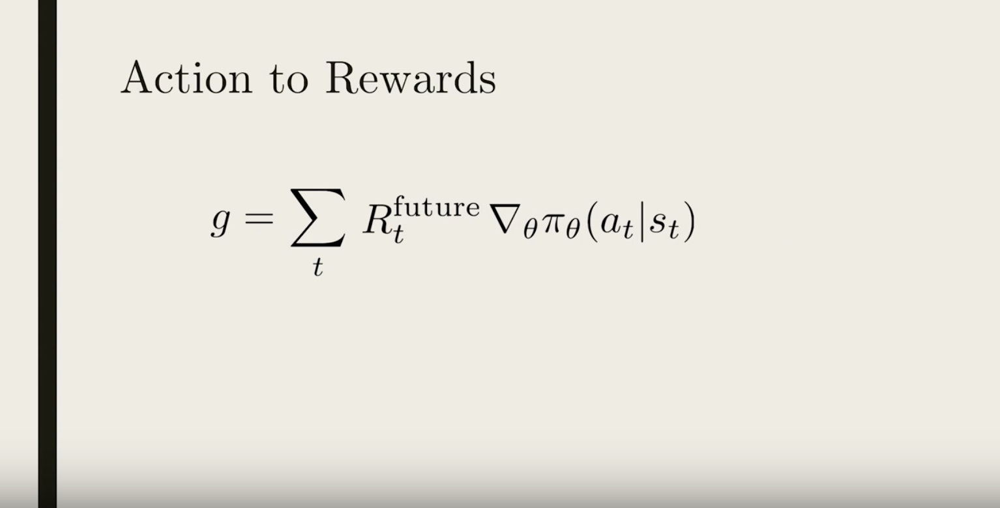

In [86]:
from IPython.display import Image
Image(filename='./images/3-3-3-3_credit_assignment_simply_have_the_future_reward_as_the_coefficient.jpeg')

## Because we have a Markov process, the action at time-step t can only affect the future reward, so the past reward shouldn’t be contributing to the policy gradient. So to properly assign credit to the action "a", we should ignore the past reward. So a better policy gradient would simply have the future reward as the coefficient .

## Gradient Modification

### Question is..."why is it okay to just change our gradient? Wouldn't that change our original goal of maximizing the expected reward?"

### It turns out that mathematically, ignoring past rewards might change the gradient for each specific trajectory, but it doesn't change the averaged gradient.

### So even though the gradient is different during training, on average we are still maximizing the average reward.

## In fact, the resultant gradient is less noisy, so training using future reward should speed things up!

## Quiz

Suppose we are training an agent to play a computer game. There are only two possible action:

- 0 = Do nothing, 1 = Move

There are three time-steps in each game, and our policy is completely determined by one parameter θ, such that the probability of "moving" is θ, and the probability of doing nothing is 1−θ.

Initially θ=0.5. Three games are played, the results are:

- Game 1: actions: (1,0,1) rewards: (1,0,1)
- Game 2: actions: (1,0,0) rewards: (0,0,1)
- Game 3: actions: (0,1,0) rewards: (1,0,1)

### Question 1
What are the future rewards for the first game?

1. (1,0,1)
2. (1,0,2)
3. (2,0,1)
4. (2,1,1)
5. (1,1,2)

### Questin 2
What is the policy gradient computed from the second game, using future rewards?

1. -2
2. -1
3. 0
4. 1
5. 2

### Question 3
Which of these statements are true regarding the 3rd game?

1. We can add a baseline -1 point to the rewards, the computed tradient wouldn't change.
2. The contribution to the gradient from the second and third steps cancel each other.
3. The computed policy gradient from this game is 0.
4. The computed policy gradient from this game is negative.
5. Using the total reward vs future reward give the same policy gradient in this game.

## 3-3-4 : Importance Sampling

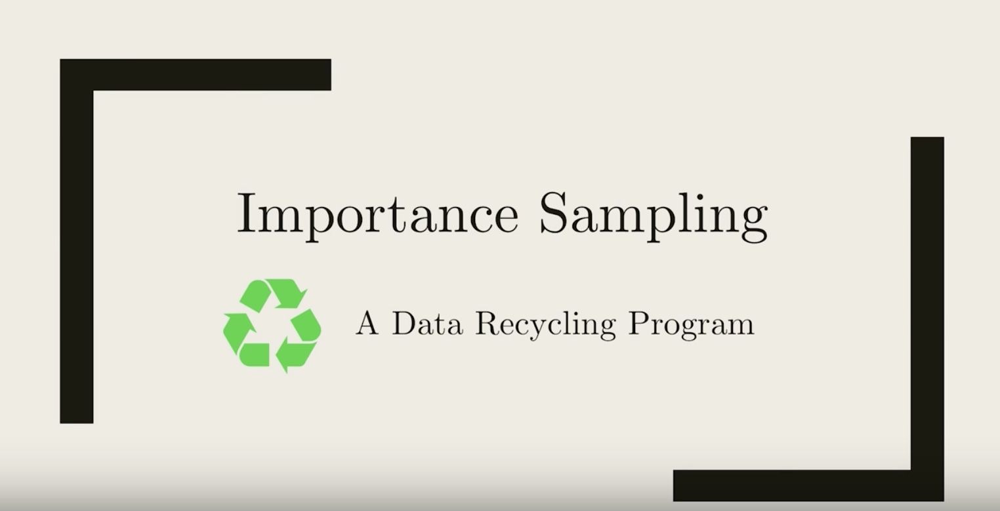

In [87]:
from IPython.display import Image
Image(filename='./images/3-3-4-1_importance_sampling_data_recycling.jpeg')

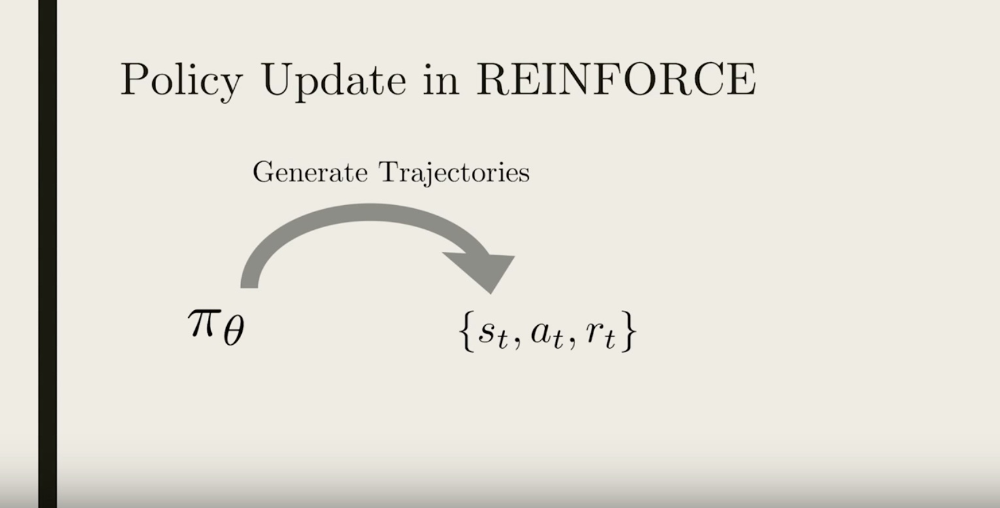

In [88]:
from IPython.display import Image
Image(filename='./images/3-3-4-2_importance_sampling_generate_trajectory_with_policy_pi_theta.jpeg')

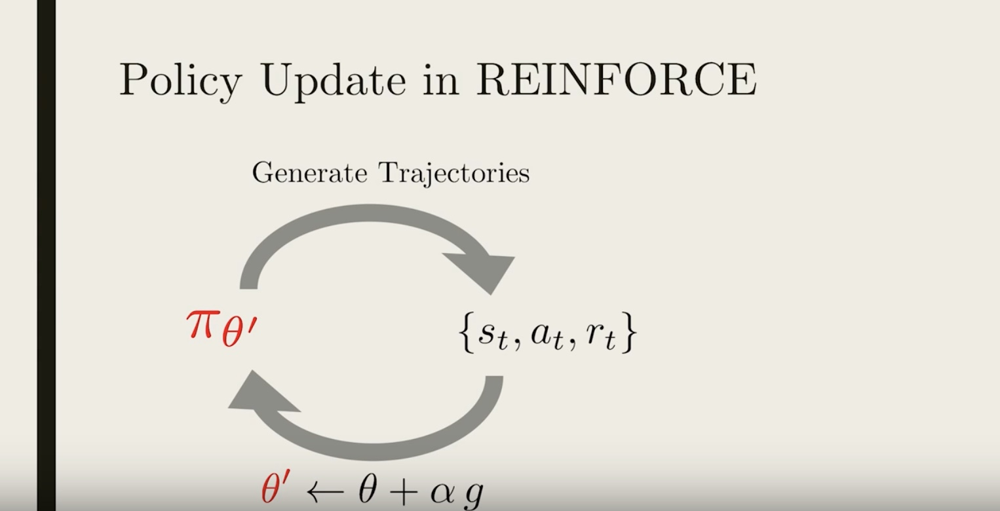

In [89]:
from IPython.display import Image
Image(filename='./images/3-3-4-3_importance_sampling_compute_policy_gradient_and_update_theta_to_theta_prime.jpeg')

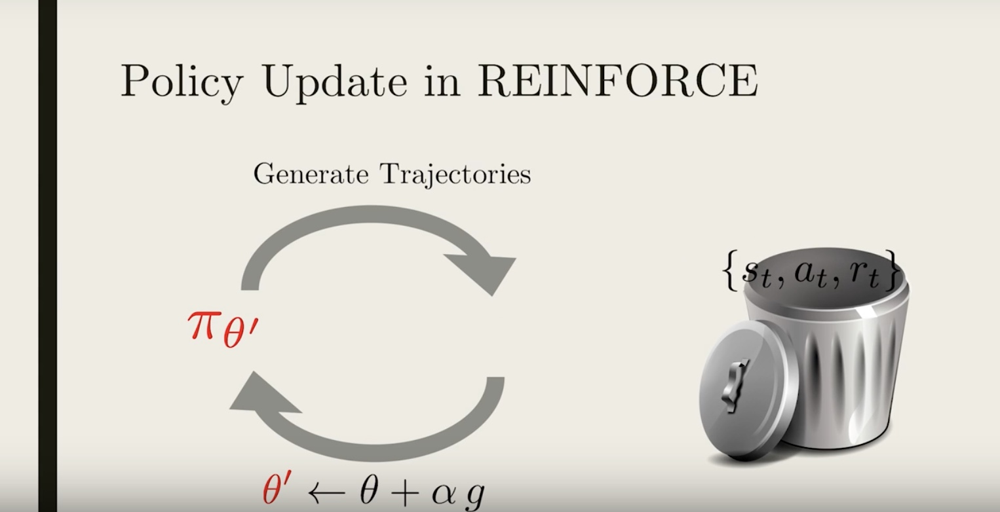

In [90]:
from IPython.display import Image
Image(filename='./images/3-3-4-4_importance_sampling_throw_away_just_generated_trajectory.jpeg')

## If we want to update our policy again, we would need to generate new trajectories once more, using the updated policy.

## You might ask, why is all this necessary? It’s because we need to compute the gradient for the current policy, and to do that the trajectories need to be representative of the current policy.

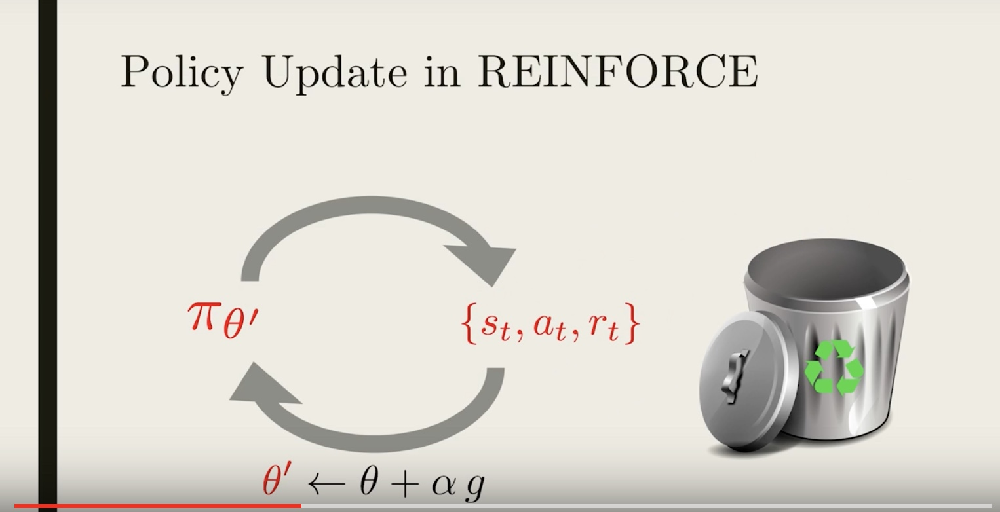

In [91]:
from IPython.display import Image
Image(filename='./images/3-3-4-5_importance_sampling_recycle_the_old_trajectories.jpeg')

## What if we could somehow recycle the old trajectories, by modifying them so that they are representative of the new policy? So that instead of just throwing them away, we recycle them!

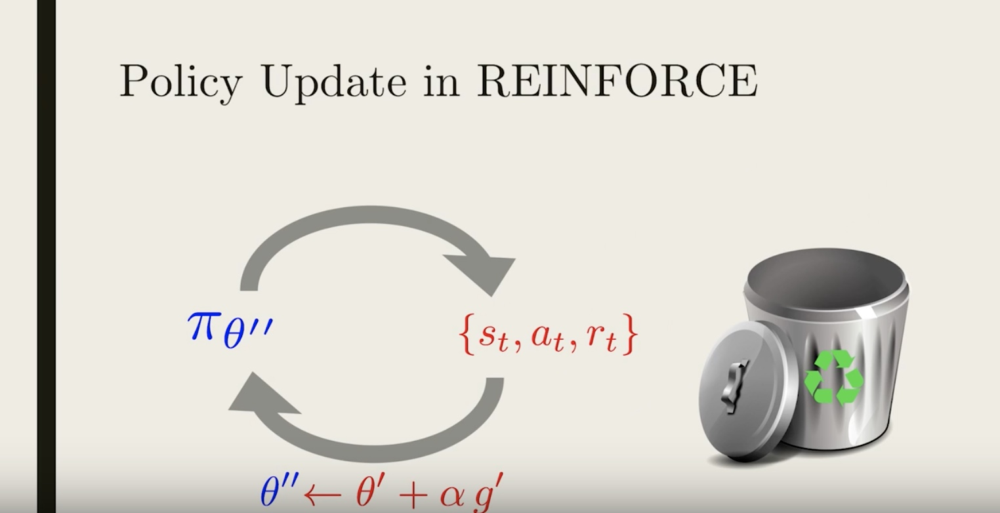

In [92]:
from IPython.display import Image
Image(filename='./images/3-3-4-6_importance_sampling_reuse_the_recycled_trajectories_to_compute_gradients_and_update_policy.jpeg')

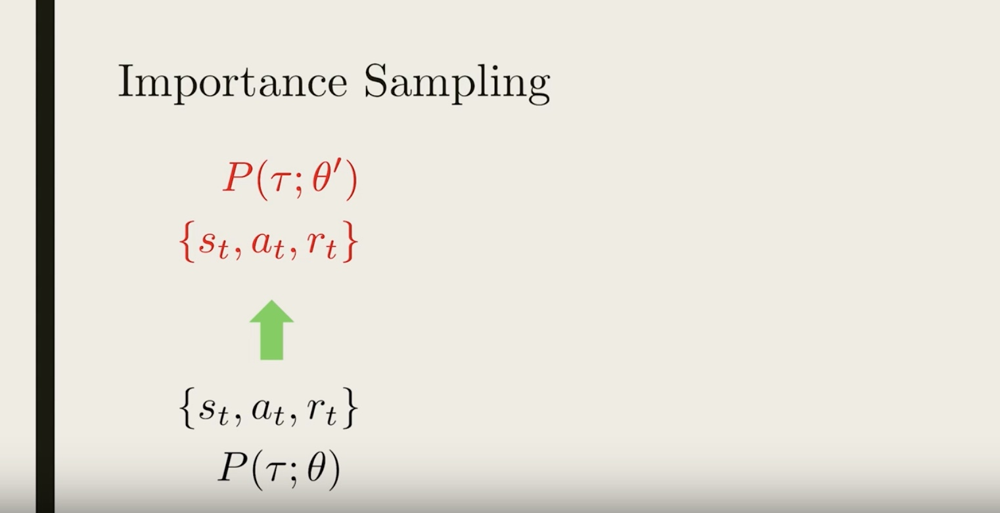

In [93]:
from IPython.display import Image
Image(filename='./images/3-3-4-7_importance_sampling_generated_using_the_policy_pi_theta_is_same_trajectory_by_new_policy_different_probability.jpeg')

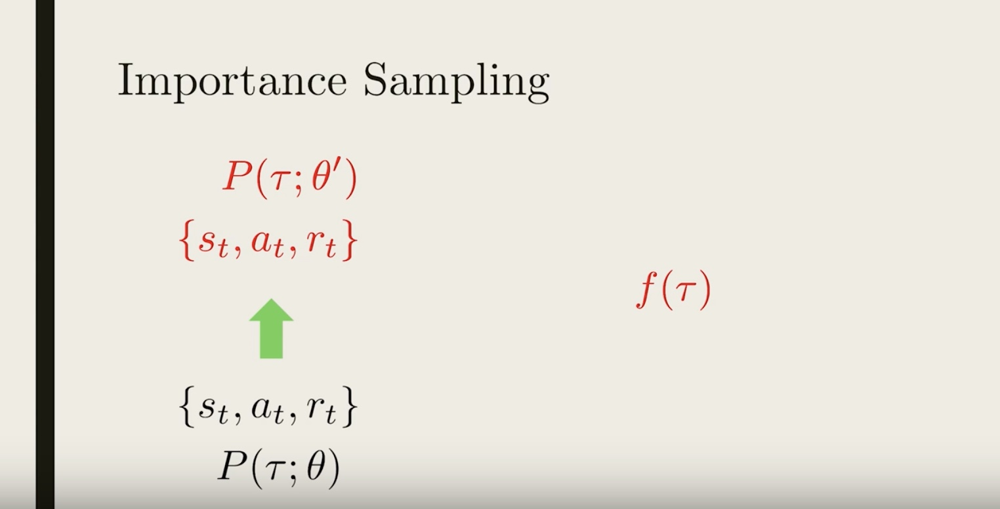

In [94]:
from IPython.display import Image
Image(filename='./images/3-3-4-8_importance_sampling_we_want_compute_the_average_of_some_quantity_say_f_of_Tau.jpeg')

## Imagine we want to compute the average of some quantity, say f(τ). We could simply generate trajectories from the new policy, compute f(τ) and average them.

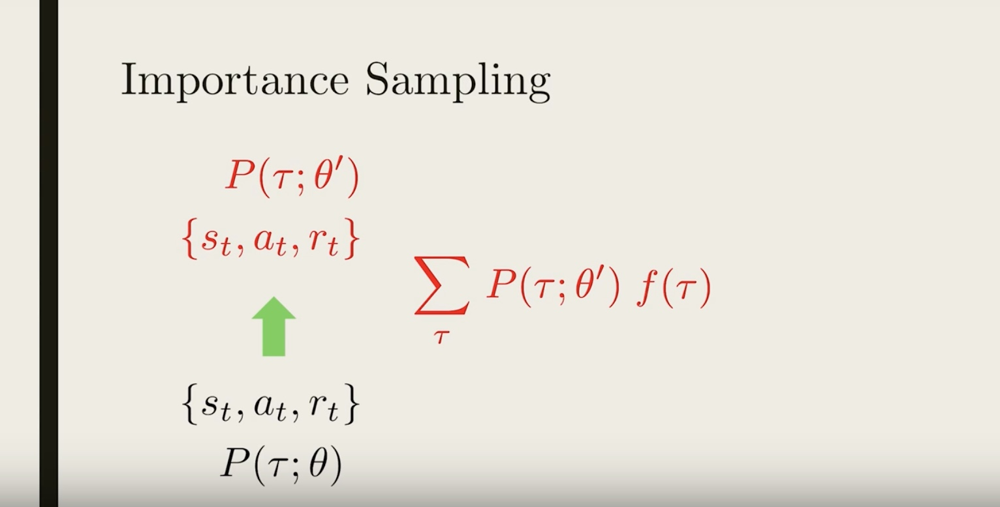

In [95]:
from IPython.display import Image
Image(filename='./images/3-3-4-9_importance_sampling_weighted_by_a_probability_of_sampling_each_trajectory.jpeg')

## Mathematically, this is equivalent to adding up all the f(τ), weighted by a probability of sampling each trajectory under the new policy.

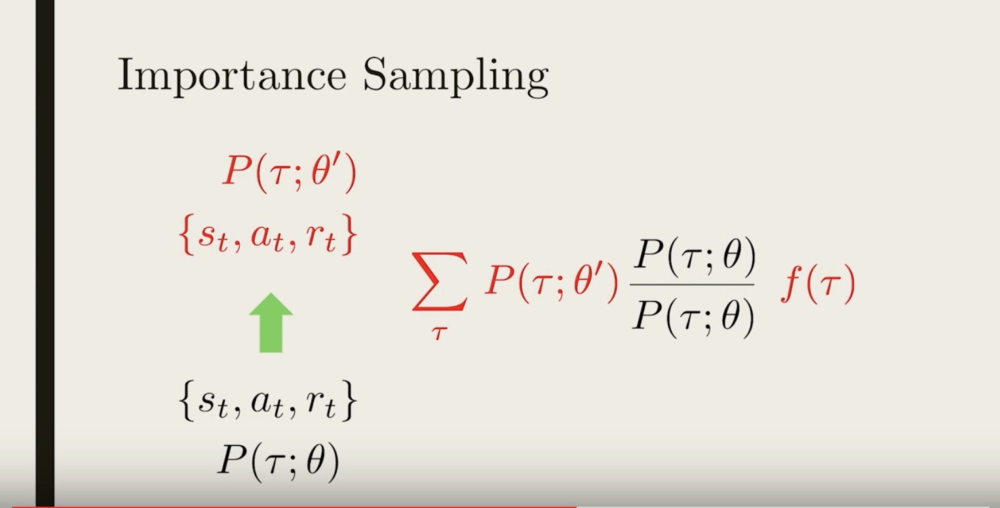

In [96]:
from IPython.display import Image
Image(filename='./images/3-3-4-10_multiplying_and_dividing_by_the_same_number_P(τ;θ).jpeg')

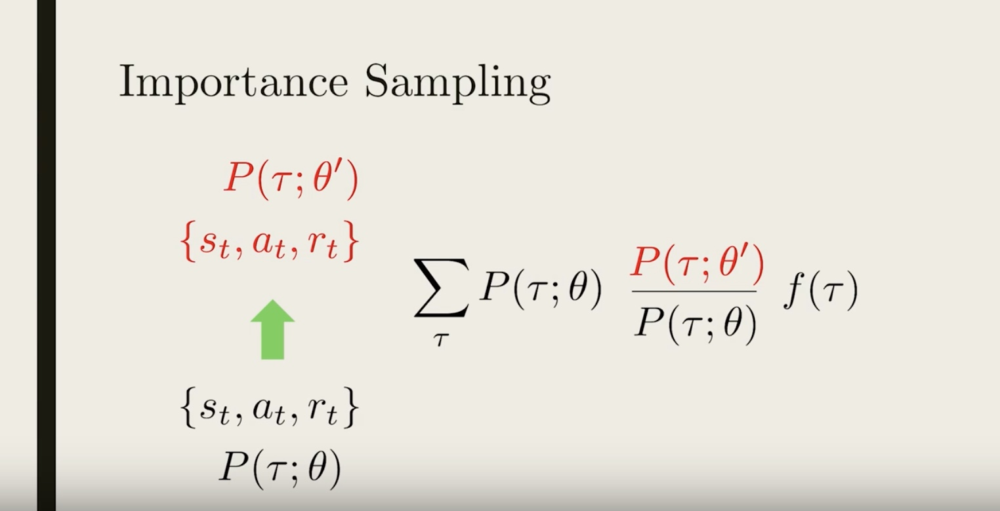

In [97]:
from IPython.display import Image
Image(filename='./images/3-3-4-11_importance_sampling_rearrange_the_terms.jpeg')

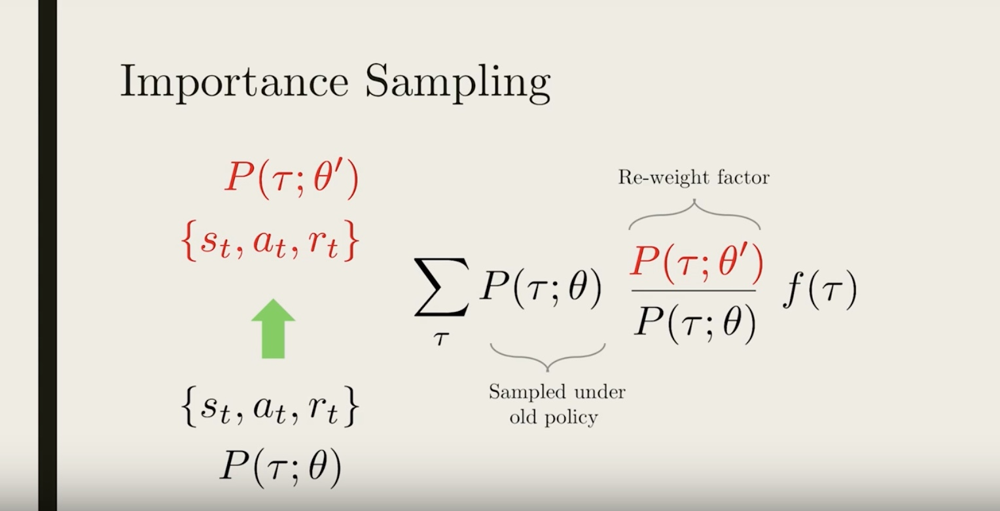

In [98]:
from IPython.display import Image
Image(filename='./images/3-3-4-12_importance_sampling_under_the_old_policy_and_extra_re-weighting_factor_in_addition_to_just_averaging.jpeg')

## Intuitively, this tells us we can use old trajectories for computing averages for new policy, as long as we add this extra re-weighting factor, that takes into account how under or over–represented each trajectory is under the new policy compared to the old one.
## The same tricks are used frequently across statistics, where the re-weighting factor is included to un-bias surveys and voting predictions.

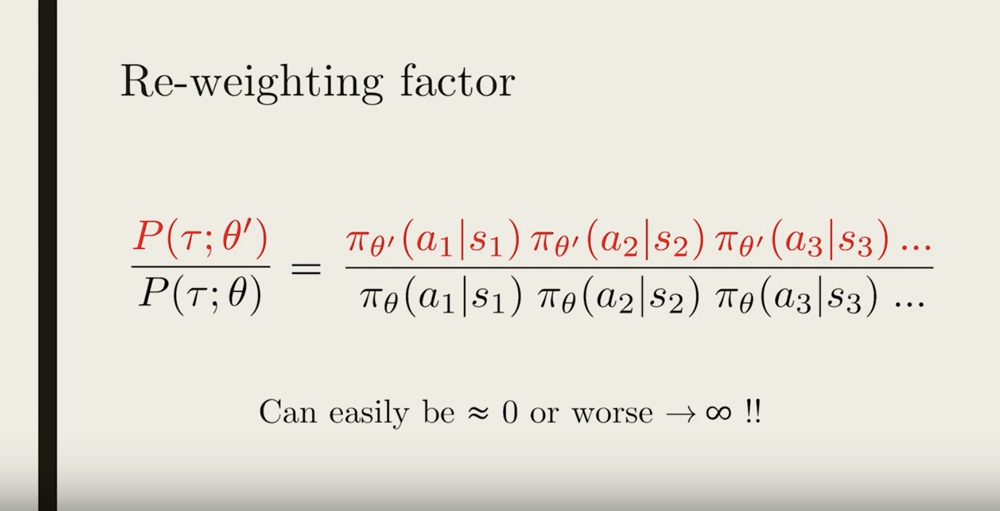

In [99]:
from IPython.display import Image
Image(filename='./images/3-3-4-13_importance_sampling_re-weighting_factor.jpeg')

## Because each trajectory contains many steps, the probability contains a chain of products of each policy at different time-step.

## This formula is a bit complicated. But there is a bigger problem. When some of policy gets close to zero, the re-weighting factor can become close to zero, or worse, close to 1 over 0 which diverges to infinity.

## When this happens, the re-weighting trick becomes unreliable. So, In practice, we want to make sure the re-weighting factor is not too far from 1 when we utilize importance sampling

## 3-3-5 : PPO Part 1: The Surrogate Function

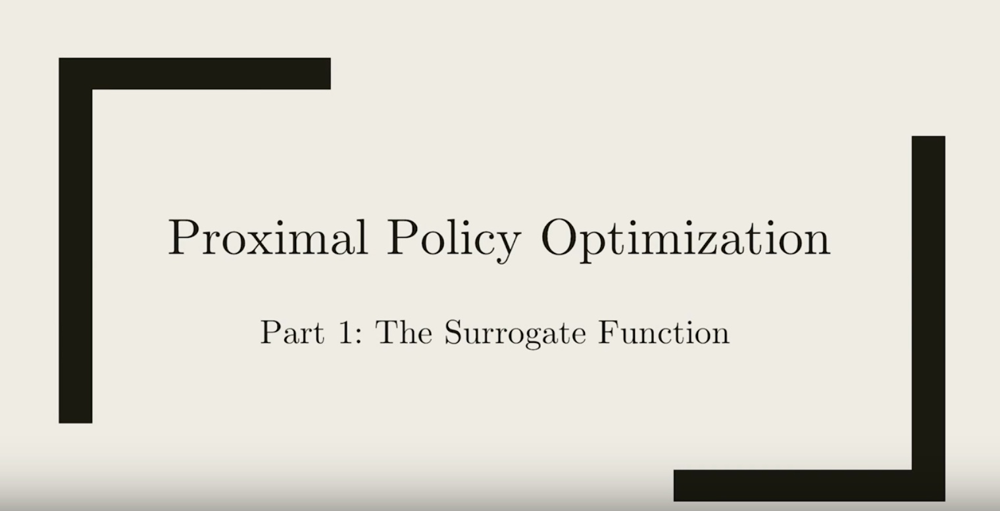

In [100]:
from IPython.display import Image
Image(filename='./images/3-3-5-1_ppo_surrogate_function.jpeg')

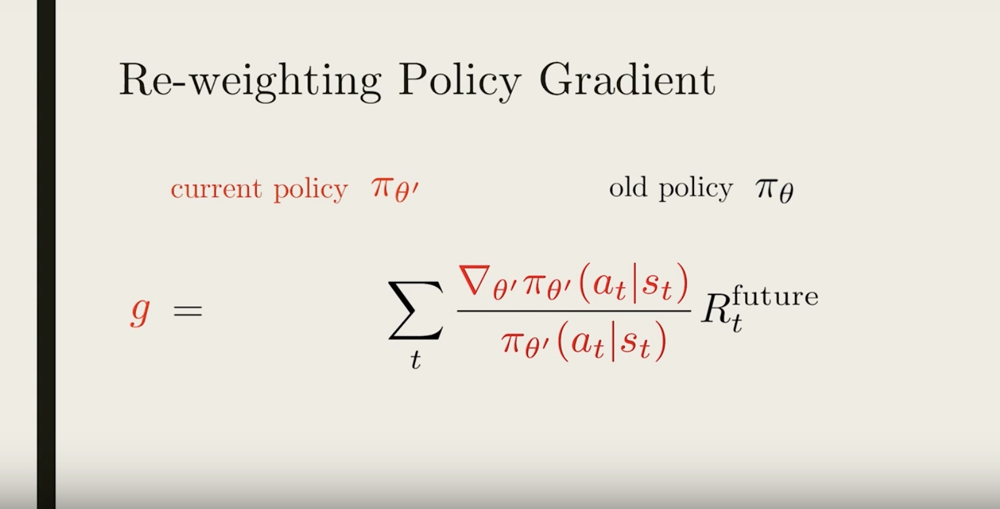

In [101]:
from IPython.display import Image
Image(filename='./images/3-3-5-2_ppo_surrogate_function_re-weighining_pg_which_is_applied_reward_normalization_and_credit_assignment.jpeg')

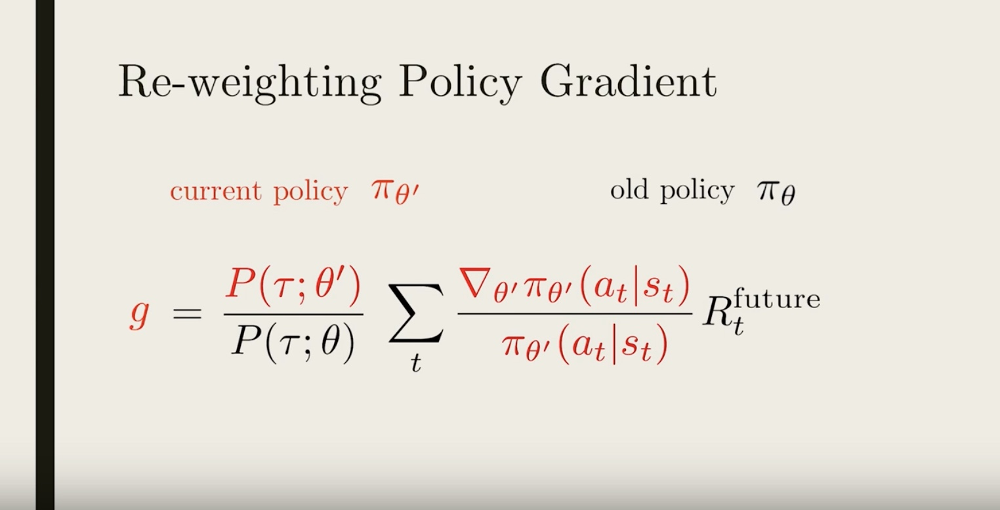

In [102]:
from IPython.display import Image
Image(filename='./images/3-3-5-3_ppo_surrogate_function_times_a_re-weighting_factor.jpeg')

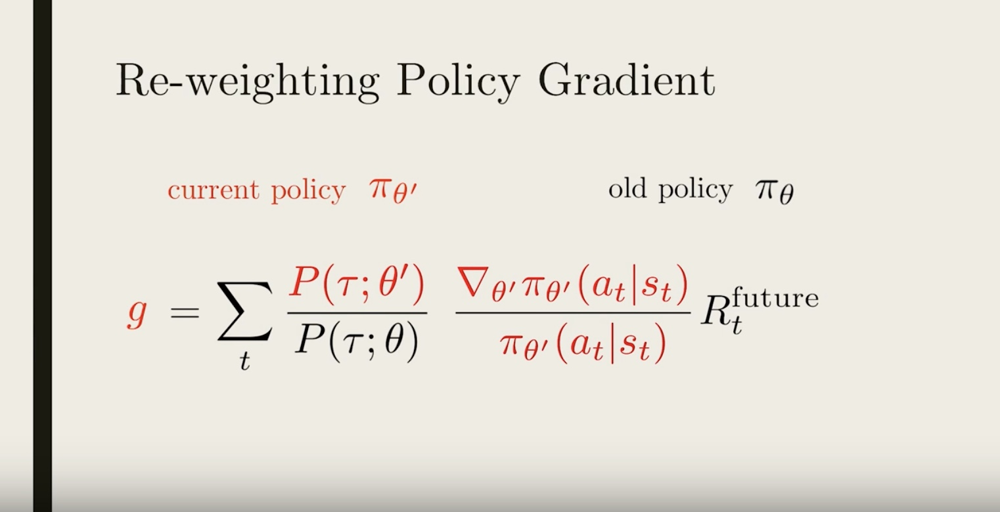

In [103]:
from IPython.display import Image
Image(filename='./images/3-3-5-4_ppo_surrogate_function_rearrange_equation.jpeg')

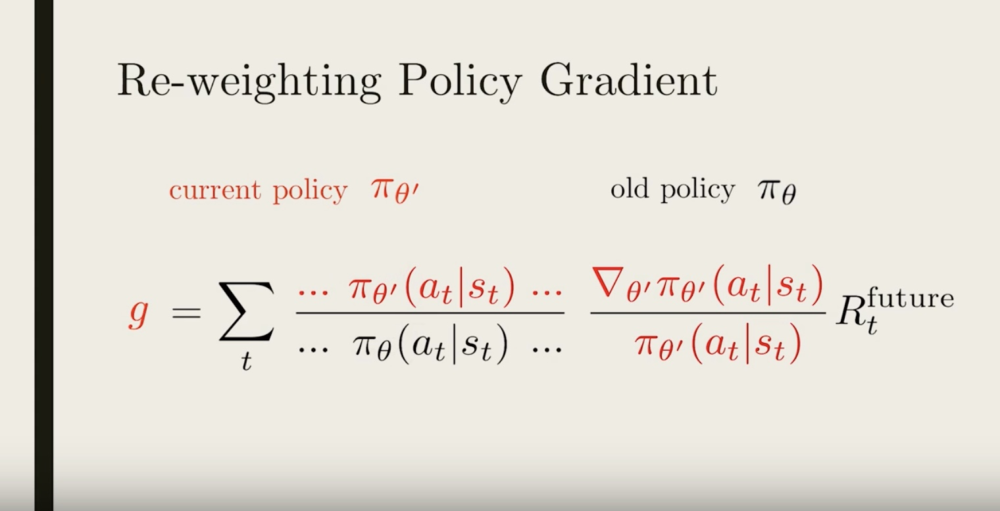

In [104]:
from IPython.display import Image
Image(filename='./images/3-3-5-5_ppo_surrogate_function_re-weighting_factor_is_ust_the_product_of_all_the_policy_across_each_step.jpeg')

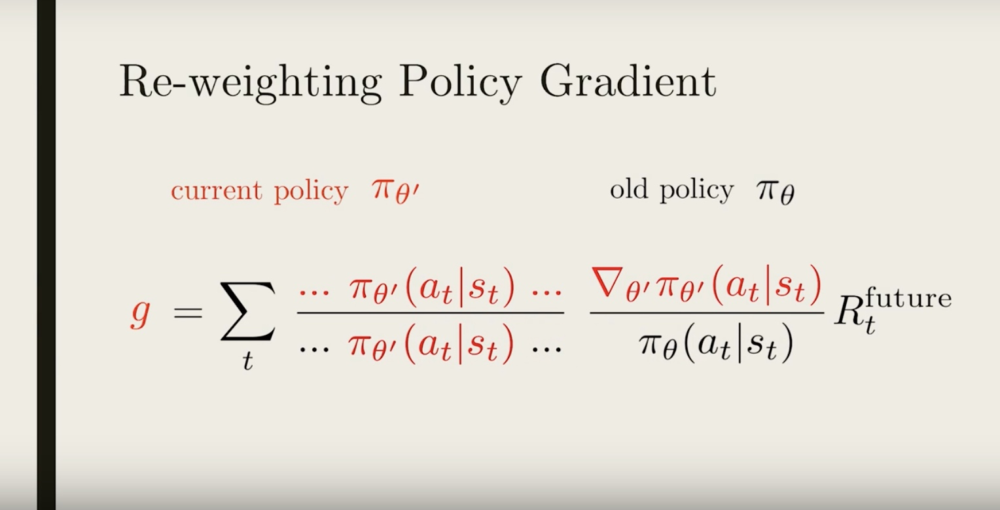

In [105]:
from IPython.display import Image
Image(filename='./images/3-3-5-6_ppo_surrogate_function_rearrange_equation_again.jpeg')

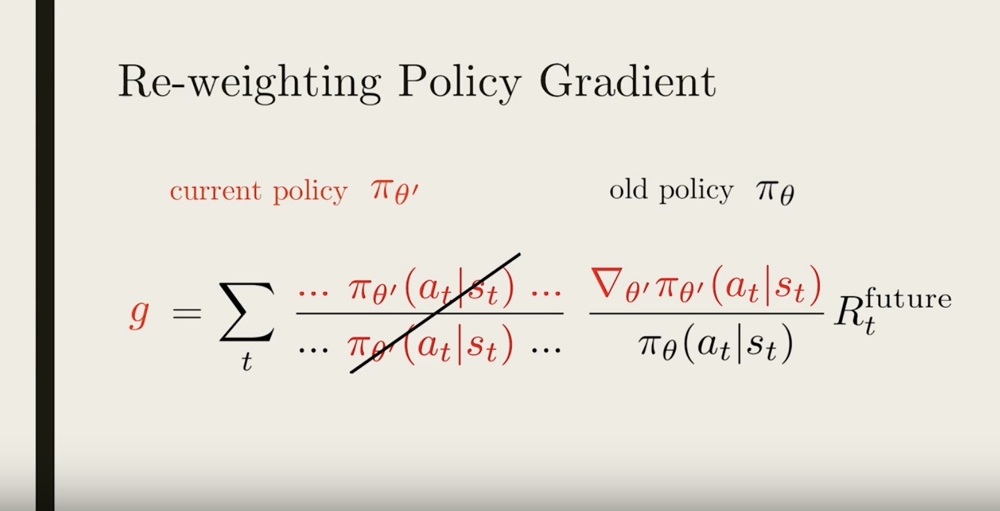

In [106]:
from IPython.display import Image
Image(filename='./images/3-3-5-7_ppo_surrogate_function_cancel_some_terms.jpeg')

## This is where proximal policy comes in. If the old and current policy is close enough to each other, all the factors inside the "..." would be pretty close to 1, and then we can ignore them.

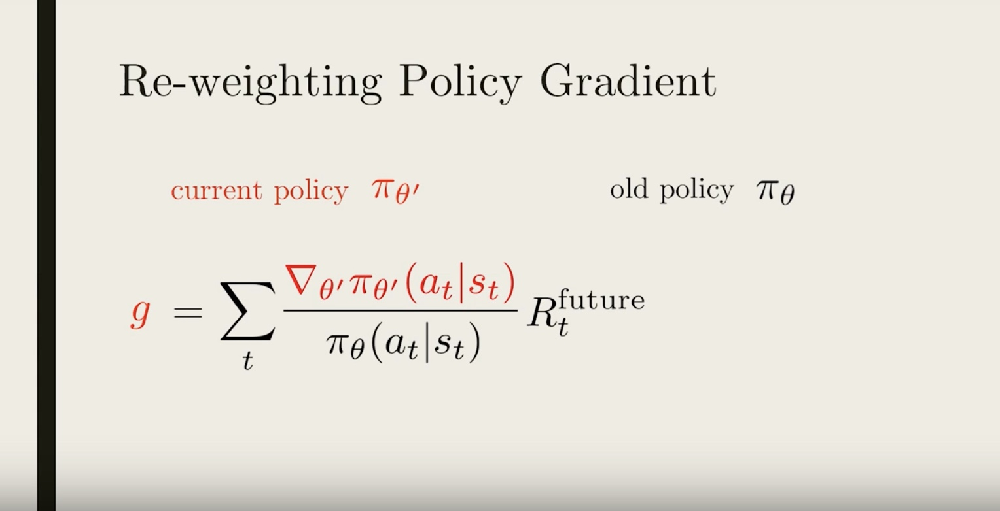

In [107]:
from IPython.display import Image
Image(filename='./images/3-3-5-8_ppo_surrogate_function_equation_simplified.jpeg')

## It looks very similar to the old policy gradient. In fact, if the current policy and the old policy is the same, we would have exactly the vanilla policy gradient. But remember, this expression is different because we are comparing two different policies

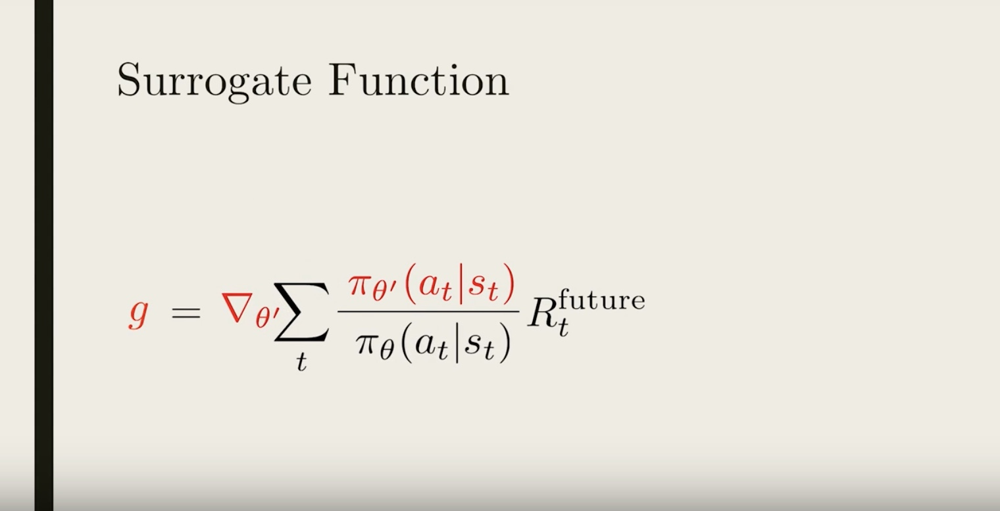

In [108]:
from IPython.display import Image
Image(filename='./images/3-3-5-9_ppo_surrogate_function_equation_rearranged.jpeg')

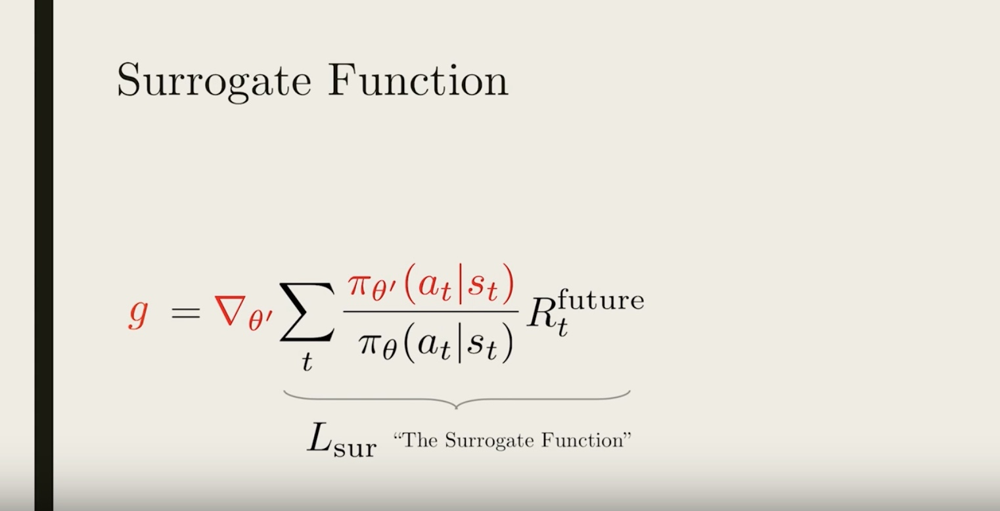

In [109]:
from IPython.display import Image
Image(filename='./images/3-3-5-10_ppo_surrogate_function_now_we_have_the_approximate_form_of_the_gradient.jpeg')

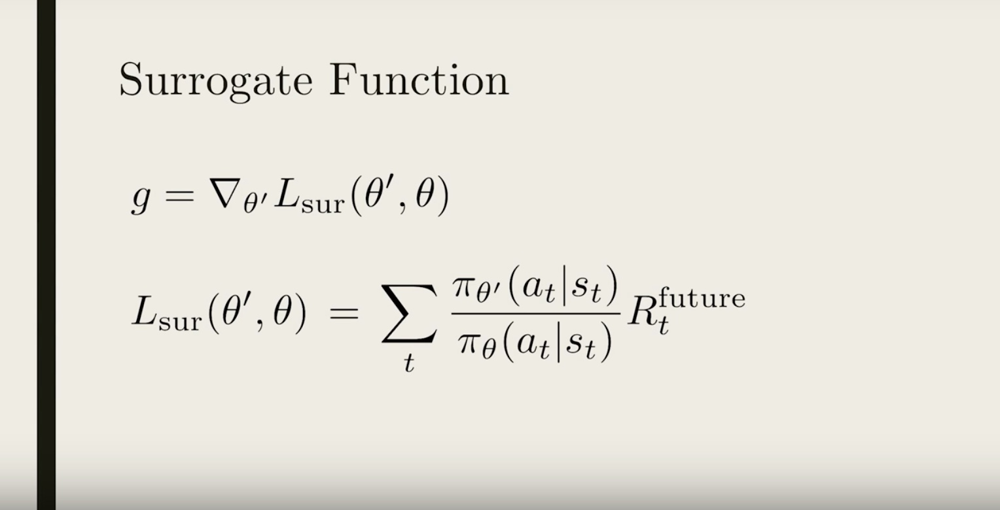

In [110]:
from IPython.display import Image
Image(filename='./images/3-3-5-11_ppo_surrogate_function_new_gradient.jpeg')

## * So using this new gradient, we can perform gradient ascent to update our policy -- which can be thought as directly maximize the surrogate function.

## * But there is still one important issue we haven’t addressed yet. If we keep reusing old trajectories and updating our policy, at some point the new policy might become different enough from the old one, so that all the approximations we made could become invalid.

## 3-3-6 : PPO Part 2: Clipping Policy Updates

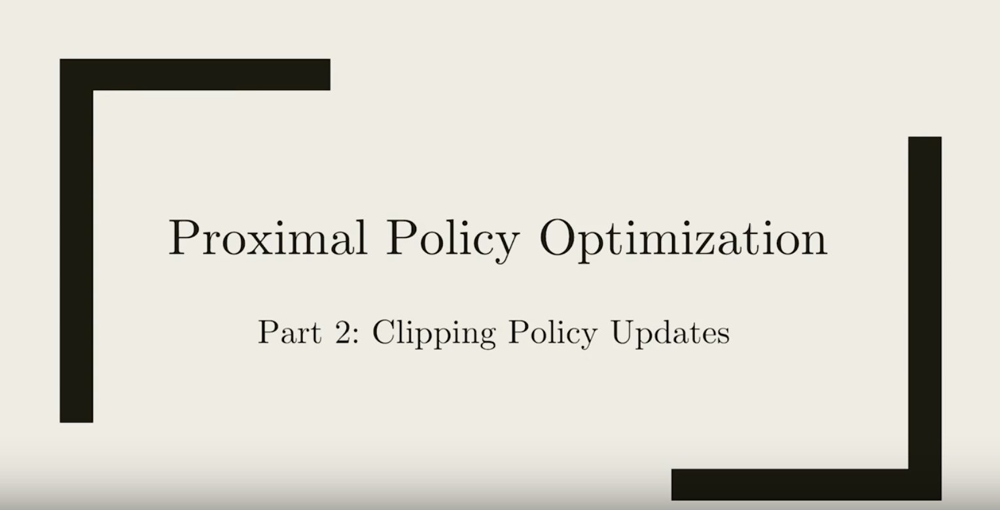

In [111]:
from IPython.display import Image
Image(filename='./images/3-3-6-1_ppo_clipping_policy_updates.jpeg')

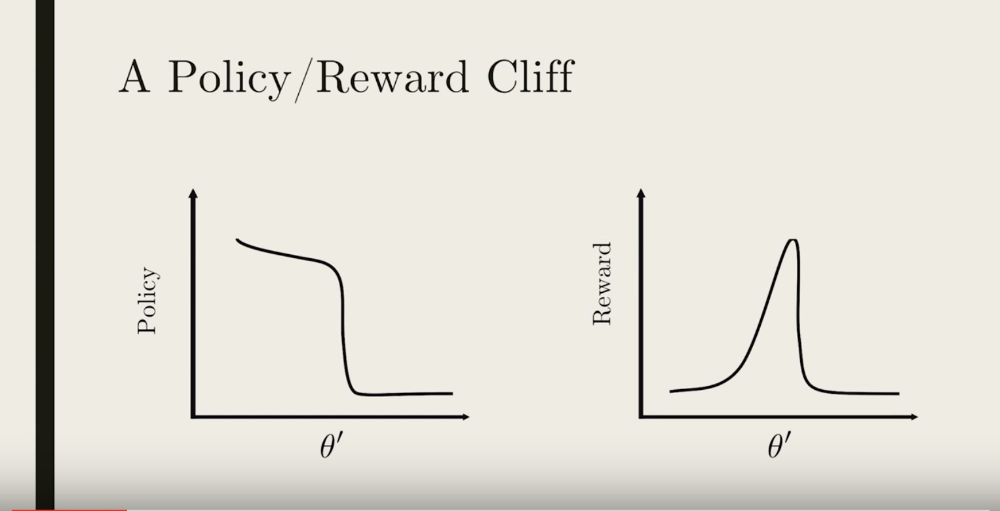

In [112]:
from IPython.display import Image
Image(filename='./images/3-3-6-2_ppo_the_policy_or_reward_off.jpeg')

## * What is the problem with updating our policy and ignoring the fact that the approximations are not valid anymore? One problem is it could lead to a really bad policy that is very hard to recover from. Let's see how~

## * Say we have some policy parameterized by πθ′(shown on the left plot in black), and with an average reward function (shown on the right plot in black).

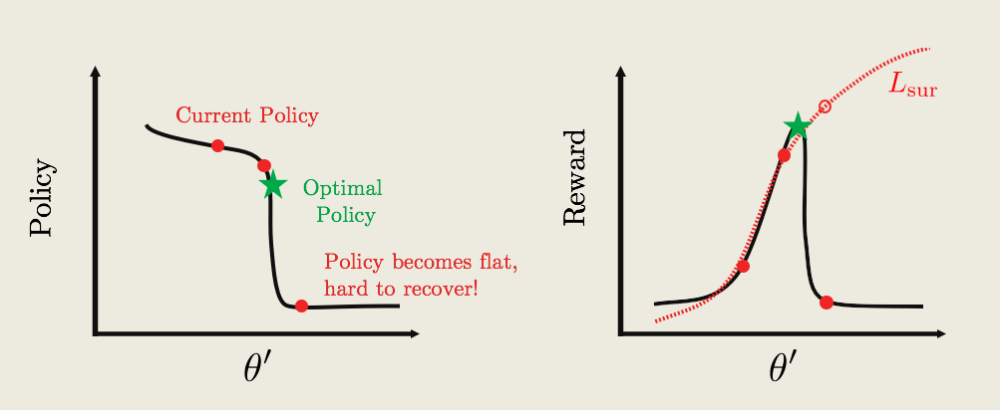

In [113]:
from IPython.display import Image
Image(filename='./images/3-3-6-3_ppo_Lsur_approximates_reward_well_around_the_current_policy_but_diverges_from_actual_reward.png')

## * The current policy is labelled by the red text, and the goal is to update the current policy to the optimal one (green star). 
## * To update the policy we can compute a surrogate function Lsur(dotted-red curve on right plot). So Lsur approximates the reward pretty well around the current policy. But far away from the current policy, it diverges from the actual reward.
## * If we continually update the policy by performing gradient ascent, we might get something like the red-dots. The big problem is that at some point we hit a cliff, where the policy changes by a large amount. From the perspective of the surrogate function, the average reward is really great. But the actually average reward is really bad!
## * What’s worse, the policy is now stuck in a deep and flat bottom, so that future updates won’t be able to bring the policy back up! we are now stuck with a really bad policy.

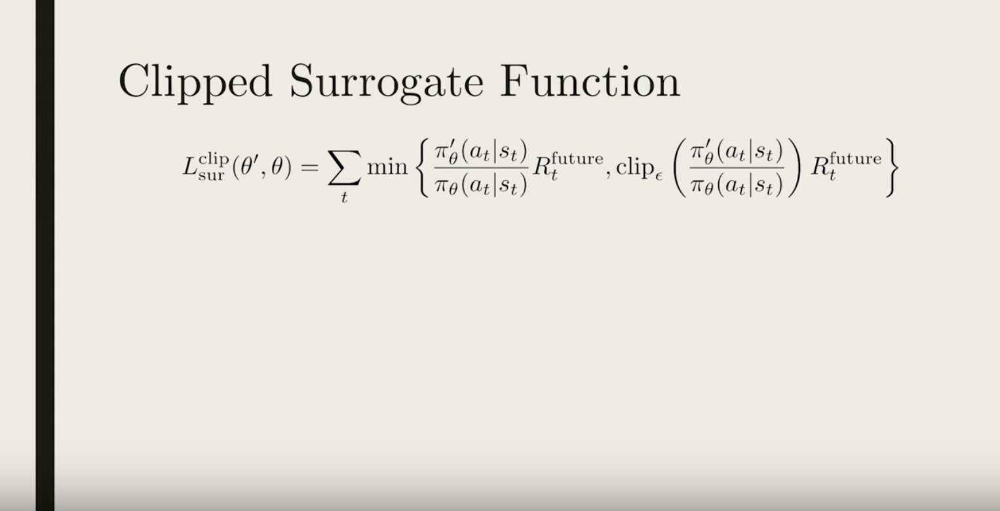

In [114]:
from IPython.display import Image
Image(filename='./images/3-3-6-4_ppo_clipped_surrogate_function.jpeg')

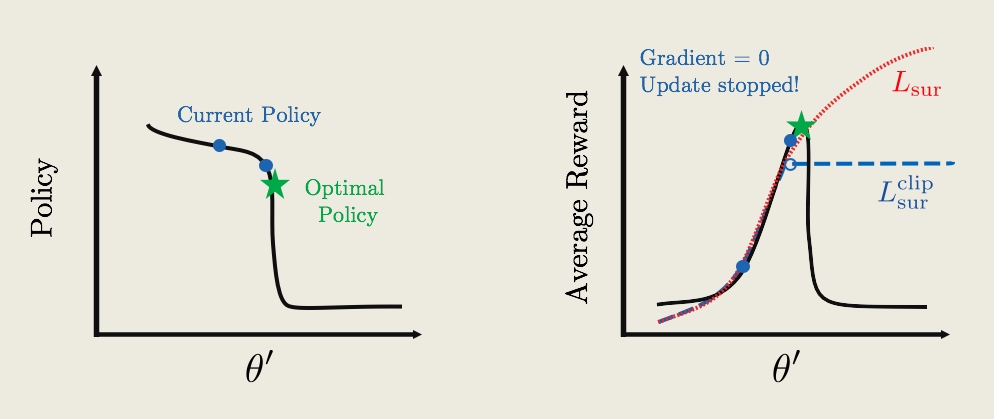

In [115]:
from IPython.display import Image
Image(filename='./images/3-3-6-5_ppo_clipped_surrogate_function_if_reward_function_is_zero_the_gradient_zero_policy_update_will_stop.png')

## * So starting with the current policy (blue dot), we apply gradient ascent. The updates remain the same, until we hit the flat plateau. Now because the reward function is flat, the gradient is zero, and the policy update will stop!

## * Now, keep in mind that we are only showing a 2D figure with one θ′ direction. In most cases, there are thousands of parameters in a policy, and there may be hundreds/thousands of high-dimensional cliffs in many different directions. We need to apply this clipping mathematically so that it will automatically take care of all the cliffs.

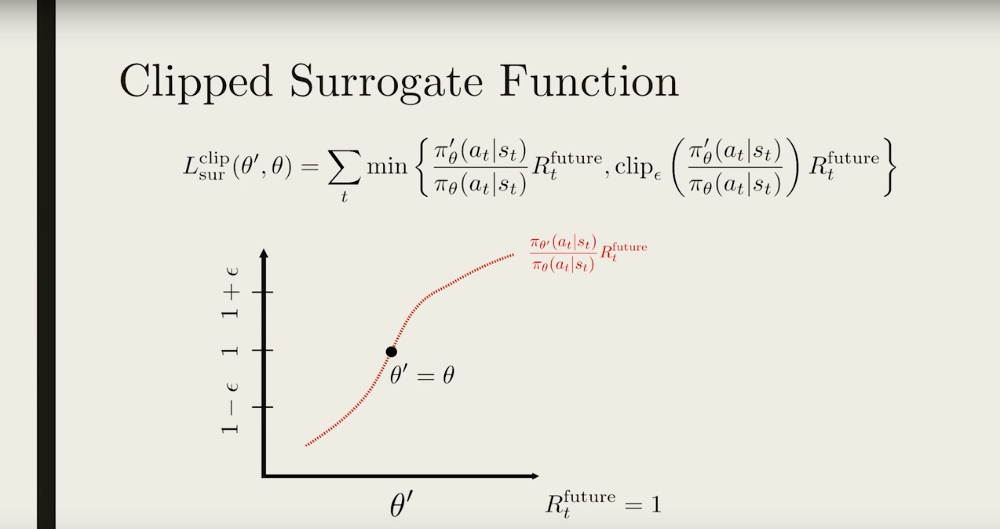

In [116]:
from IPython.display import Image
Image(filename='./images/3-3-6-6_ppo_clipped_surrogate_function_original surrogate function.jpeg')

## The black dot shows the location where the current policy is the same as the old policy (θ′=θ)

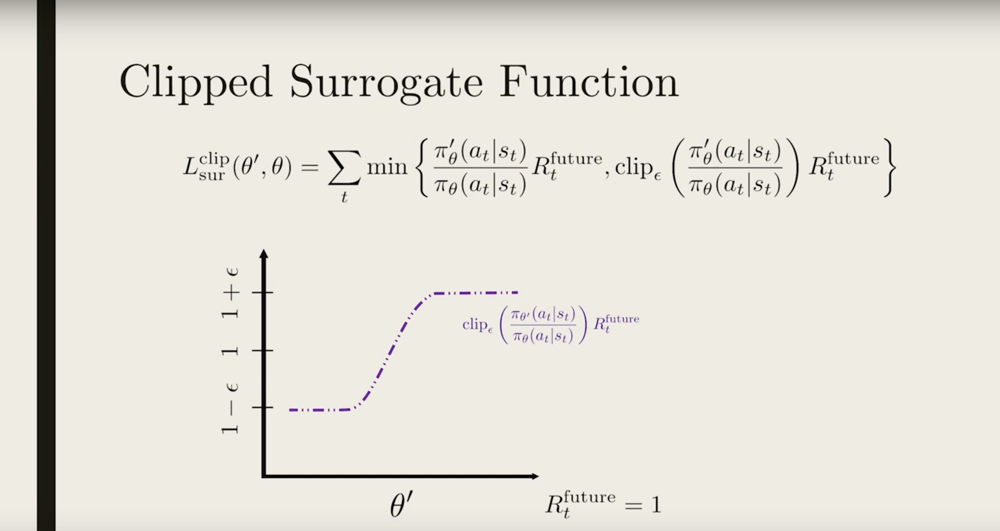

In [117]:
from IPython.display import Image
Image(filename='./images/3-3-6-7_ppo_clipped_surrogate_function_apply_the_clip_function_to_force_the_ratio_to_be_within_the_interval.jpeg')

## We want to make sure the two policy is similar, or that the ratio is close to 1. So we choose a small ϵ (typically 0.1 or 0.2), and apply the clip function to force the ratio to be within the interval [1−ϵ,1+ϵ] (shown in purple).

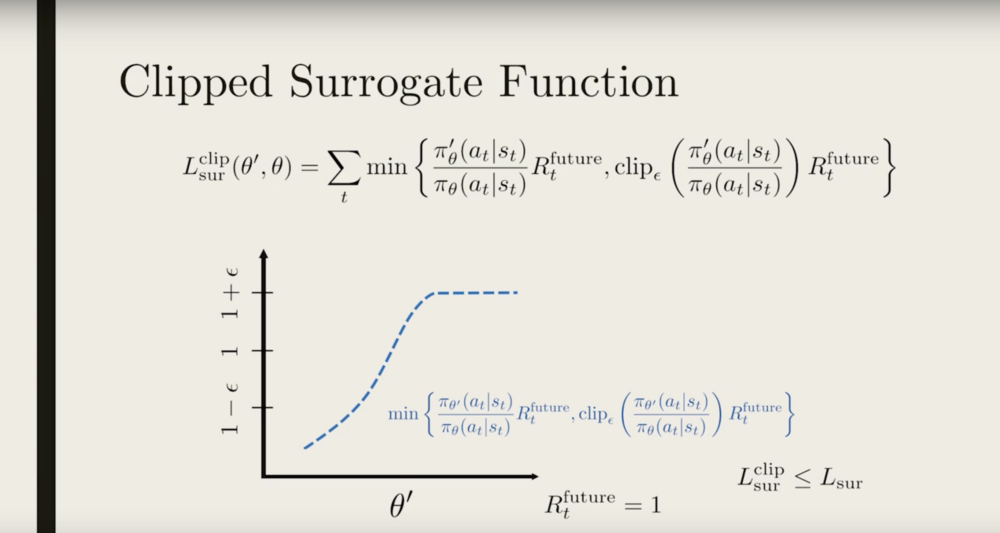

In [118]:
from IPython.display import Image
Image(filename='./images/3-3-6-8_ppo_clipped_surrogate_function_we_only_want_to_clip_the_top_part_and_not_the_bottom_part.jpeg')

## Now the ratio is clipped in two places. But we only want to clip the top part and not the bottom part. To do that, we compare this clipped ratio to the original one and take the minimum (show in blue).

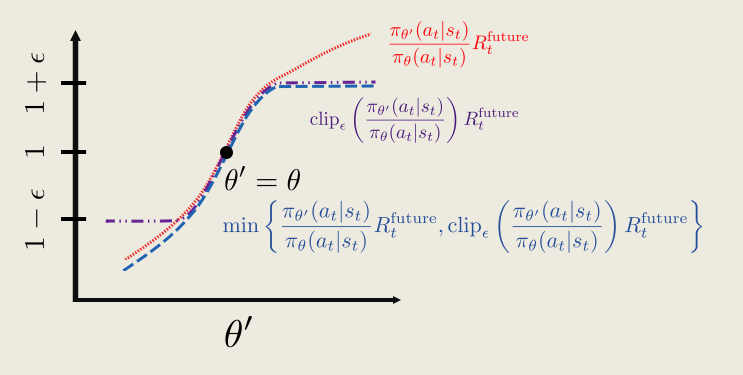

In [119]:
from IPython.display import Image
Image(filename='./images/3-3-6-9_ppo_clipped_surrogate_function_gives_us_more_conservative_reward.png')

## This then ensures the clipped surrogate function is always less than the original surrogate function Lsurclip ≤ Lsur, so the clipped surrogate function gives a more conservative "reward".

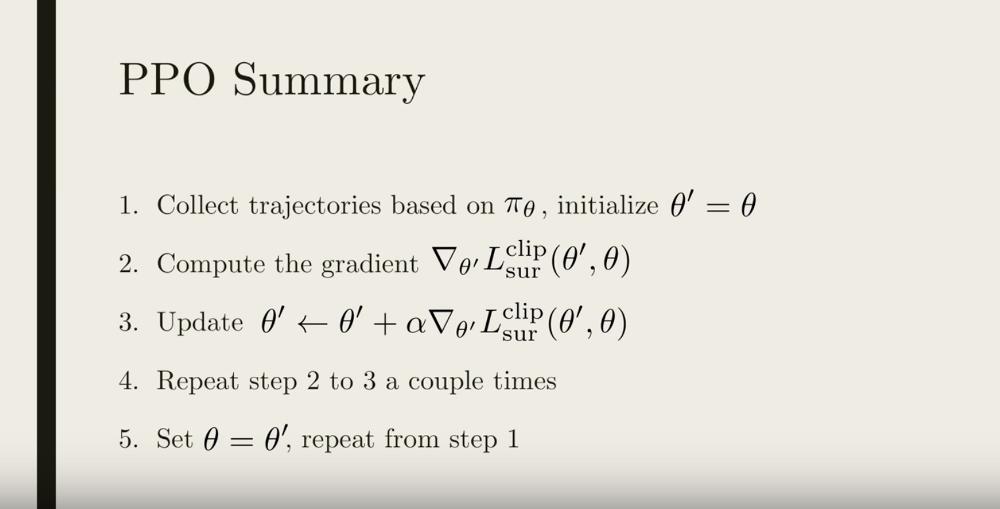

In [120]:
from IPython.display import Image
Image(filename='./images/3-3-6-10_ppo_summary.jpeg')

# The details of PPO was originally published by the team at OpenAI, and you can read their paper through this [link]{https://arxiv.org/abs/1707.06347}.

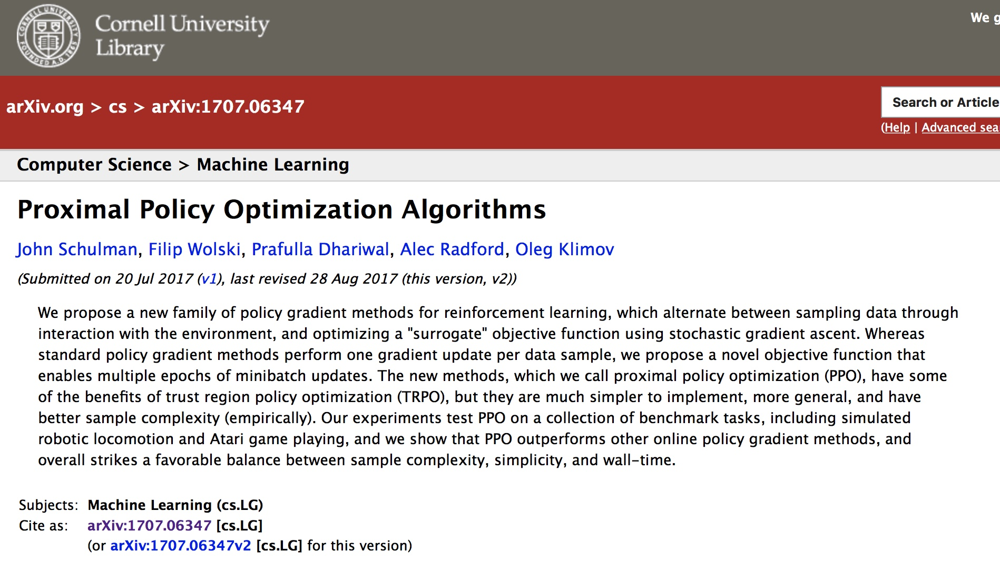

In [121]:
from IPython.display import Image
Image(filename='./images/3-3-6-11_ppo_paper.jpeg')